In [1]:
!which python

/c/Users/junec/AppData/Local/Programs/Python/Python38/python


In [2]:
import struct 
struct.calcsize("P")*8

32

In [3]:
# !pip list

In [4]:
# !pip install openpyxl

In [3]:
import numpy as np
import pandas as pd
import statistics
import matplotlib.pyplot as plt
from matplotlib import rcParams
from operator import itemgetter
from typing import Callable, Dict, List, Set, Tuple
from scipy.signal import savgol_filter

In [4]:
from util import load_data_from_txt, calculate_derivative,convert_timestamp2hour,produce_pressure_4metrics
from baseline import detect_breakpoints_startPoint, detect_breakpoints, detect_breakpoints_2, detect_breakpoints_3,detect_breakpoints_startPoint2
from plot import group_index, plot_breakpoints,plot_4_metrics,plot_4_metrics_details
from plot2 import group_index, plot_breakpoints,plot_4_metrics,plot_4_metrics_details,plot_detection_statistics,plot_histogram

In [6]:
#experiment setup
ground_truth=[]
colum_names ={"pressure":["Elapsed time","Data","first_order_derivative","second_order_derivative"],
                    "rate":["Elapsed time","Liquid rate"]}
pressure_file="../data_input/EAGE_Shchipanov_2017/Pressure.txt"
rate_file="../data_input/EAGE_Shchipanov_2017/Rate.txt"
# [[2248,2249,2252],  2467, [2804, 2805],[2875, 2876],[3095, 3100],3561,[3988, 3989, 3994],[4228, 4232],4753,4895, 5297,5436,[6544, 6543, 6546, 6547],7249,[7544, 7545],7946,[8361, 8362, 8364],9025,[9607, 9608],[10149, 10150],10216, 10528,[10801, 10804],11340, [11475, 11479, 11483],12363,[13039, 13040],13868,[14085, 14086],14438,14774

In [7]:
pressure_df,rate_df,pressure_rate=load_data_from_txt(pressure_file, rate_file)
pd.set_option('display.max_rows', rate_df.shape[0]+1)
rate_df

,Elapsed time,Liquid rate
0,0.433384,-3916.602731
1,2.516718,-3913.489043
2,4.600051,-3911.804387
3,6.641718,-3910.573563
4,7.683384,-3907.017652
5,7.766718,-5201.249122
6,7.850051,-5254.735475
7,7.933384,-5313.591676
8,8.016718,-5313.210532
9,8.100051,-5371.191920


In [83]:
pressure_df,rate_df,pressure_rate=load_data_from_txt(pressure_file, rate_file)
# display(pressure_df)
# display(rate_df)
# pressure_rate
pressure_rate_df = pd.concat([pressure_df, rate_df])
pressure_rate_df=pressure_rate_df.sort_values(by=['Elapsed time'])
print(pressure_df.shape[0],rate_df.shape[0],pressure_rate_df.shape[0])
pd.set_option('display.max_rows', pressure_rate_df.shape[0]+1)
pressure_rate_df

29813 10191 40004


,Elapsed time,Data,Liquid rate
0,0.000000,2988.99,NaN
0,0.433384,NaN,-3916.602731
1,0.495833,2991.28,NaN
2,0.516667,2994.32,NaN
3,0.545833,2996.70,NaN
4,0.566667,2999.12,NaN
5,0.600000,3001.73,NaN
6,0.629167,3003.85,NaN
7,0.662500,3006.60,NaN
8,0.695833,3008.86,NaN


In [79]:
# left=pressure_df.iloc[0:5]
# right=rate_df.iloc[0:5]
# result = pd.merge(left, right, how="outer", on=["Elapsed time"])
# display(left)
# display(right)
# display(result)
# b=result.sort_values(by=['Elapsed time'])
# result
# type(pressure_df.iloc[0]['Elapsed time'])
# pressure_df.iloc[1]['Elapsed time']>rate_df.iloc[0]['Elapsed time']
# b

In [78]:
pressure_rate_df = pd.concat([pressure_rate_df, pressure_rate_df])
pressure_rate_df=pressure_rate_df.sort_values(by=['Elapsed time'])
pressure_rate_df

,Elapsed time,Data,first_order_derivative,second_order_derivative,Liquid rate
0,0.000000,2989.186167,5.644146,255.067575,NaN
0,0.433384,NaN,NaN,NaN,-3916.602731
1,0.495833,2991.984723,132.115152,-1887.195136,NaN
2,0.516667,2994.737122,92.798586,1197.966129,NaN
3,0.545833,2997.443747,127.739264,-2364.117282,NaN
4,0.566667,3000.104982,78.486819,290.472694,NaN
1,2.516718,NaN,NaN,NaN,-3913.489043
2,4.600051,NaN,NaN,NaN,-3911.804387
3,6.641718,NaN,NaN,NaN,-3910.573563
4,7.683384,NaN,NaN,NaN,-3907.017652


In [9]:
#calculate first & second derivative
pressure_df=produce_pressure_4metrics(pressure_df,colum_names)
display(pressure_df)

,Elapsed time,Data,first_order_derivative,second_order_derivative
0,0.000000,2988.99,4.618487,284.977831
1,0.495833,2991.28,145.919995,-3087.359588
2,0.516667,2994.32,81.600002,1184.914121
3,0.545833,2996.70,116.159996,-1817.279726
4,0.566667,2999.12,78.300001,-168.428622
...,...,...,...,...
29808,4063.495571,7938.65,0.439085,0.126970
29809,4065.499737,7939.53,0.693555,-0.271368
29810,4067.503904,7940.92,0.149688,-0.123142
29811,4069.508071,7941.22,-0.097110,0.000000


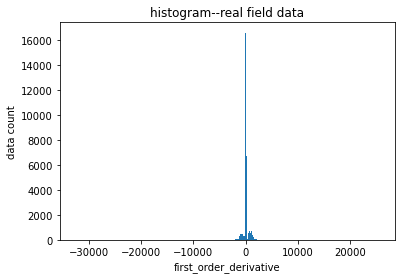

In [10]:
#plot histogram
data=pressure_df["first_order_derivative"]
xlabel="first_order_derivative"
ylabel="data count"
title='histogram--real field data'
plot_histogram(data, xlabel, ylabel,title)

In [11]:
first_order_derivative=pressure_df["first_order_derivative"]
second_order_derivative=pressure_df["second_order_derivative"]
breakpoints_detected=detect_breakpoints(first_order_derivative)
print(len(breakpoints_detected))
print(breakpoints_detected)

993.2336512455328
39
[66, 174, 241, 268, 292, 301, 2248, 2576, 2804, 2875, 3095, 3988, 4762, 5524, 6546, 7544, 8361, 10150, 11340, 11483, 13039, 13053, 14085, 16571, 16585, 16764, 17473, 17589, 18436, 18820, 18823, 18826, 18849, 21974, 24132, 24215, 24263, 27962, 28290]


In [12]:
breakpoints_detected=detect_breakpoints_2(first_order_derivative,second_order_derivative)
print(len(breakpoints_detected))
# print(breakpoints_detected)

993.2336512455328 192914.8008199997
53


In [13]:
plot_detection_statistics(breakpoints_detected,ground_truth)

findfont: Font family ['Arial Black'] not found. Falling back to DejaVu Sans.


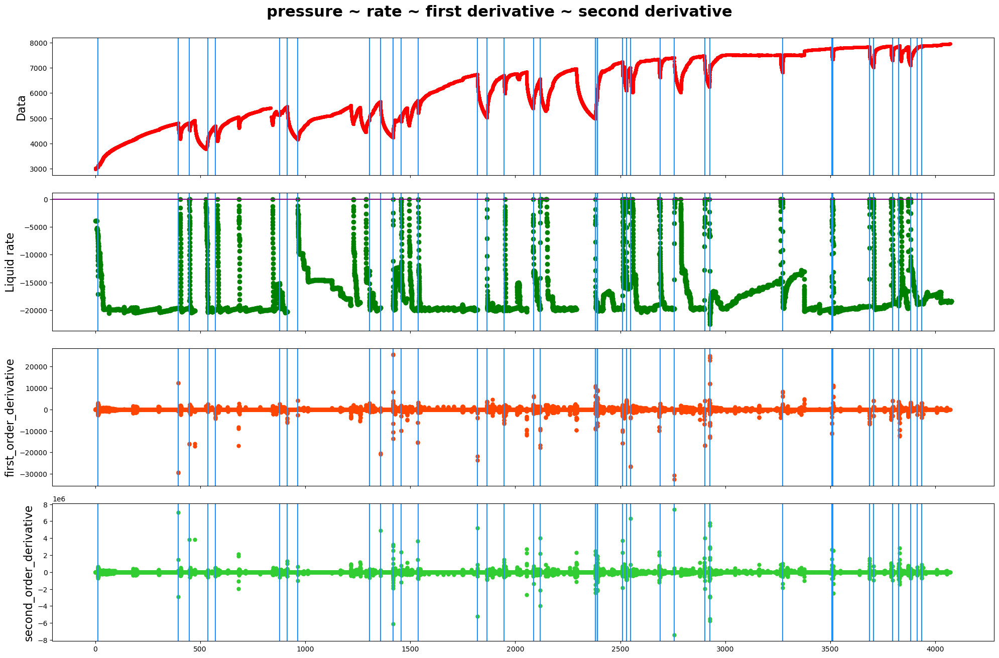

In [14]:
plot_4_metrics(pressure_df,
               rate_df,
               breakpoints_detected,
               ground_truth,
               colum_names)

In [15]:
noise_threshold=2
breakpoints_detected_3=detect_breakpoints_3(first_order_derivative,second_order_derivative,noise_threshold)
print(len(breakpoints_detected_3))
# print(breakpoints_detected)

993.2336512455328 192914.8008199997
116


In [16]:
plot_detection_statistics(breakpoints_detected_3,ground_truth)

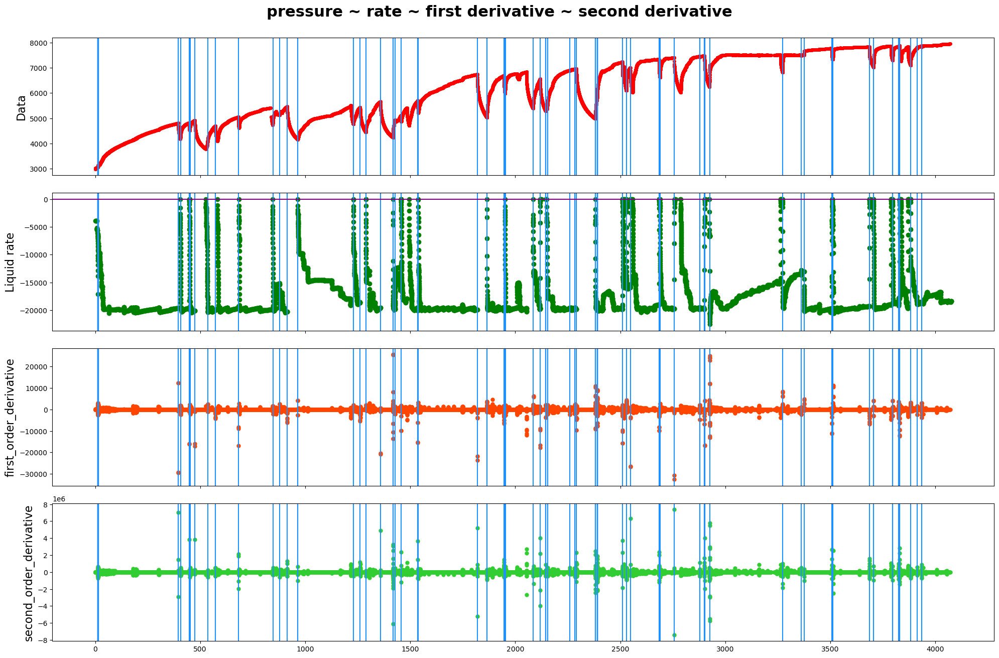

In [17]:
plot_4_metrics(pressure_df,
               rate_df,
               breakpoints_detected_3,
               ground_truth,
               colum_names)

detected 116 points as breakpoints
The plot is devided into 43 rows
------row 1-----detected points:[66, 67, 157, 172, 174, 175, 236, 241, 268, 269, 278, 292, 293, 301, 302]


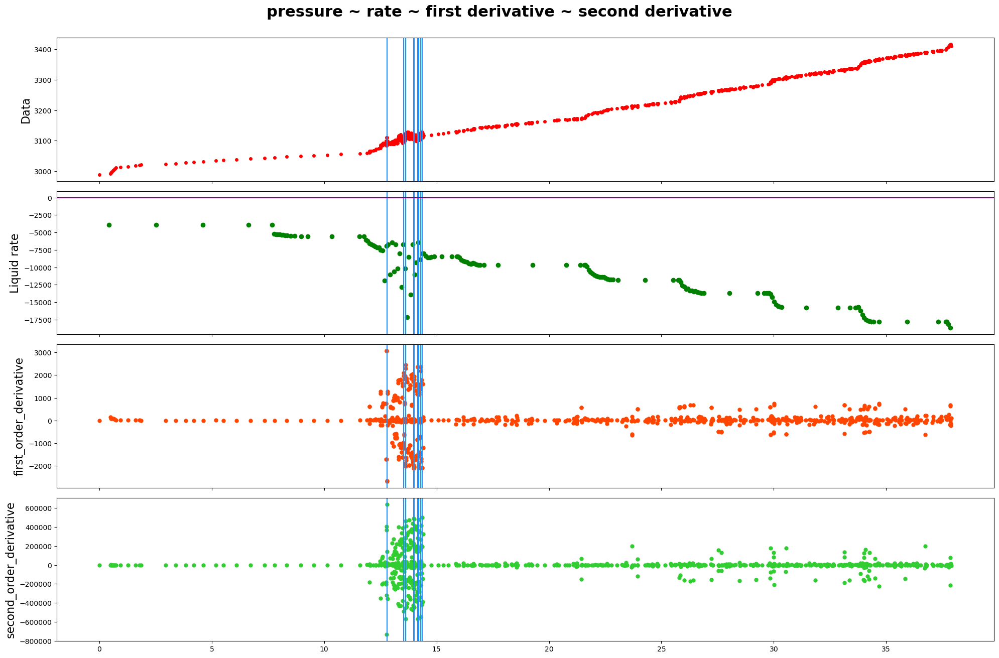

------row 2-----detected points:[]


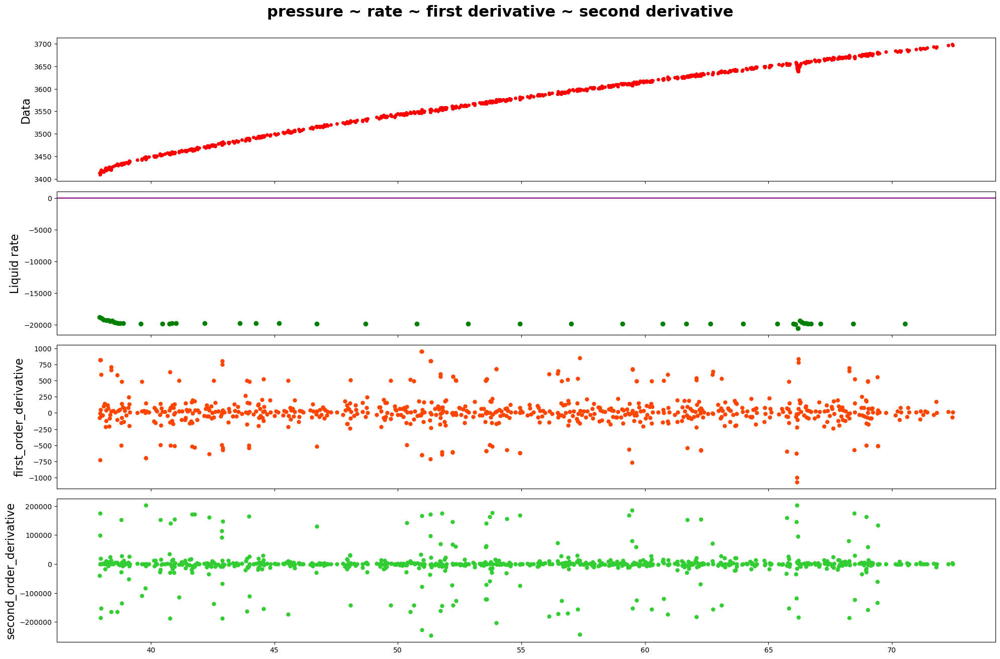

------row 3-----detected points:[]


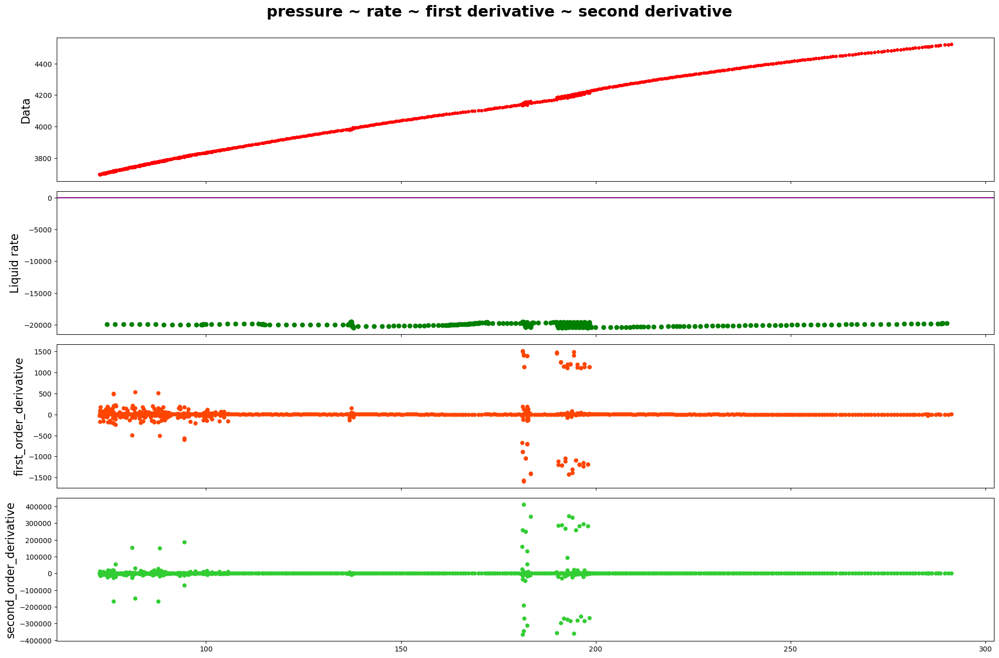

------row 4-----detected points:[2248, 2252, 2576, 2577]


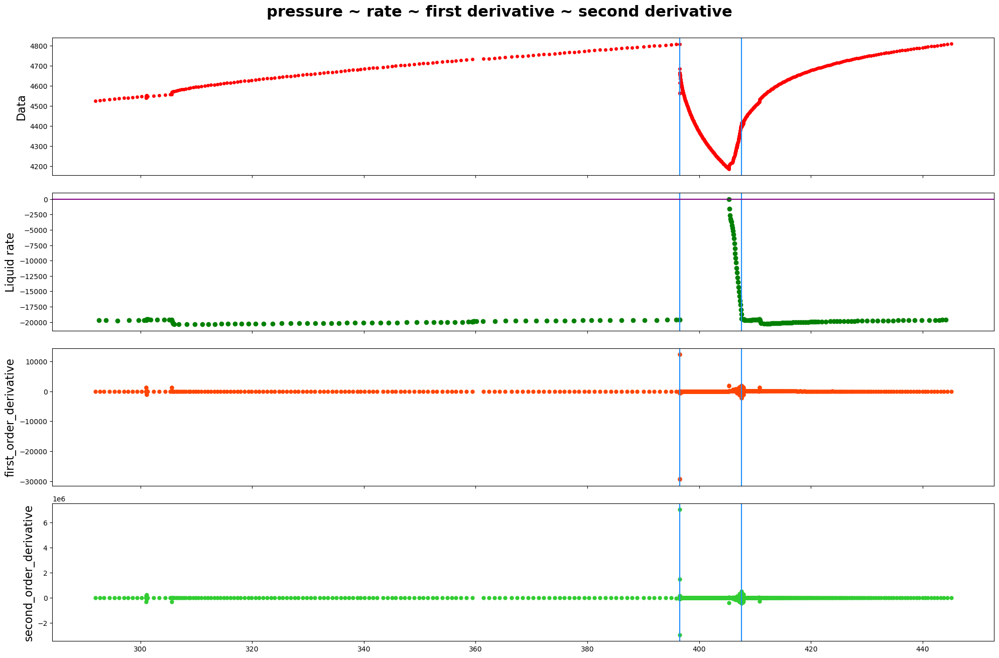

------row 5-----detected points:[2804, 2875, 2876, 2948, 3095]


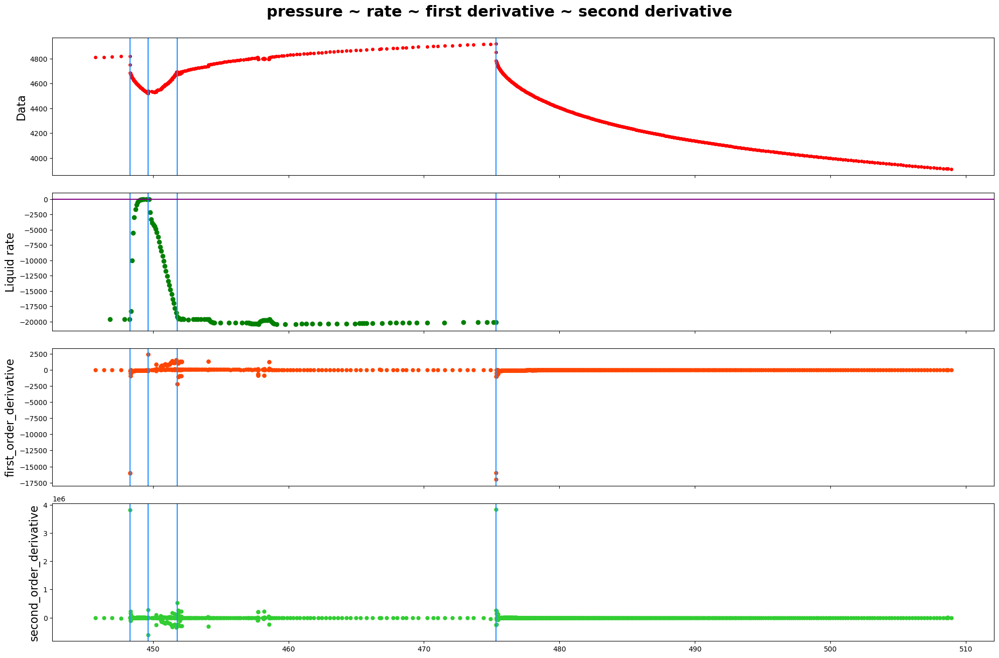

------row 6-----detected points:[3694, 3988, 3989]


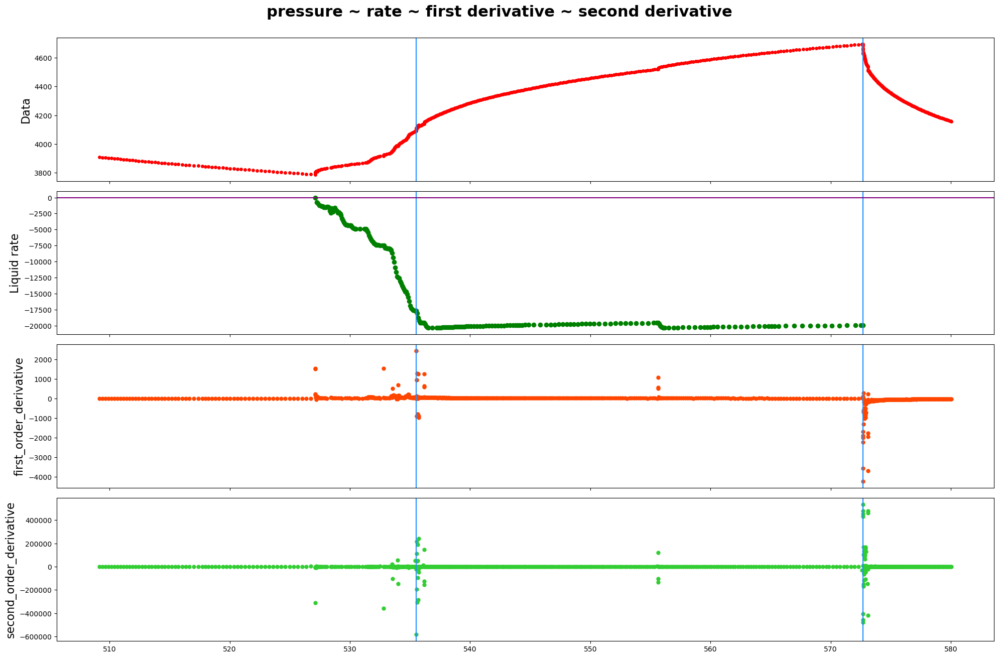

------row 7-----detected points:[4762]


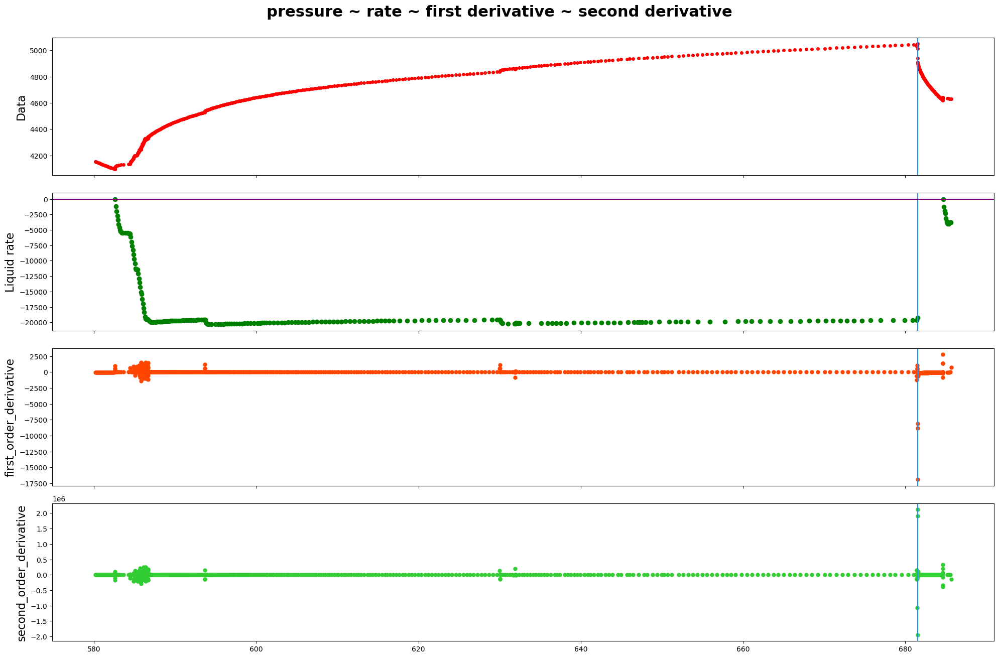

------row 8-----detected points:[5524]


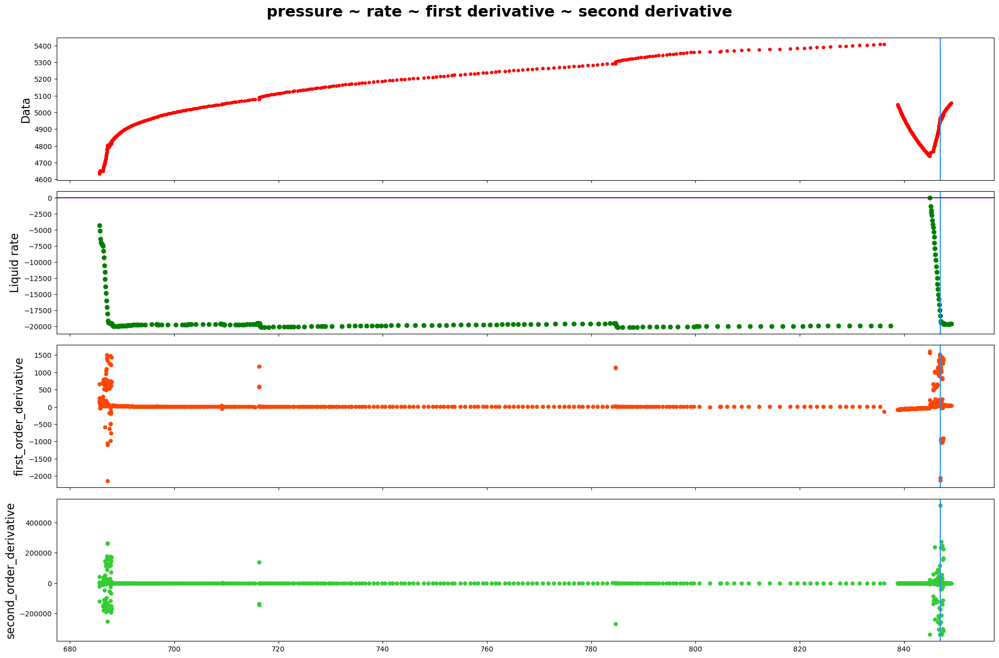

------row 9-----detected points:[5771, 5986]


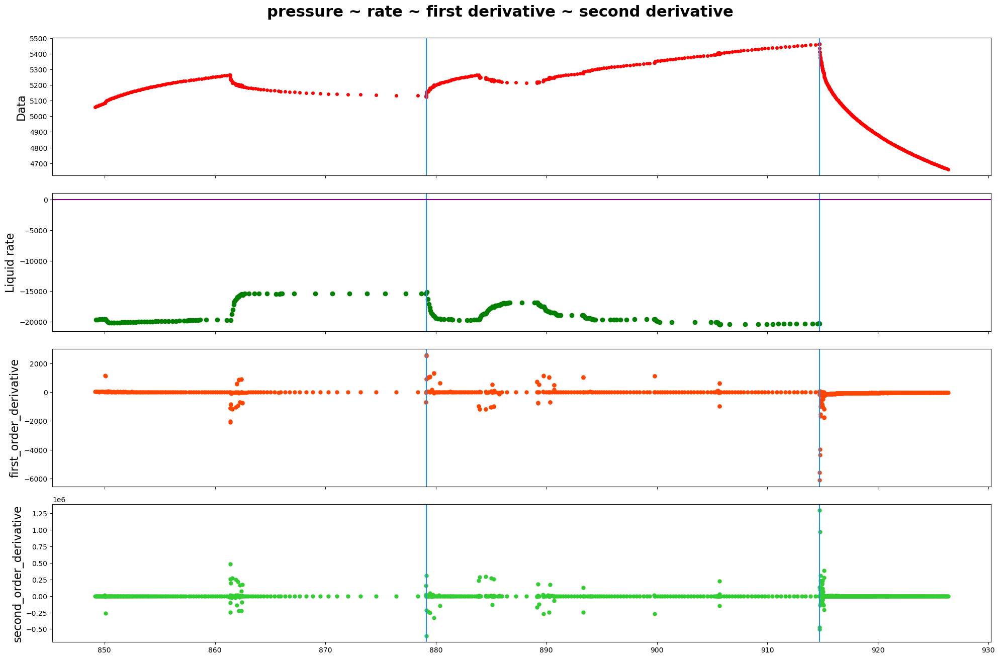

------row 10-----detected points:[6544, 6546, 6547]


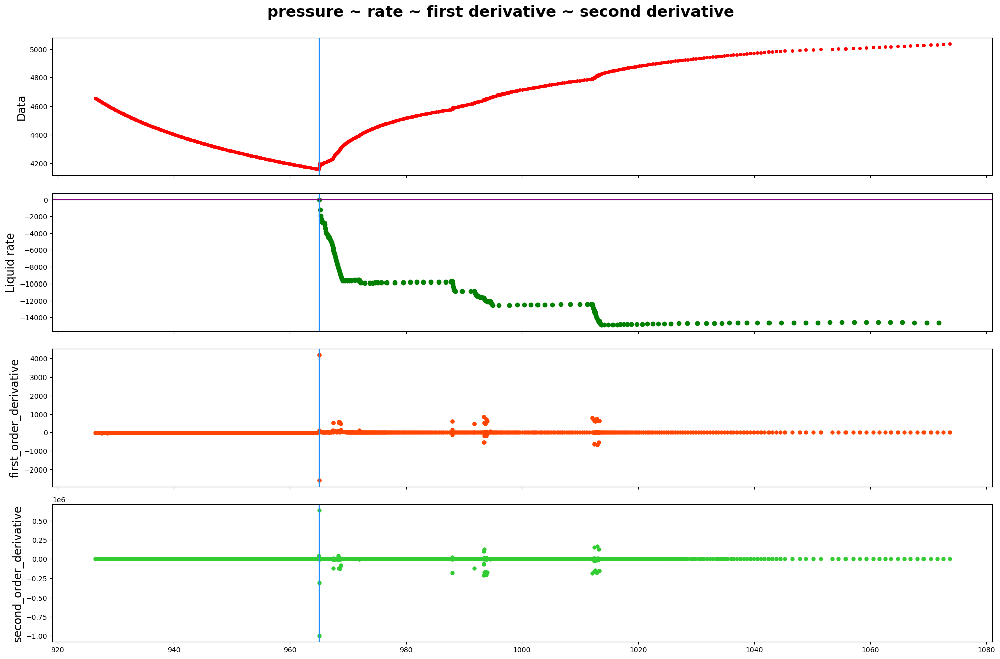

------row 11-----detected points:[7544, 7545]


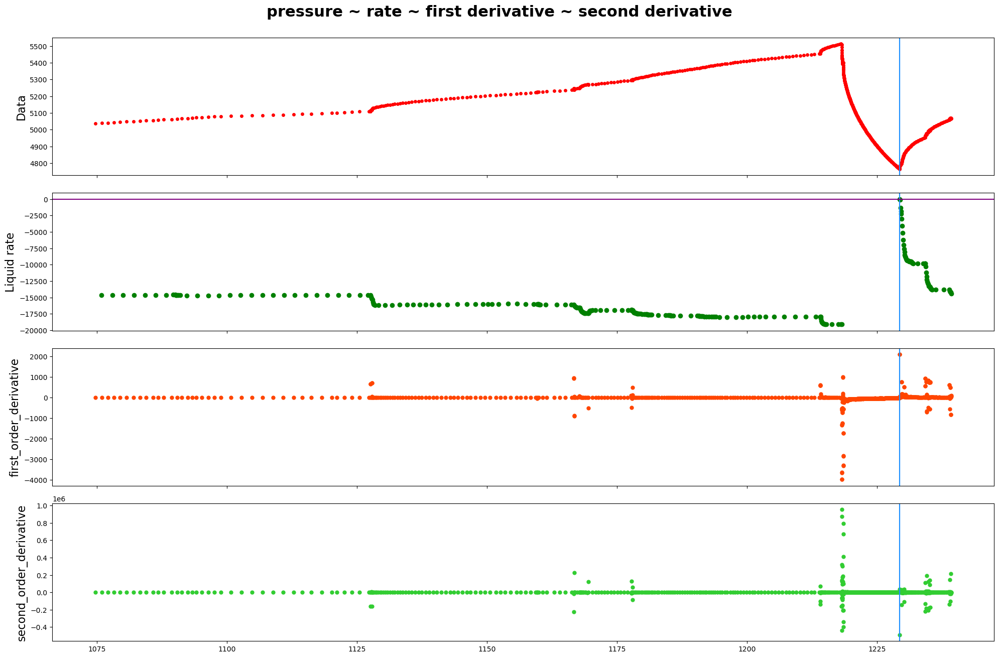

------row 12-----detected points:[7946, 8361, 8362]


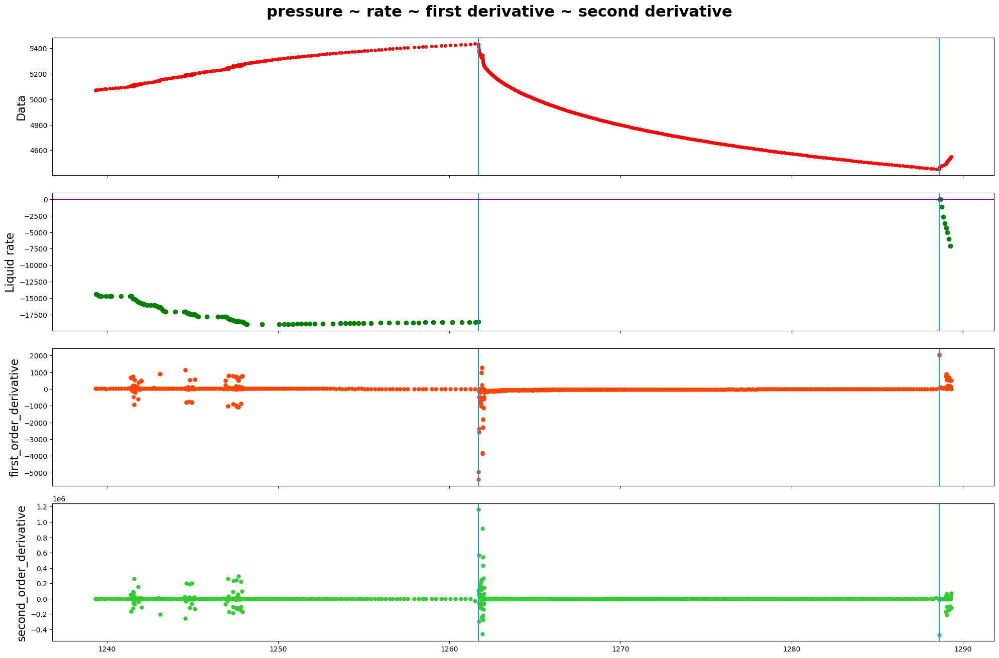

------row 13-----detected points:[9025]


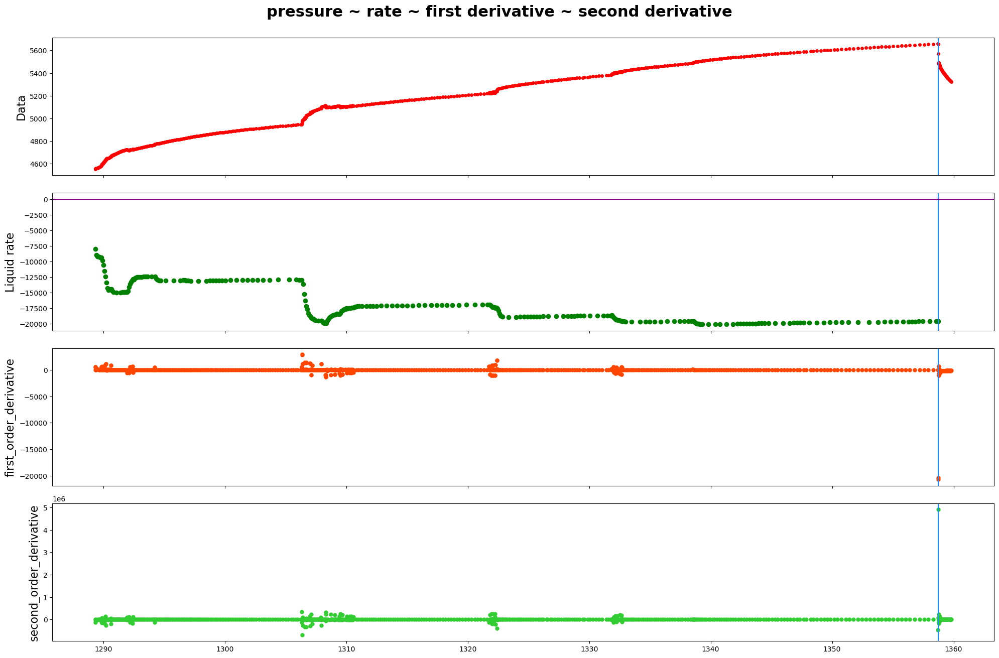

------row 14-----detected points:[9620, 9629, 9638]


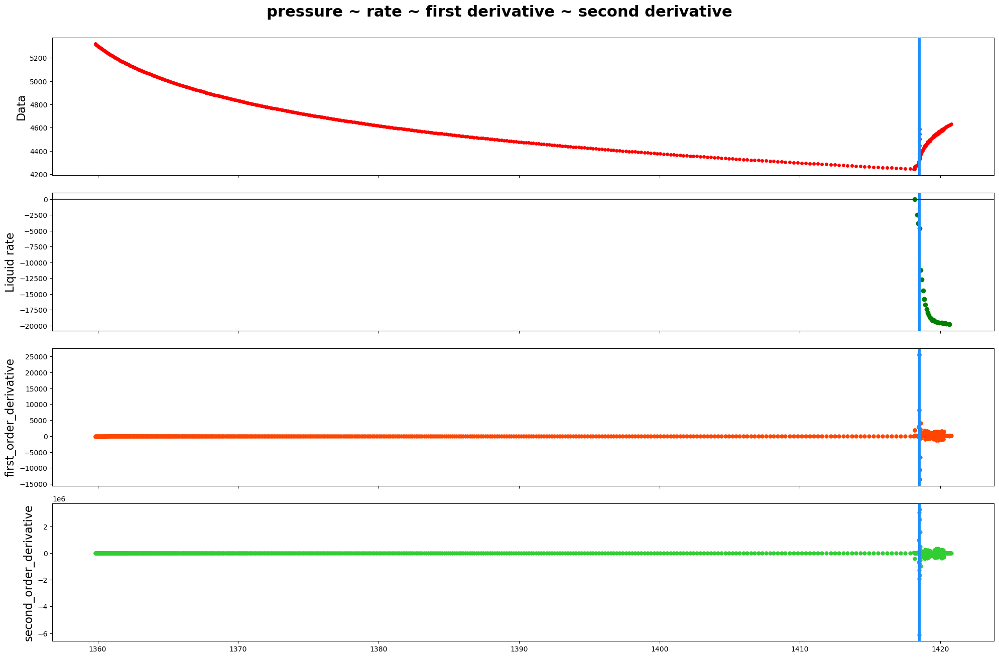

------row 15-----detected points:[9961, 10150]


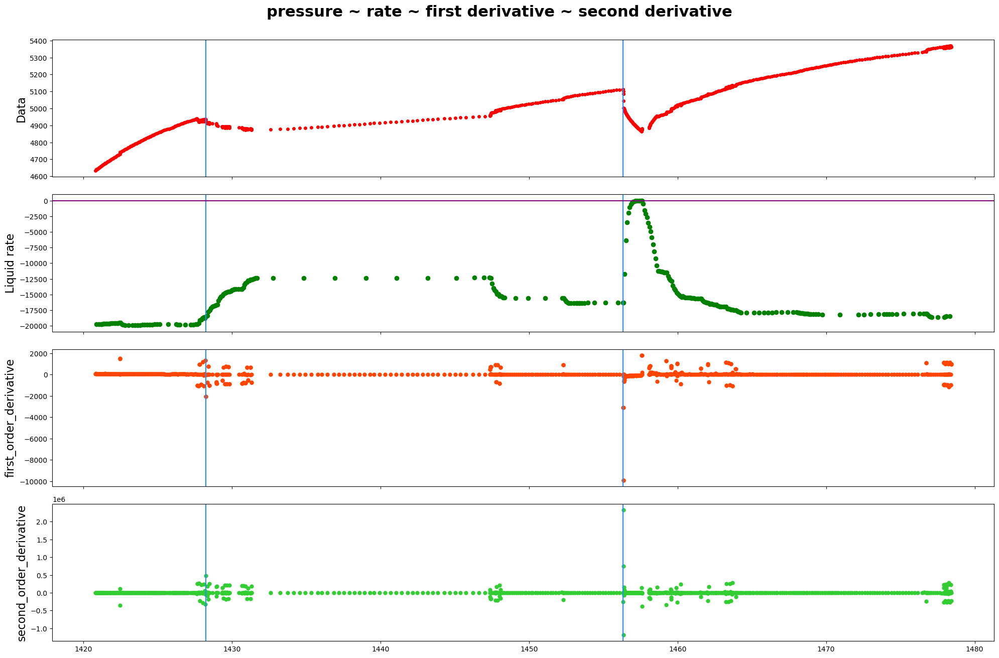

------row 16-----detected points:[]


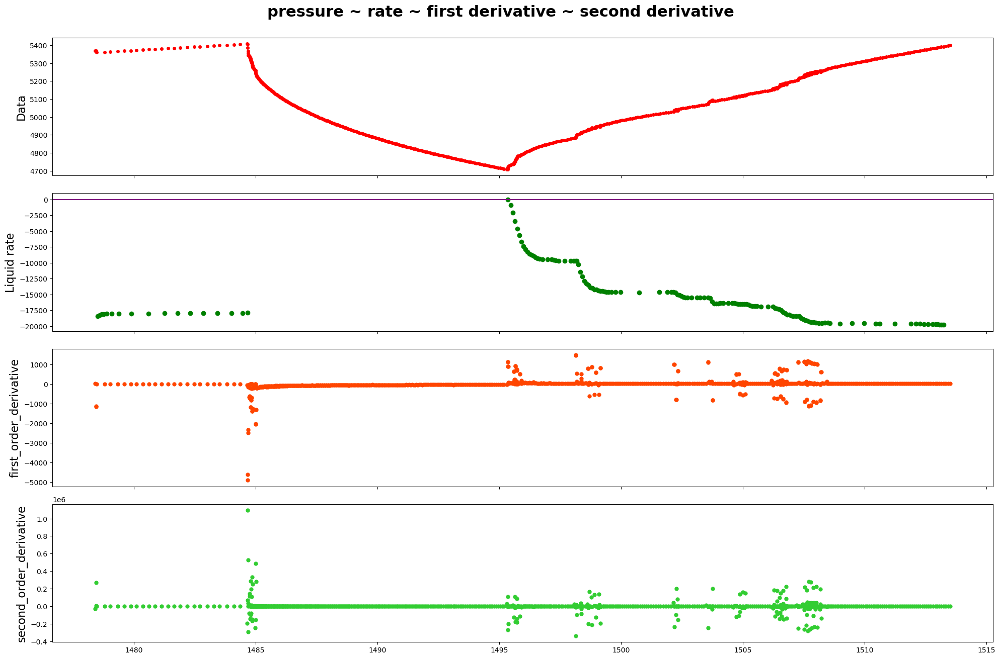

------row 17-----detected points:[11340, 11475, 11483]


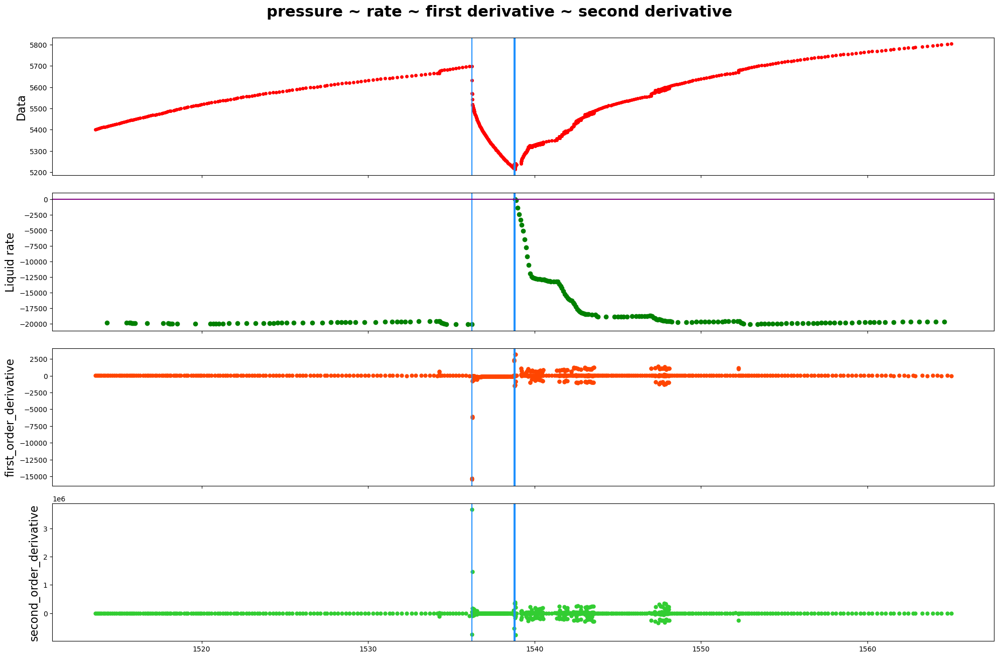

------row 18-----detected points:[12363]


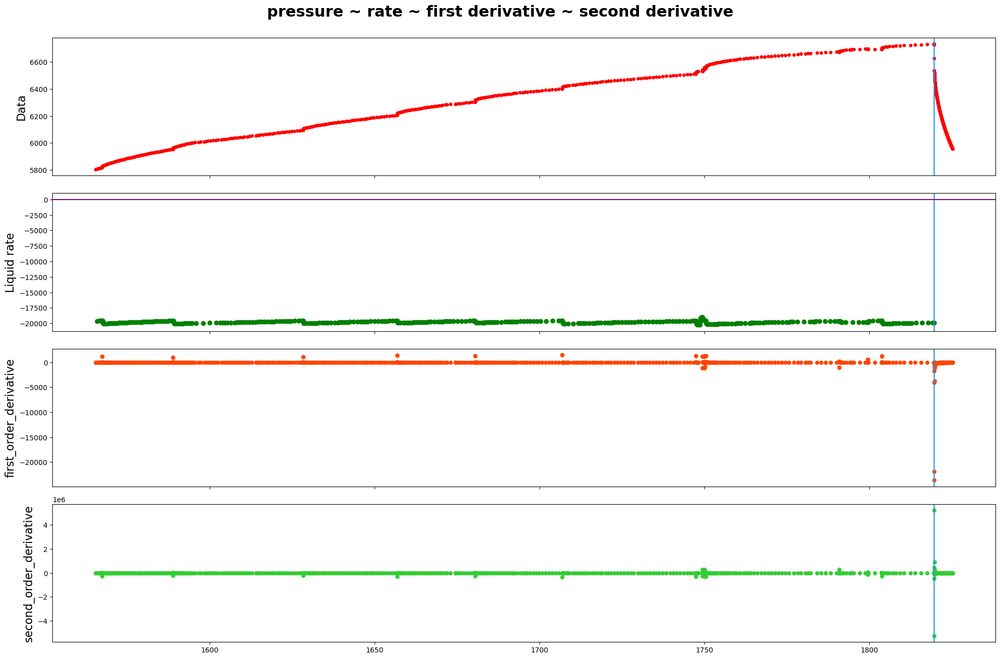

------row 19-----detected points:[13039, 13040, 13053]


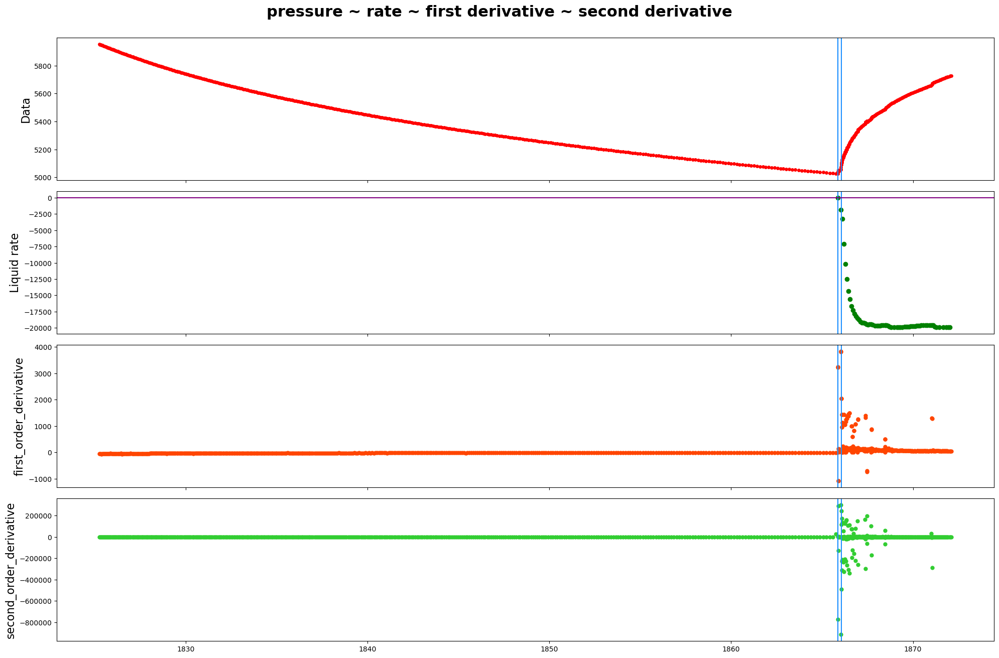

------row 20-----detected points:[13868]


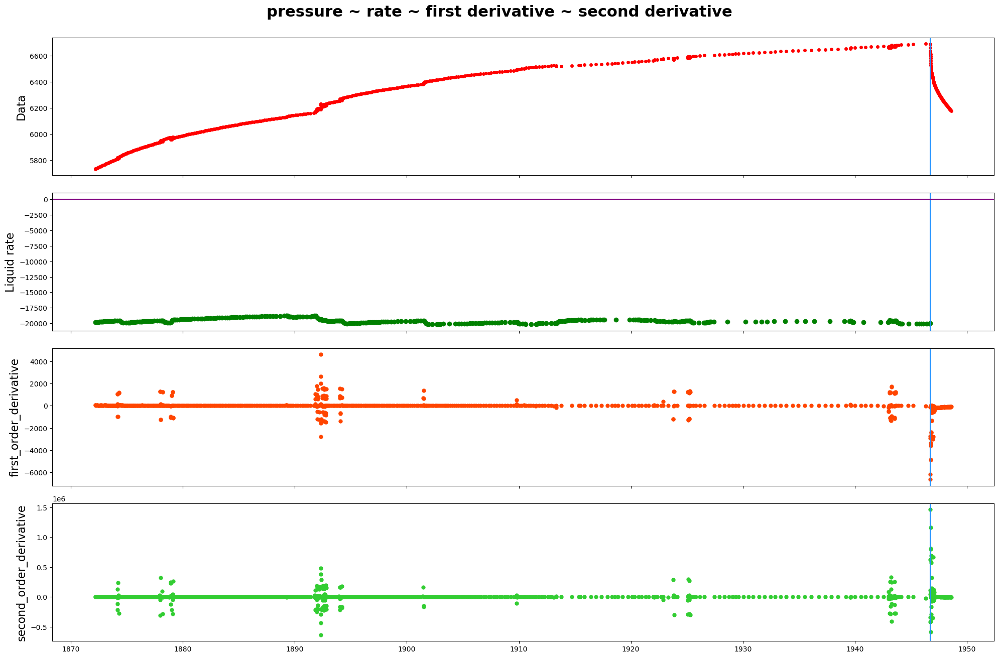

------row 21-----detected points:[14085, 14086, 14191]


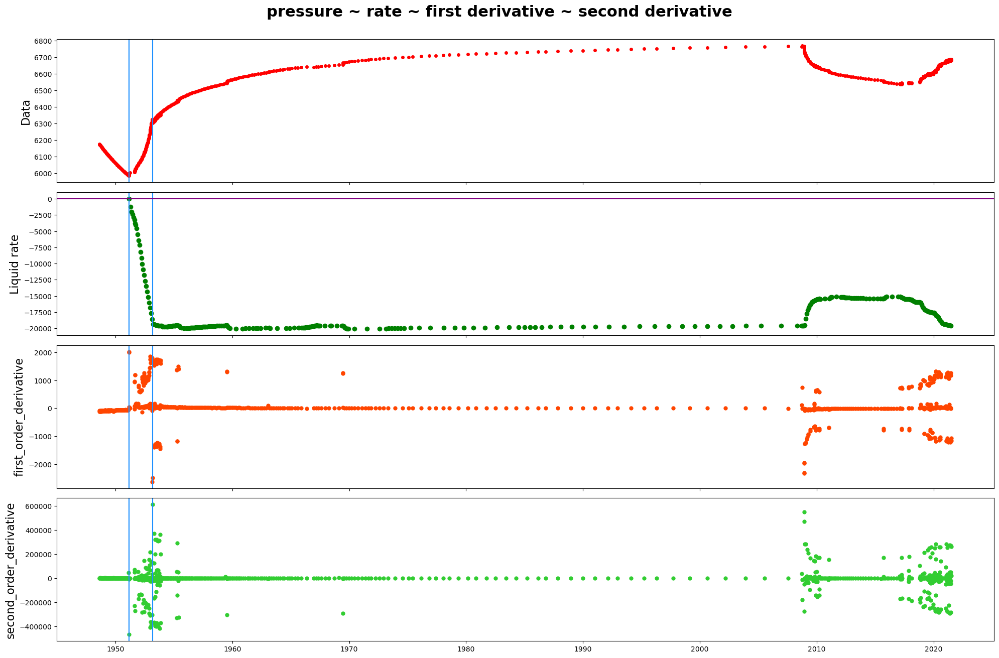

------row 22-----detected points:[15335]


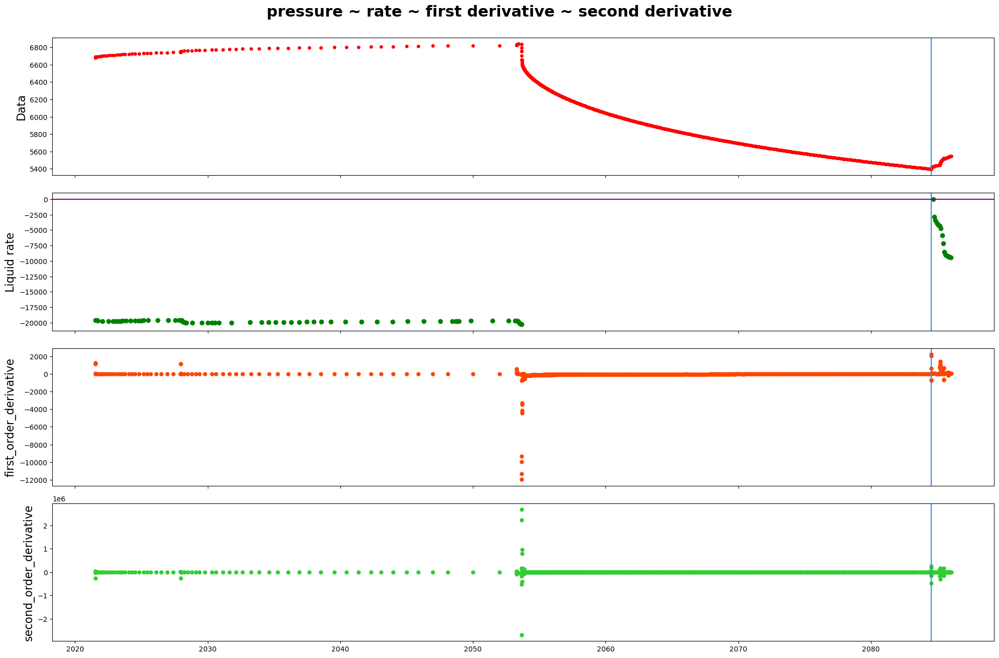

------row 23-----detected points:[16098]


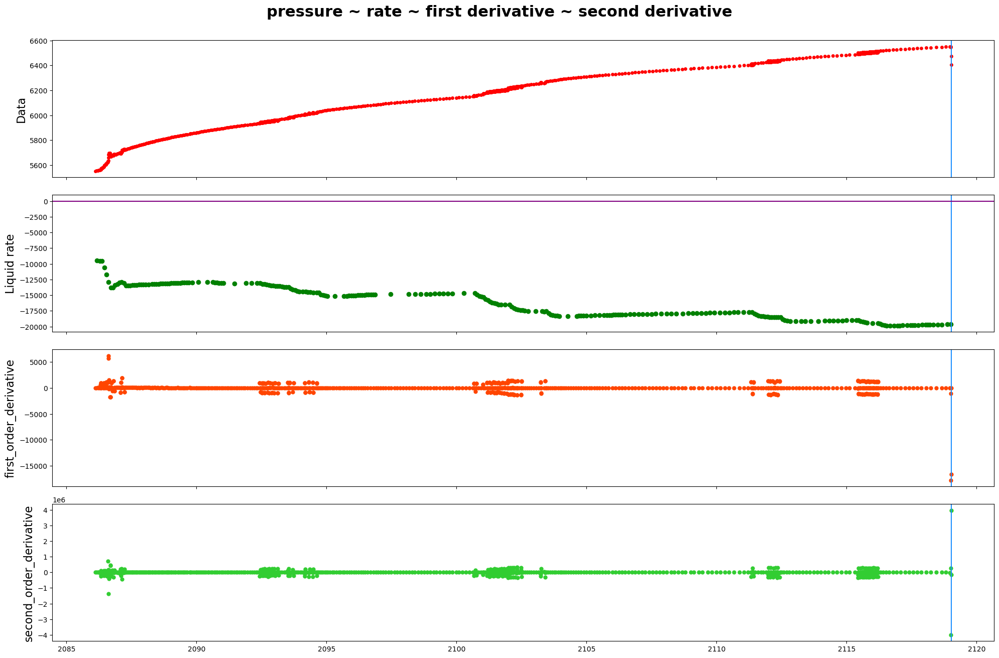

------row 24-----detected points:[16571, 16572, 16585, 16586, 16594, 16764, 16765]


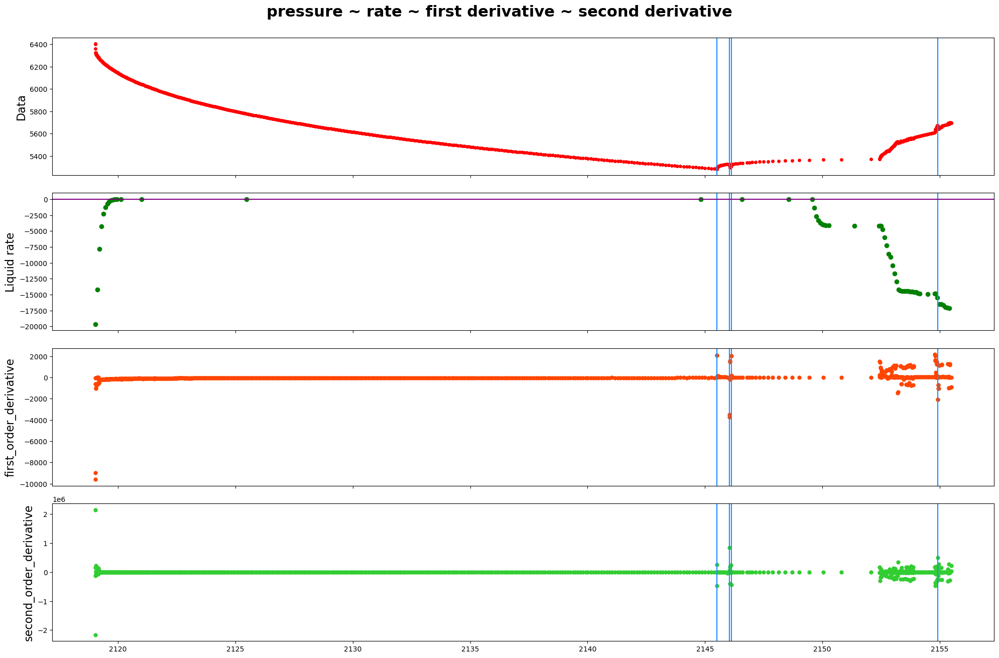

------row 25-----detected points:[17473]


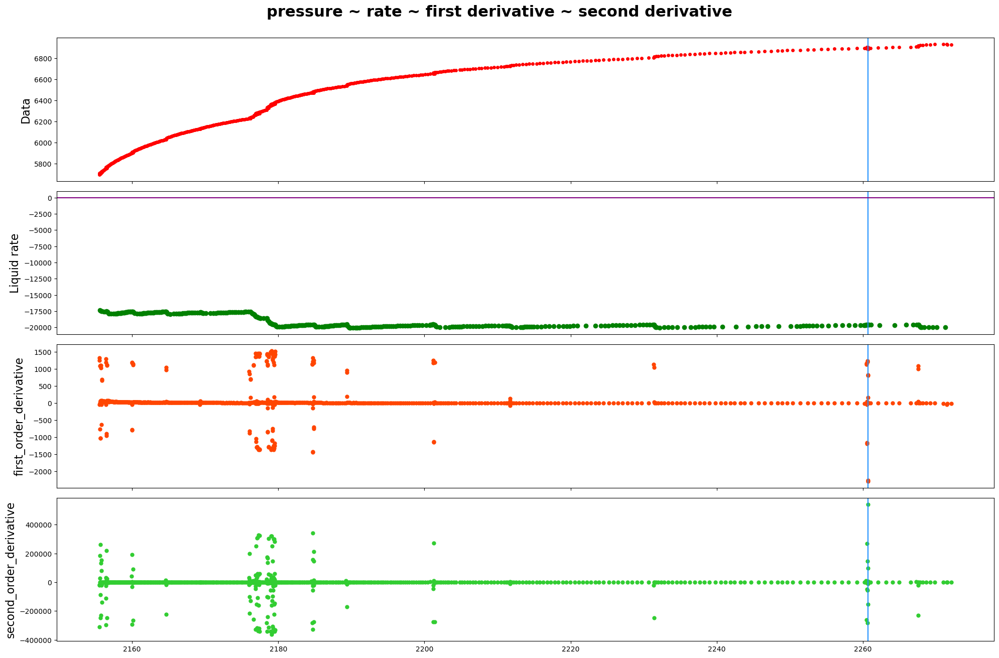

------row 26-----detected points:[17561, 17589, 17590]


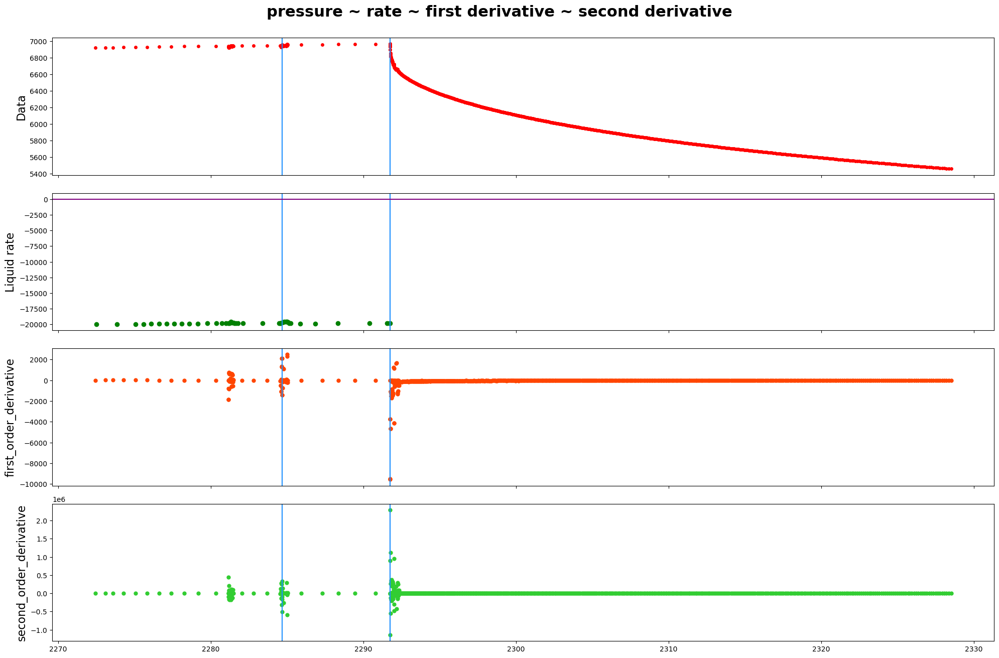

------row 27-----detected points:[18436, 18437, 18468, 18815, 18820, 18821, 18823, 18824, 18826, 18827, 18830, 18836, 18847, 18849]


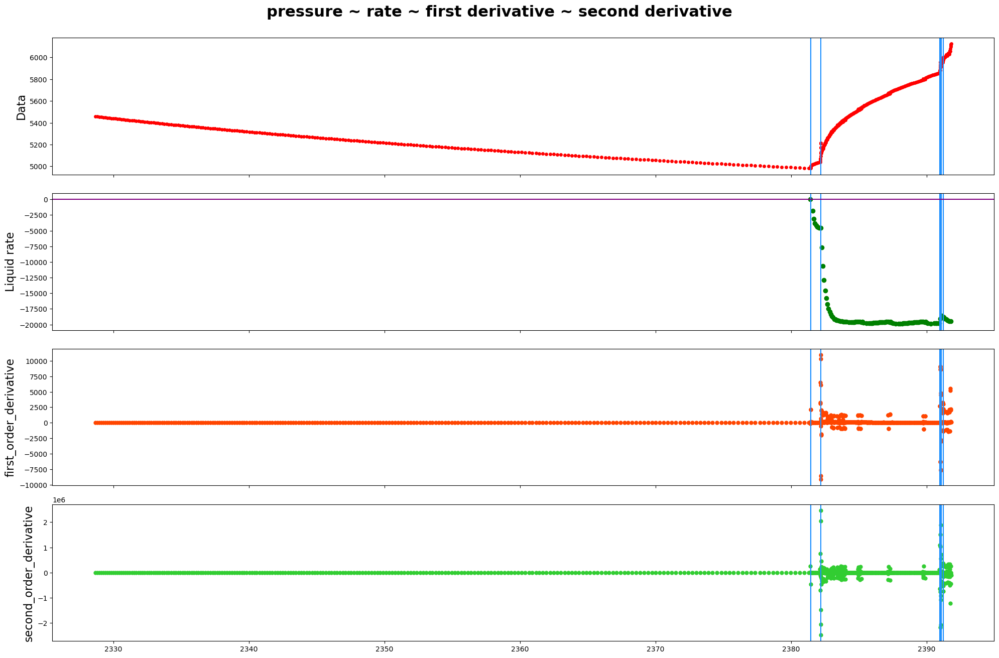

------row 28-----detected points:[]


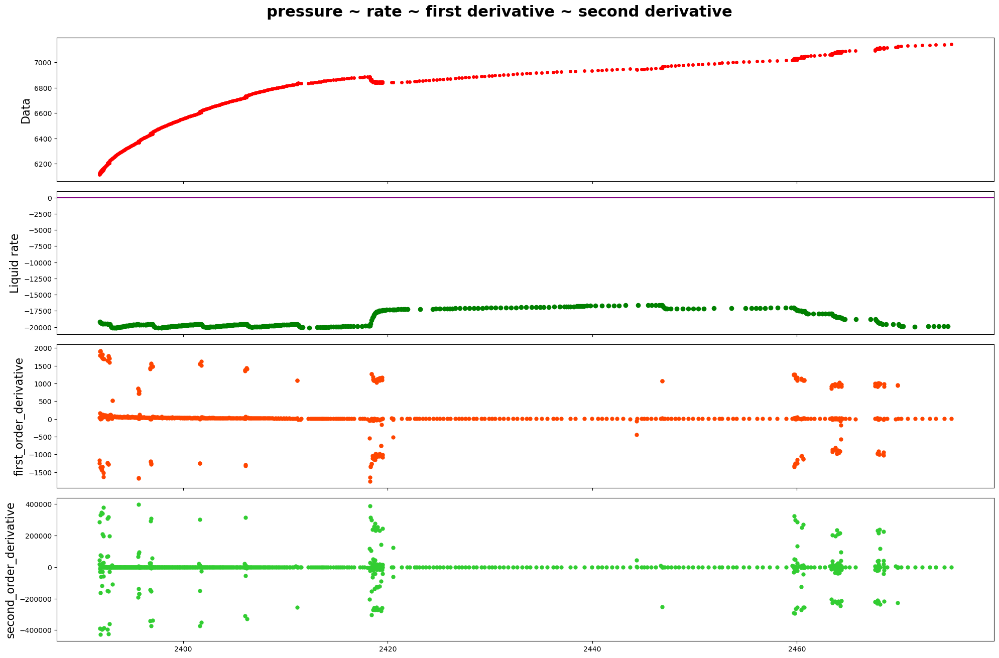

------row 29-----detected points:[19643]


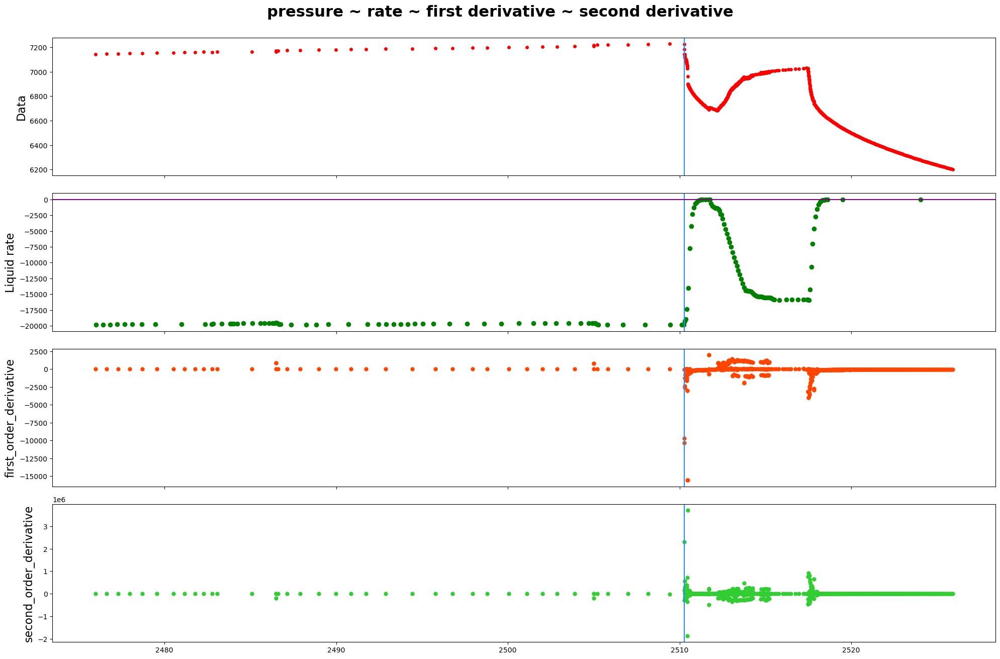

------row 30-----detected points:[20362, 20701]


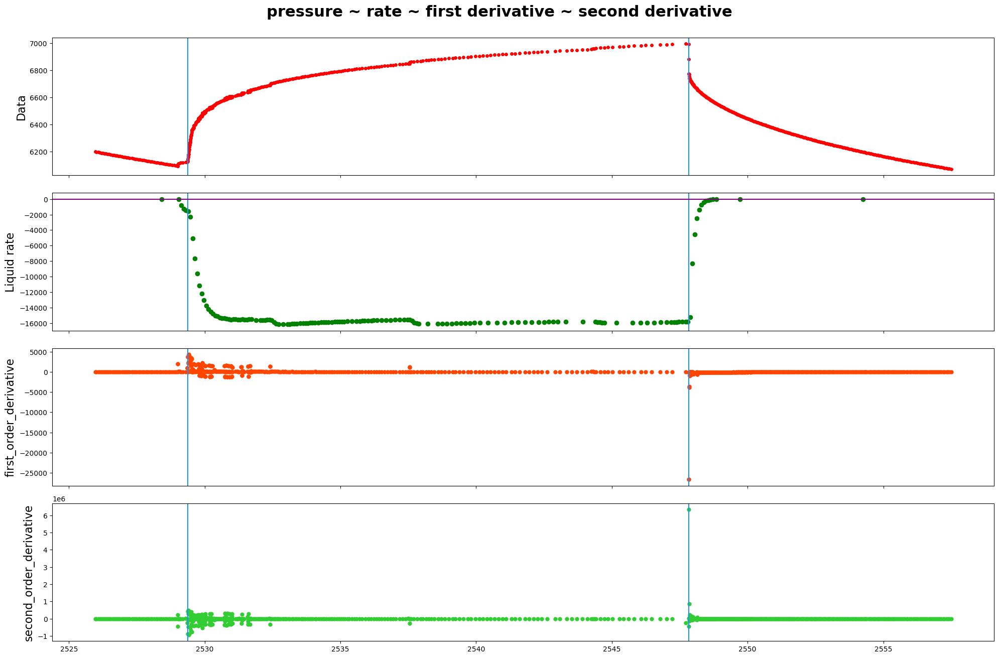

------row 31-----detected points:[]


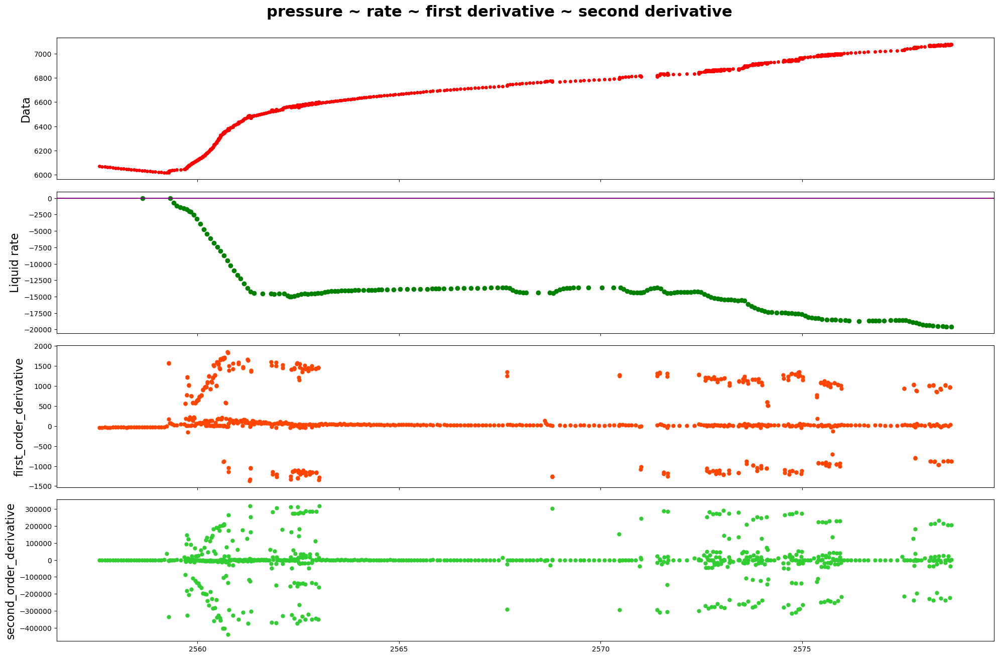

------row 32-----detected points:[21974, 22183]


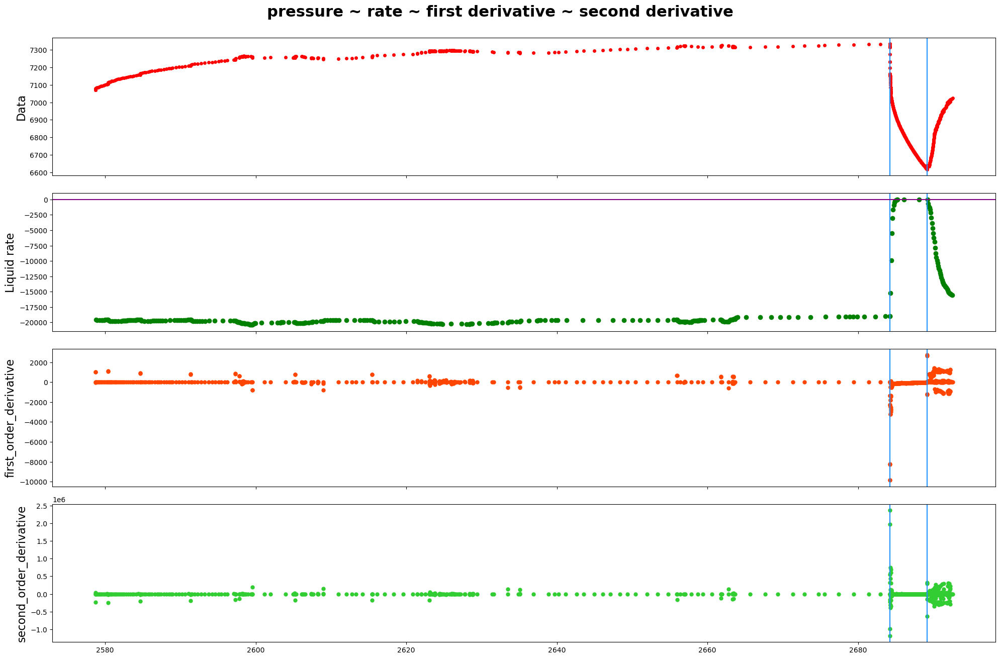

------row 33-----detected points:[22710]


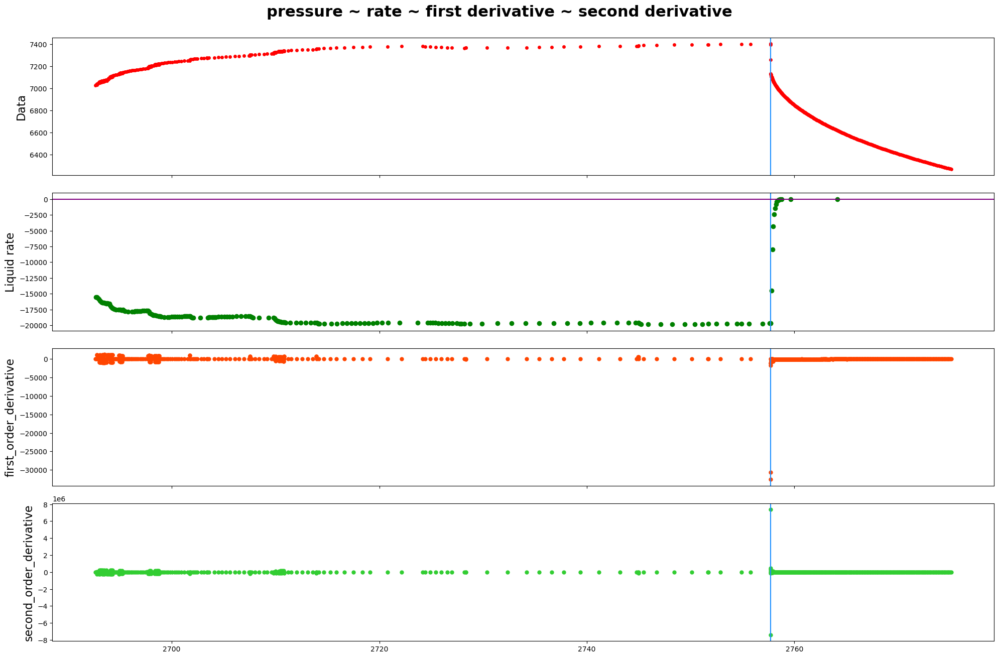

------row 34-----detected points:[]


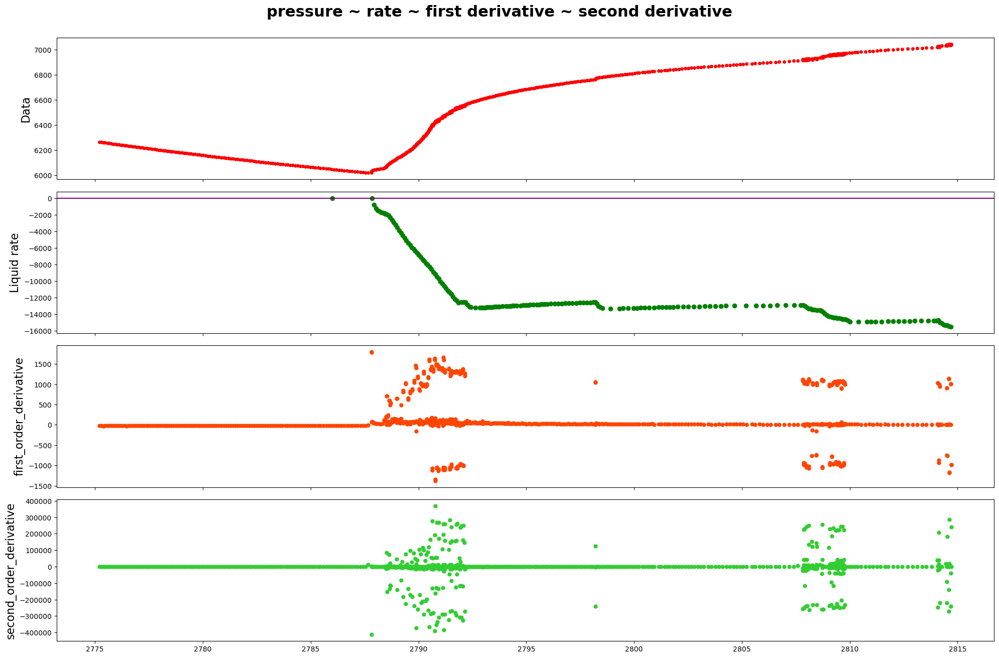

------row 35-----detected points:[24130, 24132, 24215, 24216, 24263, 24264]


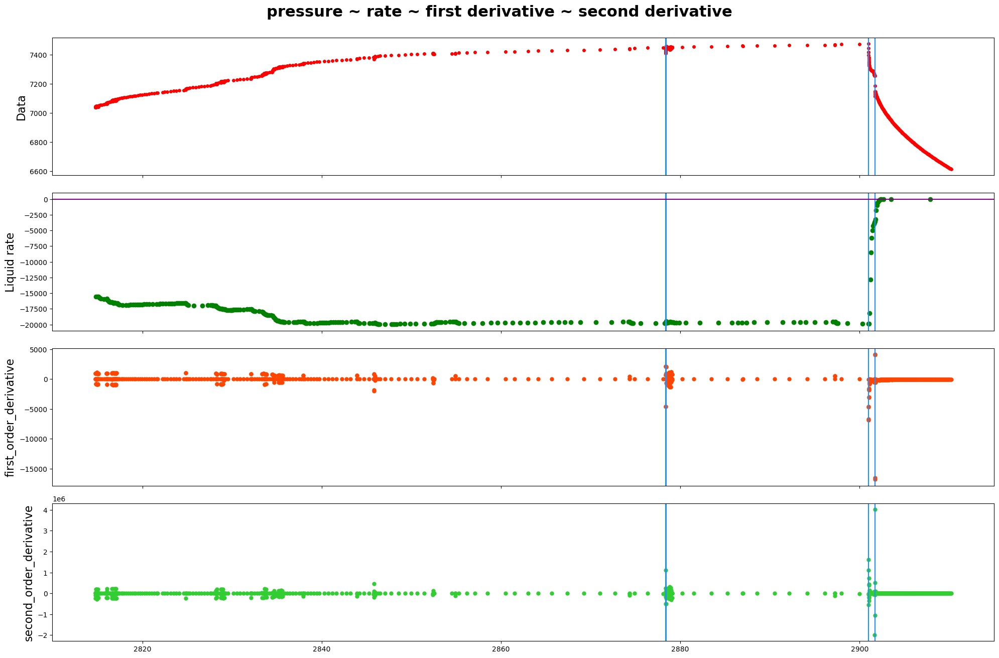

------row 36-----detected points:[24793]


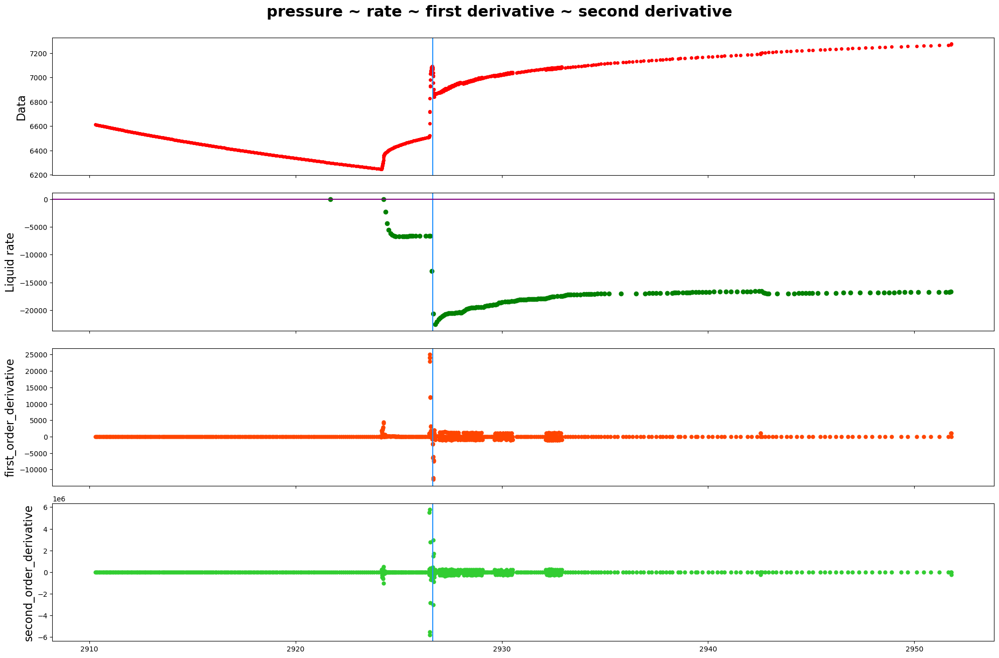

------row 37-----detected points:[]


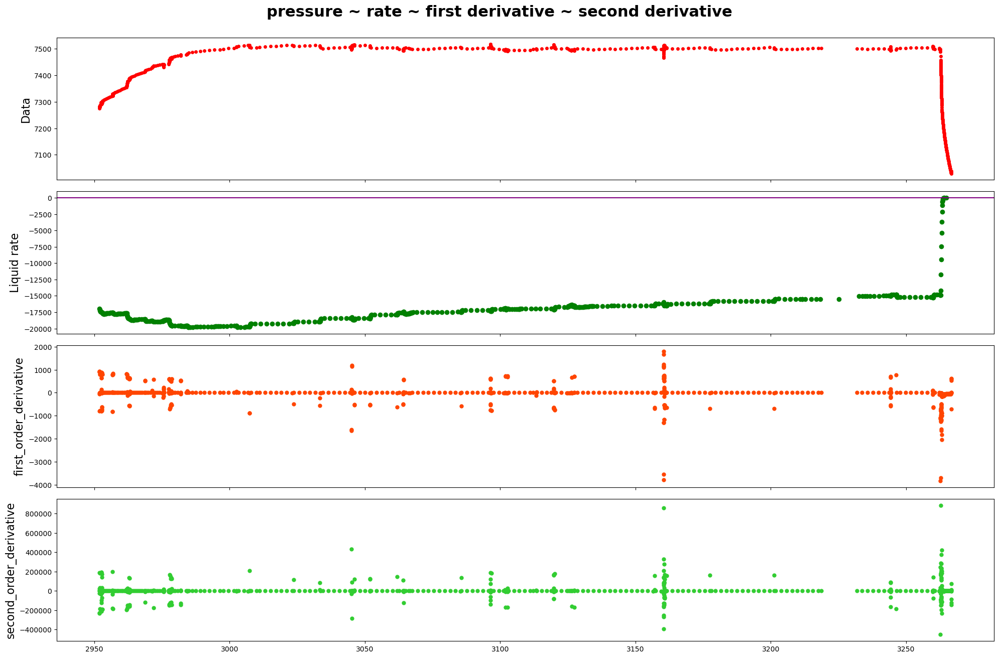

------row 38-----detected points:[26016, 26432, 26504]


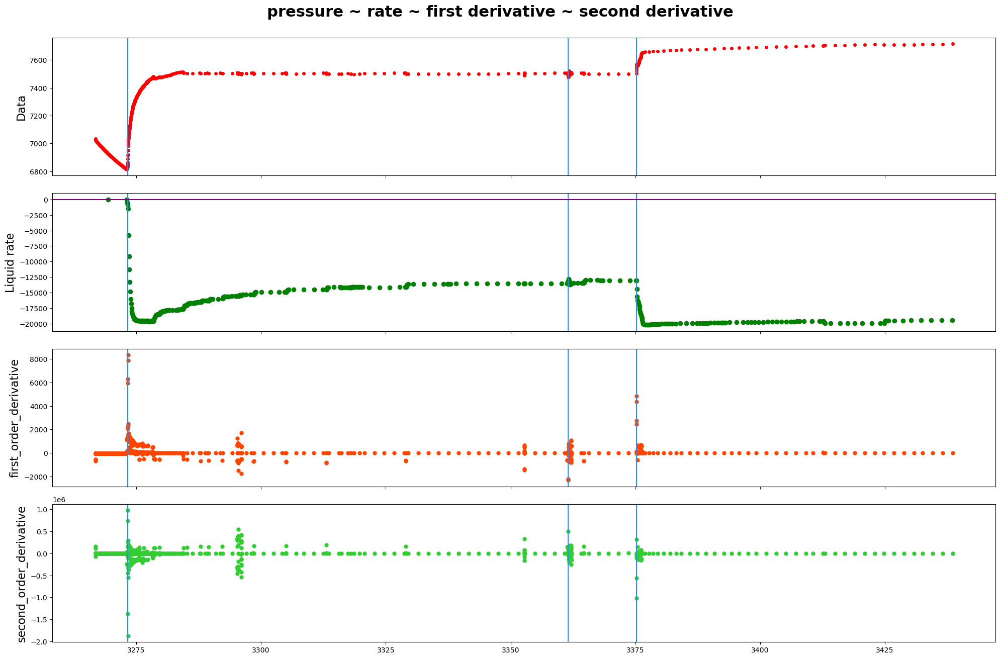

------row 39-----detected points:[26656, 26783, 27023]


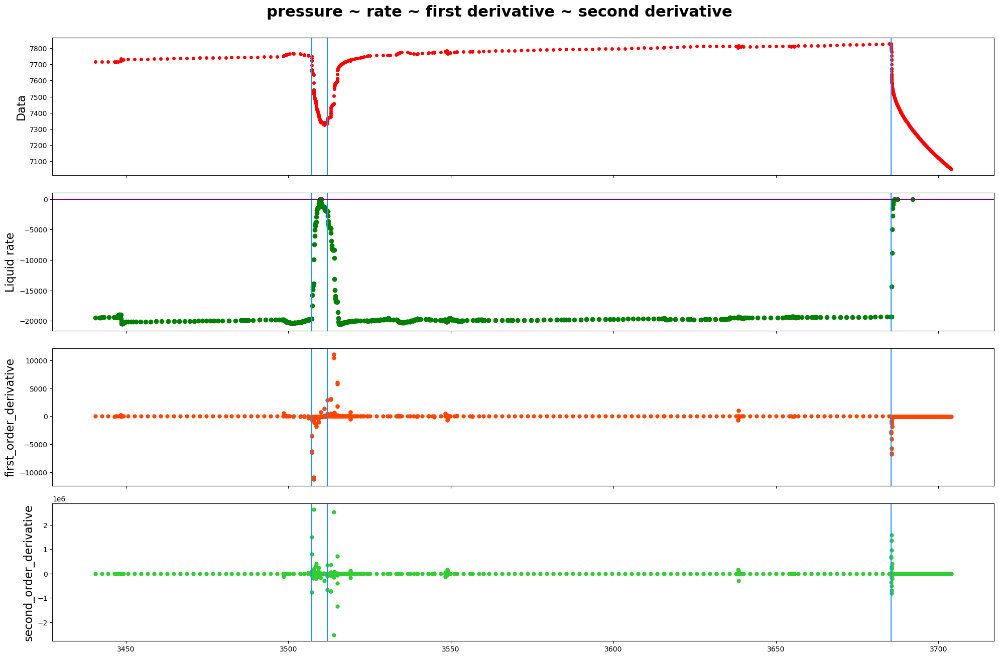

------row 40-----detected points:[27316, 27319, 27962, 27963, 27966]


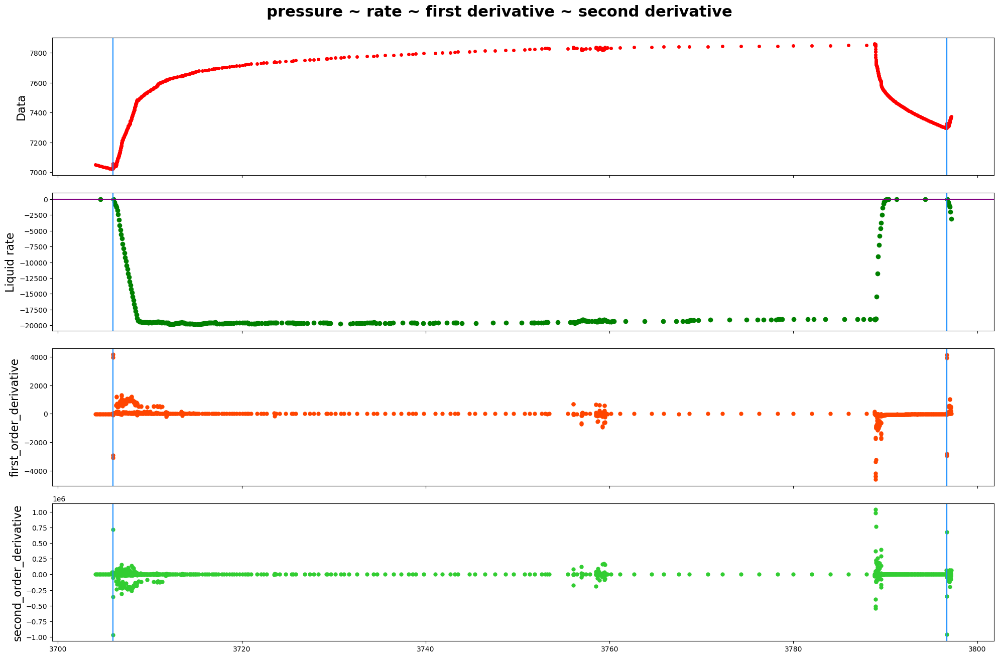

------row 41-----detected points:[28243, 28263, 28290, 28300, 28310]


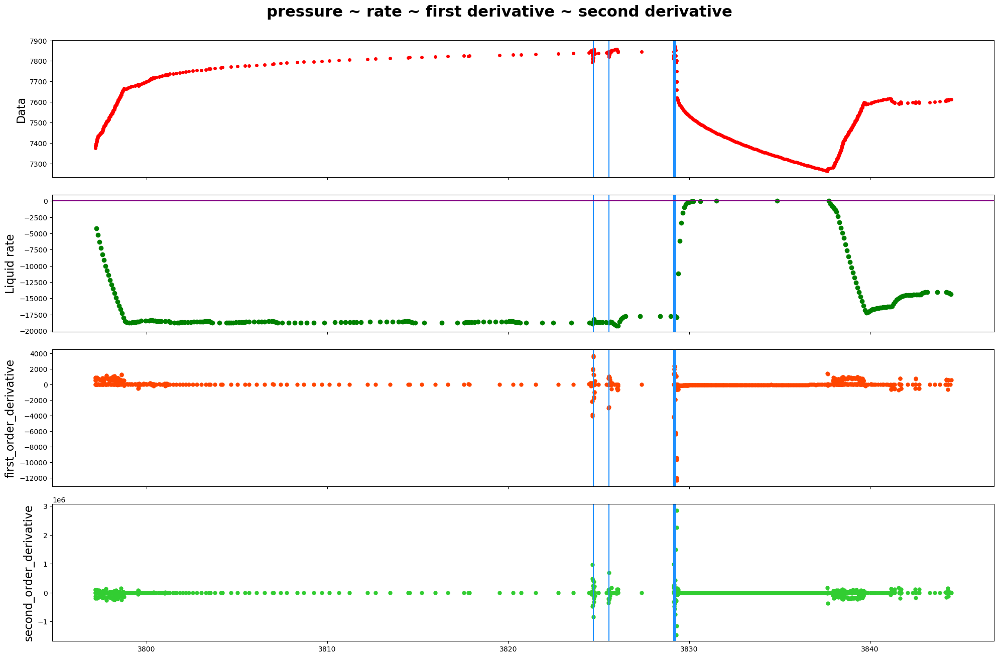

------row 42-----detected points:[29122]


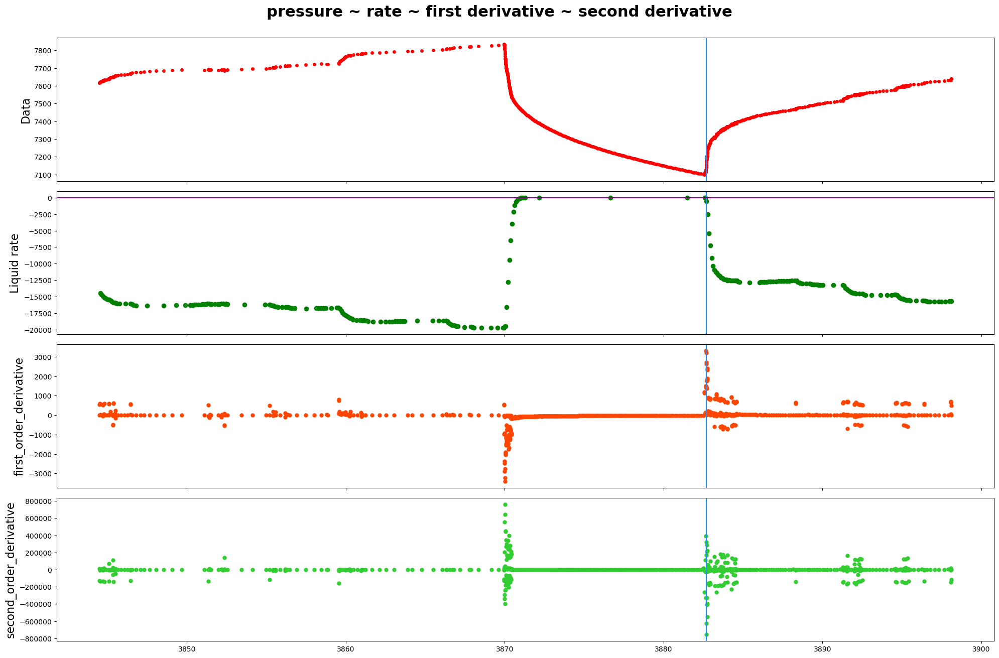

------row 43-----detected points:[29484, 29547, 29553]


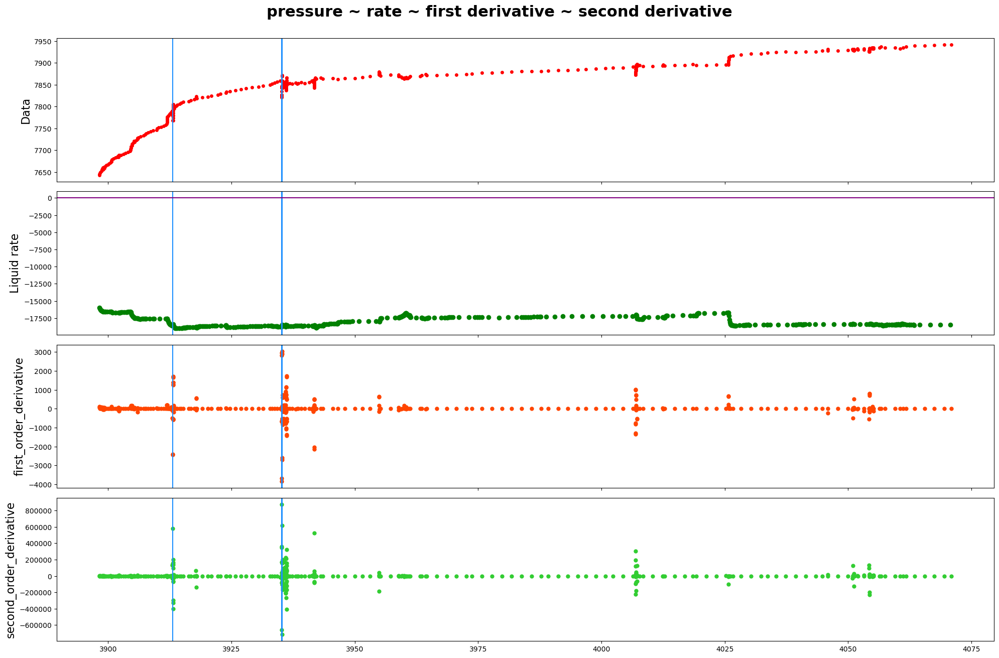

In [18]:
data_inOneRow=700
plot_4_metrics_details(data_inOneRow,
                       pressure_df,
                       rate_df,
                       breakpoints_detected_3,
                       ground_truth,
                       colum_names)

**S-G filter**

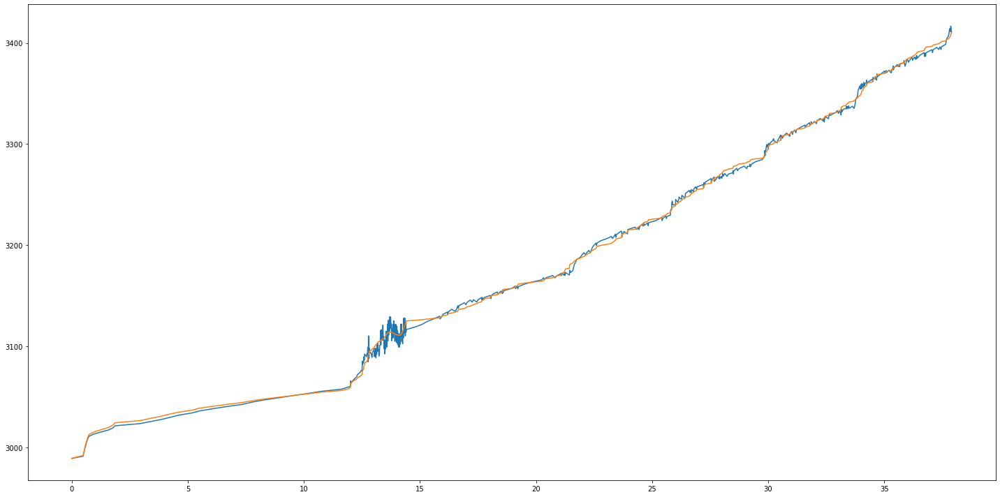

,Elapsed time,Data,first_order_derivative,second_order_derivative
0,0.000000,2989.186167,5.644146,255.067575
1,0.495833,2991.984723,132.115152,-1887.195136
2,0.516667,2994.737122,92.798586,1197.966129
3,0.545833,2997.443747,127.739264,-2364.117282
4,0.566667,3000.104982,78.486819,290.472694
...,...,...,...,...
29808,4063.495571,7940.565392,0.229772,-0.001447
29809,4065.499737,7941.025894,0.226872,-0.001470
29810,4067.503904,7941.480584,0.223926,0.041518
29811,4069.508071,7941.929369,0.307136,0.000000


217.076859984311 26067.263415502584
69


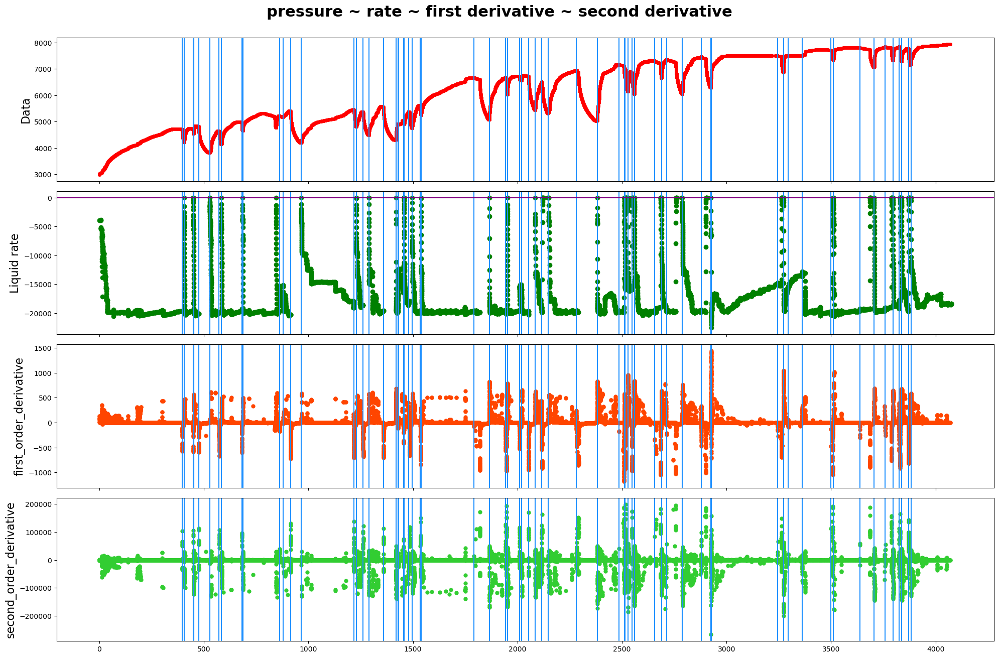

In [19]:
pressure_df,rate_df,pressure_rate=load_data_from_txt(pressure_file, rate_file)
denoised_pressure_data=savgol_filter(pressure_df["Data"],199,3)
pressure_df_first700=pressure_df.iloc[0:700,:]
fig=plt.figure(figsize=(20,10))
ax=fig.subplots()
p=ax.plot(pressure_df_first700["Elapsed time"],pressure_df_first700["Data"])
p=ax.plot(pressure_df_first700["Elapsed time"],denoised_pressure_data[0:700])
plt.show()
data={"Elapsed time":pressure_df["Elapsed time"],"Data":denoised_pressure_data}
pressure_df_denoised=pd.DataFrame(data=data)
pressure_df_denoised=produce_pressure_4metrics(pressure_df_denoised,colum_names)
display(pressure_df_denoised)
pressure_df=pressure_df_denoised
first_order_derivative=pressure_df["first_order_derivative"]
second_order_derivative=pressure_df["second_order_derivative"]
noise_threshold=0.3
breakpoints_detected_3SG=detect_breakpoints_3(first_order_derivative,second_order_derivative,noise_threshold)
print(len(breakpoints_detected_3SG))
plot_4_metrics(pressure_df,
               rate_df,
               breakpoints_detected_3SG,
               ground_truth,
               colum_names)

In [20]:
# data_inOneRow=700
# plot_4_metrics_details(data_inOneRow,
#                        pressure_df,
#                        rate_df,
#                        breakpoints_detected,
#                        ground_truth,
#                        colum_names)

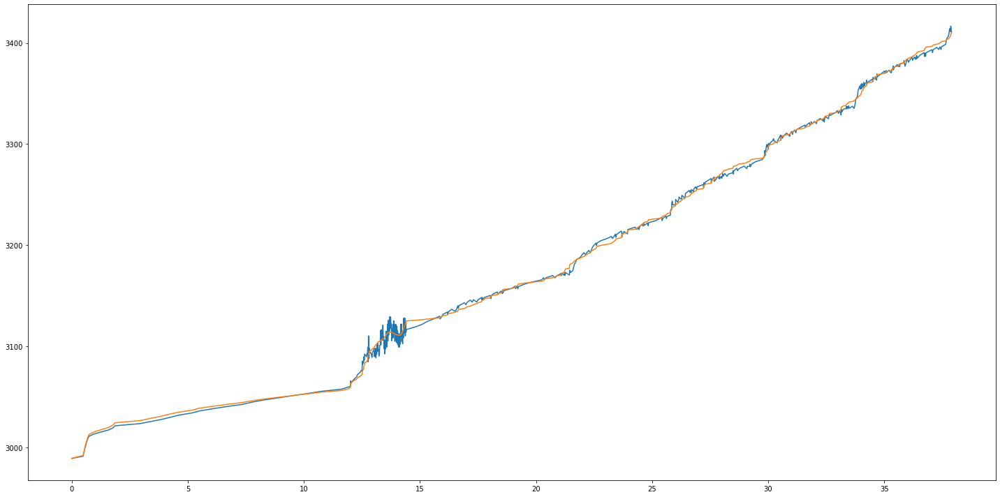

,Elapsed time,Data,first_order_derivative,second_order_derivative
0,0.000000,2989.186167,5.644146,255.067575
1,0.495833,2991.984723,132.115152,-1887.195136
2,0.516667,2994.737122,92.798586,1197.966129
3,0.545833,2997.443747,127.739264,-2364.117282
4,0.566667,3000.104982,78.486819,290.472694
...,...,...,...,...
29808,4063.495571,7940.565392,0.229772,-0.001447
29809,4065.499737,7941.025894,0.226872,-0.001470
29810,4067.503904,7941.480584,0.223926,0.041518
29811,4069.508071,7941.929369,0.307136,0.000000


len(breakpoints_detected) 404


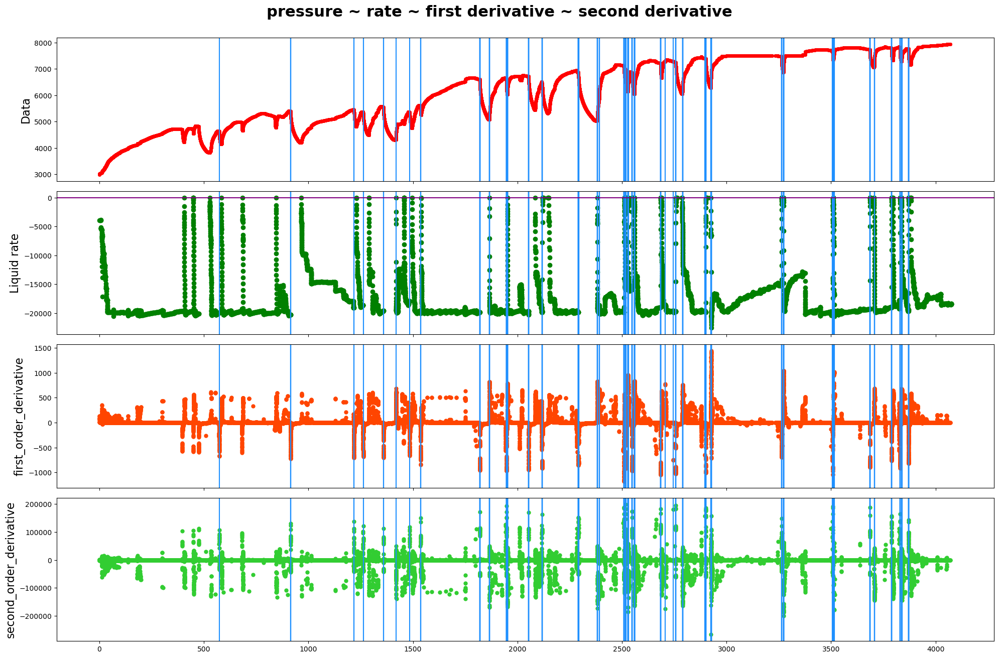

In [21]:
#S-G filter startPoint2
pressure_df,rate_df,pressure_rate=load_data_from_txt(pressure_file, rate_file)
denoised_pressure_data=savgol_filter(pressure_df["Data"],199,3)
pressure_df_first700=pressure_df.iloc[0:700,:]
fig=plt.figure(figsize=(20,10))
ax=fig.subplots()
p=ax.plot(pressure_df_first700["Elapsed time"],pressure_df_first700["Data"])
p=ax.plot(pressure_df_first700["Elapsed time"],denoised_pressure_data[0:700])
plt.show()
data={"Elapsed time":pressure_df["Elapsed time"],"Data":denoised_pressure_data}
pressure_df_denoised=pd.DataFrame(data=data)
pressure_df_denoised=produce_pressure_4metrics(pressure_df_denoised,colum_names)
display(pressure_df_denoised)
pressure_df=pressure_df_denoised
first_order_derivative=pressure_df["first_order_derivative"]
second_order_derivative=pressure_df["second_order_derivative"]
noise_threshold=3
breakpoints_detected_startPoint2=detect_breakpoints_startPoint2(first_order_derivative,second_order_derivative,noise_threshold)
print("len(breakpoints_detected)",len(breakpoints_detected_startPoint2))
plot_4_metrics(pressure_df,
               rate_df,
               breakpoints_detected_startPoint2,
               ground_truth,
               colum_names)

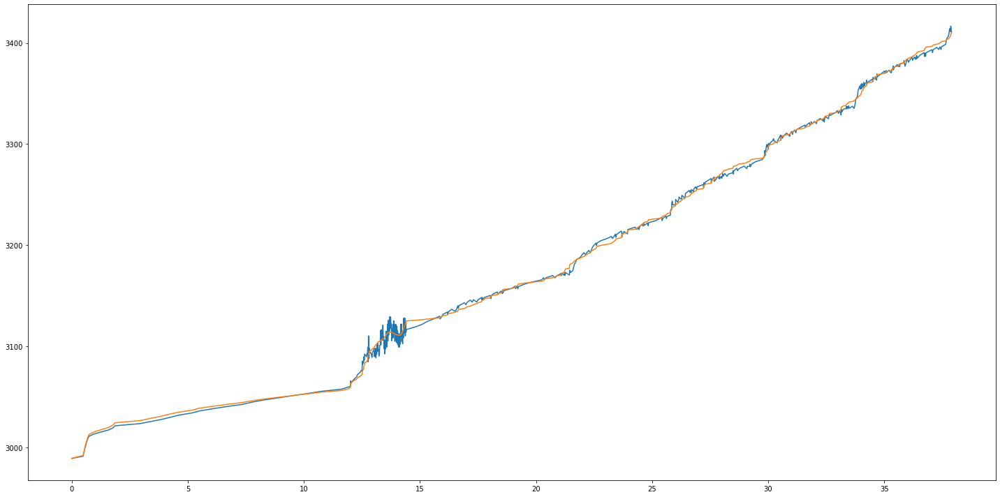

,Elapsed time,Data,first_order_derivative,second_order_derivative
0,0.000000,2989.186167,5.644146,255.067575
1,0.495833,2991.984723,132.115152,-1887.195136
2,0.516667,2994.737122,92.798586,1197.966129
3,0.545833,2997.443747,127.739264,-2364.117282
4,0.566667,3000.104982,78.486819,290.472694
...,...,...,...,...
29808,4063.495571,7940.565392,0.229772,-0.001447
29809,4065.499737,7941.025894,0.226872,-0.001470
29810,4067.503904,7941.480584,0.223926,0.041518
29811,4069.508071,7941.929369,0.307136,0.000000


len(breakpoints_detected) 823


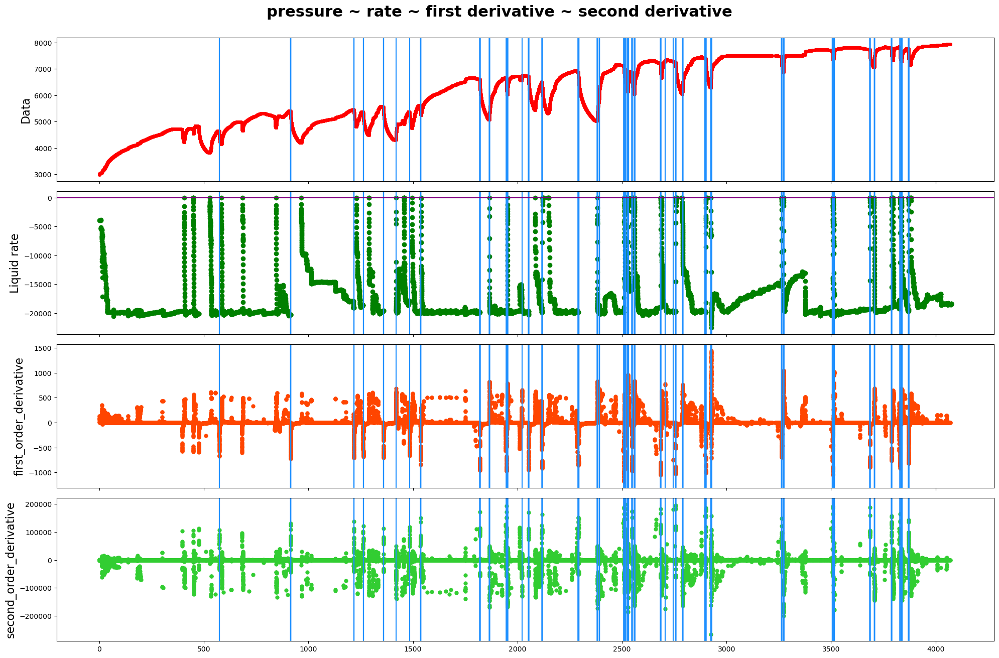

In [22]:
#S-G filter startPoint
pressure_df,rate_df,pressure_rate=load_data_from_txt(pressure_file, rate_file)
denoised_pressure_data=savgol_filter(pressure_df["Data"],199,3)
pressure_df_first700=pressure_df.iloc[0:700,:]
fig=plt.figure(figsize=(20,10))
ax=fig.subplots()
p=ax.plot(pressure_df_first700["Elapsed time"],pressure_df_first700["Data"])
p=ax.plot(pressure_df_first700["Elapsed time"],denoised_pressure_data[0:700])
plt.show()
data={"Elapsed time":pressure_df["Elapsed time"],"Data":denoised_pressure_data}
pressure_df_denoised=pd.DataFrame(data=data)
pressure_df_denoised=produce_pressure_4metrics(pressure_df_denoised,colum_names)
display(pressure_df_denoised)
pressure_df=pressure_df_denoised
first_order_derivative=pressure_df["first_order_derivative"]
second_order_derivative=pressure_df["second_order_derivative"]
noise_threshold=3
breakpoints_detected=detect_breakpoints_startPoint(first_order_derivative,noise_threshold)
print("len(breakpoints_detected)",len(breakpoints_detected))
plot_4_metrics(pressure_df,
               rate_df,
               breakpoints_detected,
               ground_truth,
               colum_names)

In [23]:
len(breakpoints_detected_3),len(breakpoints_detected_3SG)
index_zero_rate=[index for index, rate in enumerate(rate_df["Liquid rate"]) if rate==0]
print(index_zero_rate)
indexo_rate=[rate_df.iloc[index]["Elapsed time"] for index, rate in enumerate(rate_df["Liquid rate"]) if rate==0]
time_zero_rate=[rate_df.iloc[index]["Elapsed time"] for index, rate in enumerate(rate_df["Liquid rate"]) if rate==0]
len(time_zero_rate),time_zero_rate

[612, 840, 1055, 1277, 1490, 1746, 2141, 2297, 2577, 2894, 3083, 3629, 4060, 4403, 4687, 5180, 5810, 5958, 6698, 7177, 8855, 9594]


(22,
 [405.3250216668821,
  527.1083722224575,
  582.5500388891087,
  684.6853344445699,
  844.977126388927,
  964.993793055648,
  1229.352107777784,
  1288.653231251141,
  1418.160459722334,
  1495.343793055625,
  1538.818745555735,
  1865.877130833396,
  1951.179161388951,
  2084.704158055654,
  2144.825025139027,
  2381.404161388928,
  2528.408197638957,
  2558.633288472367,
  2786.01649597229,
  2921.674839305633,
  3704.607788611029,
  3881.482903889031])

In [25]:
breakpoints_zero_rate=[]
for time_rate in time_zero_rate:
    for index, time_pressure in enumerate(pressure_df["Elapsed time"]):
        if time_pressure>=time_rate:
            breakpoints_zero_rate. append(index)
            break
len(breakpoints_zero_rate) 
breakpoints_zero_rate
zero_rate={"index_zero_rate":index_zero_rate,"breakpoints_zero_rate":breakpoints_zero_rate}
zero_rate_df=pd.DataFrame(data=zero_rate)
zero_rate_df

,index_zero_rate,breakpoints_zero_rate
0,612,2467
1,840,3561
2,1055,4228
3,1277,4895
4,1490,5436
5,1746,6543
6,2141,7544
7,2297,8364
8,2577,9607
9,2894,10801


In [61]:
rate_df.iloc[1489]["Elapsed time"]
for index, time_pressure in enumerate(pressure_df["Elapsed time"]):
        if time_pressure>=rate_df.iloc[2893]["Elapsed time"]:
            print(index)
            break

10528


In [63]:
print(len(breakpoints_detected_3+breakpoints_detected_3SG+breakpoints_zero_rate+[5297]))
breakpoints_union=set(breakpoints_detected_3+breakpoints_detected_3SG+breakpoints_zero_rate+[5297]+[10216]+[10528])
print(len(breakpoints_union))
# breakpoints_union

208
195


In [26]:
rate_df.iloc[1490], rate_df.iloc[1489]["Elapsed time"]

(Elapsed time    844.977126
 Liquid rate       0.000000
 Name: 1490, dtype: float64,
 837.4625141668366)

In [28]:
rate_df.iloc[3]["Elapsed time"]

6.641717777936719

In [29]:
breakpoints_zero_rate
rate_df.iloc[612]

Elapsed time    405.325022
Liquid rate       0.000000
Name: 612, dtype: float64

In [58]:
a=pressure_df.iloc[10150:10245]["Data"]
min(a)
pressure_df.loc[pressure_df["Data"]==min(a)]
pd.set_option('display.max_rows', pressure_df.shape[0]+1)
display(pressure_df.iloc[10150:10245])
delta=pressure_df.iloc[10151]["Elapsed time"]-pressure_df.iloc[10150]["Elapsed time"]
for i in range(10150,10223):
    t=pressure_df.iloc[i+1]["Elapsed time"]-pressure_df.iloc[i]["Elapsed time"]
    print(i,t,delta)
    if t>delta:
        delta=t
        pointer=i
i

,Elapsed time,Data,first_order_derivative,second_order_derivative
10150,1456.343793,5013.764088,-365.674185,-1372.557265
10151,1456.347960,5012.240323,-371.393631,43959.211710
10152,1456.352126,5010.693098,-188.259555,-23242.525129
10153,1456.360460,5009.124142,-381.962760,-902.453212
10154,1456.364626,5007.532886,-385.722380,68805.246708
10155,1456.368793,5005.925580,-99.010917,-6227.973446
10156,1456.385460,5004.275365,-202.812550,-23738.035544
10157,1456.393793,5002.585328,-400.621600,-817.531451
10158,1456.397960,5000.915938,-404.028254,48125.077885
10159,1456.402126,4999.232757,-203.539179,-24738.553590


10150 0.004167000000052212 0.004167000000052212
10151 0.00416599999994105 0.004167000000052212
10152 0.008334000000104425 0.004167000000052212
10153 0.00416599999994105 0.008334000000104425
10154 0.004167000000052212 0.008334000000104425
10155 0.016666999999870313 0.008334000000104425
10156 0.008332999999993262 0.016666999999870313
10157 0.004167000000052212 0.016666999999870313
10158 0.00416599999994105 0.016666999999870313
10159 0.008334000000104425 0.016666999999870313
10160 0.00416599999994105 0.016666999999870313
10161 0.004167000000052212 0.016666999999870313
10162 0.016666999999870313 0.016666999999870313
10163 0.016665999999986525 0.016666999999870313
10164 0.016667000000097687 0.016666999999870313
10165 0.016667000000097687 0.016667000000097687
10166 0.016665999999986525 0.016667000000097687
10167 0.016666999999870313 0.016667000000097687
10168 0.016667000000097687 0.016667000000097687
10169 0.016665999999986525 0.016667000000097687
10170 0.016666999999870313 0.016667000000097

10222

In [30]:
# data_inOneRow=700
# plot_4_metrics_details(data_inOneRow,
#                        pressure_df,
#                        rate_df,
#                        breakpoints_zero_rate,
#                        ground_truth,
#                        colum_names)

detected 195 points as breakpoints
The plot is devided into 60 rows
------row 1-----detected points:[66, 67, 157, 172, 174, 175, 236, 241, 268, 269, 278, 292, 293, 301, 302]


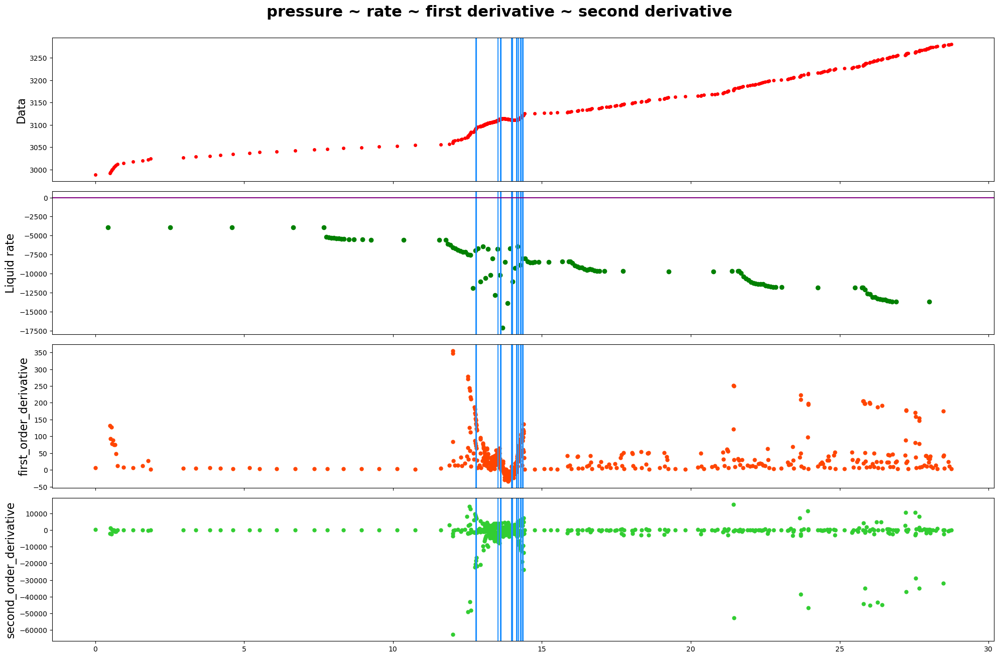

------row 2-----detected points:[]


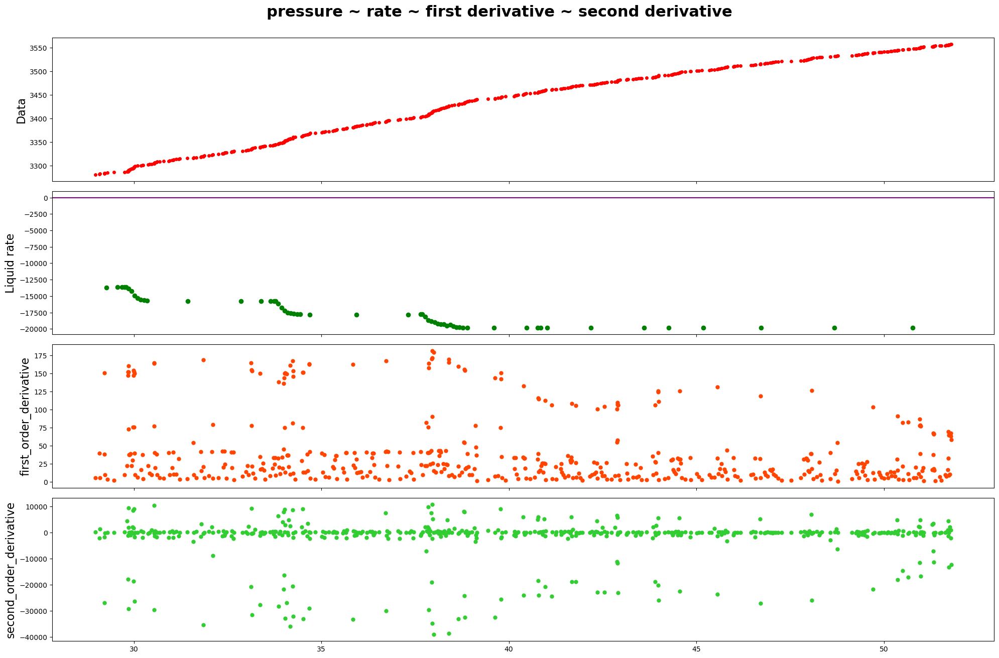

------row 3-----detected points:[]


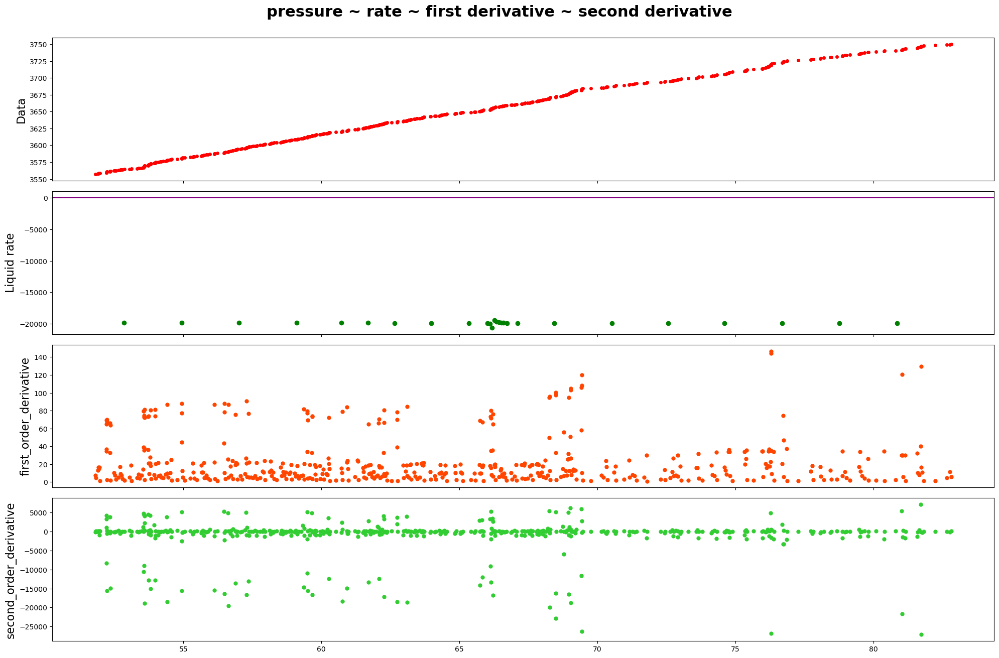

------row 4-----detected points:[]


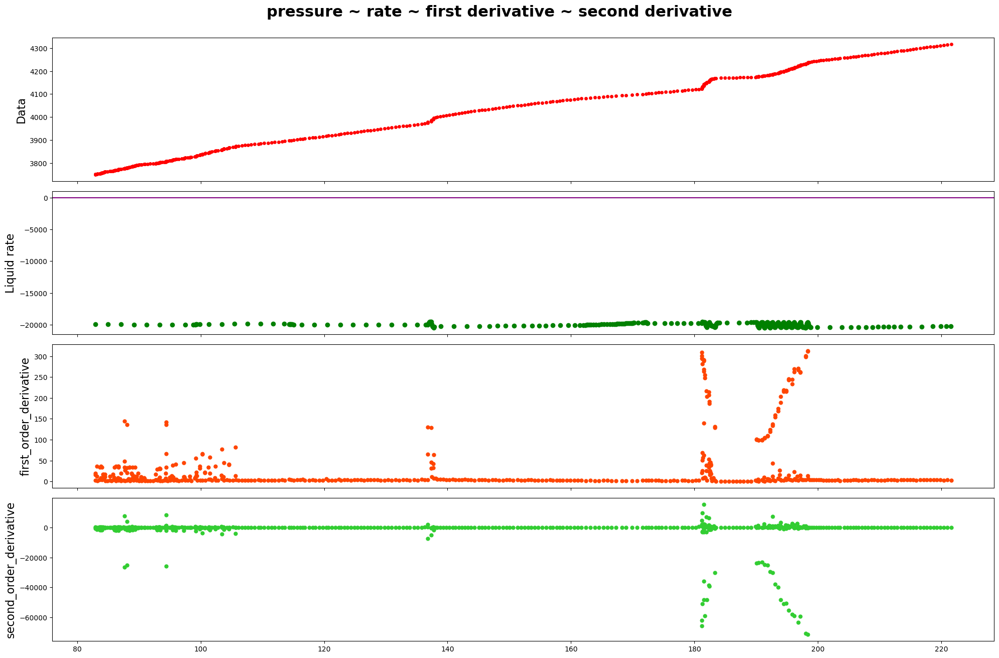

------row 5-----detected points:[2248, 2249, 2252, 2467, 2479]


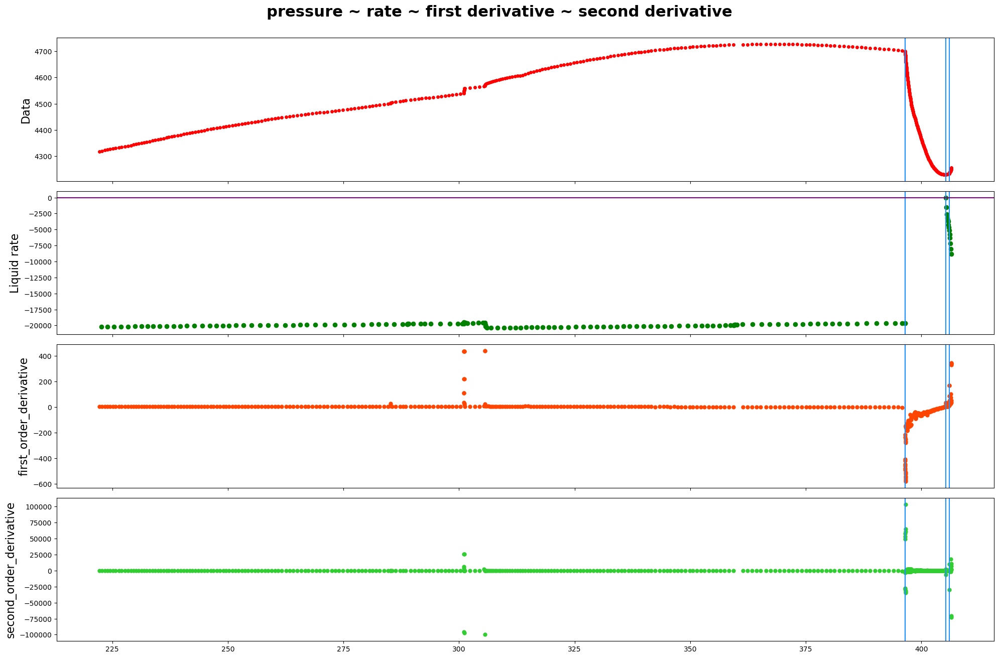

------row 6-----detected points:[2576, 2577, 2804, 2805, 2875, 2876, 2893, 2948]


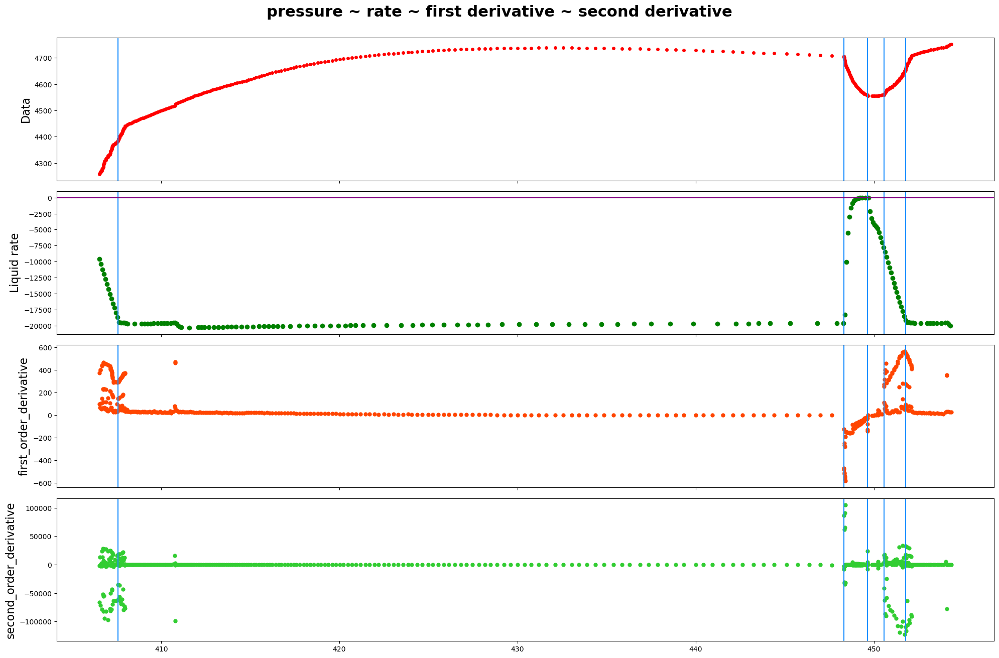

------row 7-----detected points:[3095, 3100]


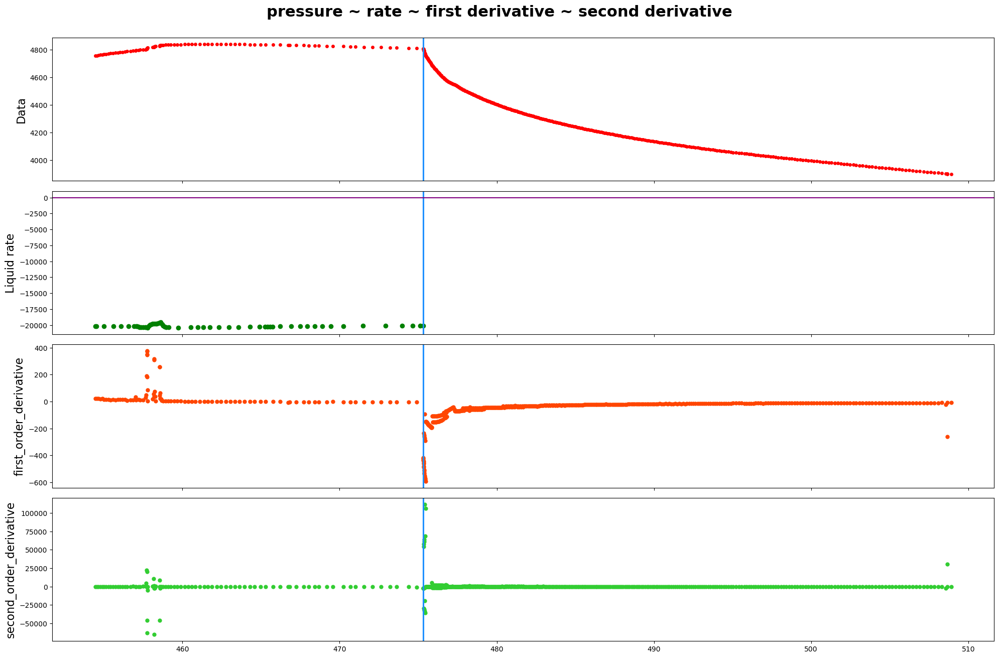

------row 8-----detected points:[3561, 3694, 3988, 3989, 3994]


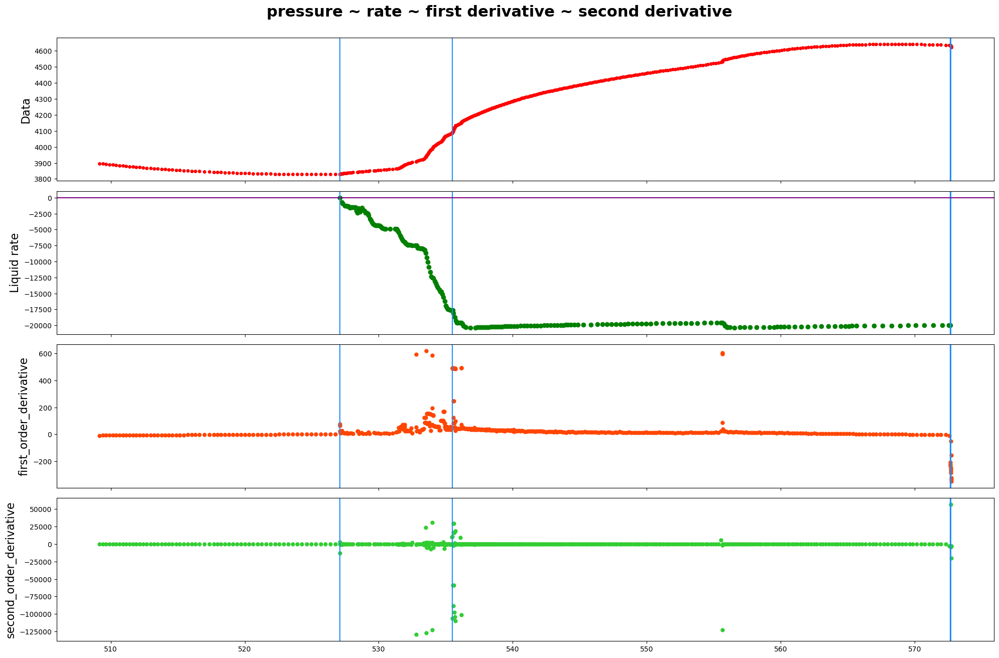

------row 9-----detected points:[4228, 4232]


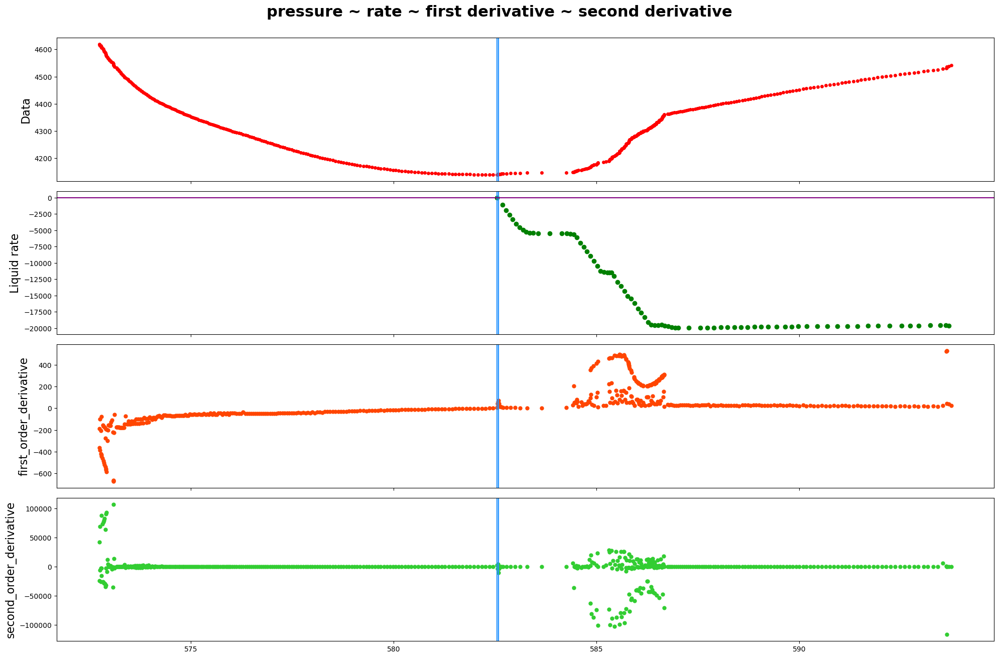

------row 10-----detected points:[4753, 4762, 4895, 4899]


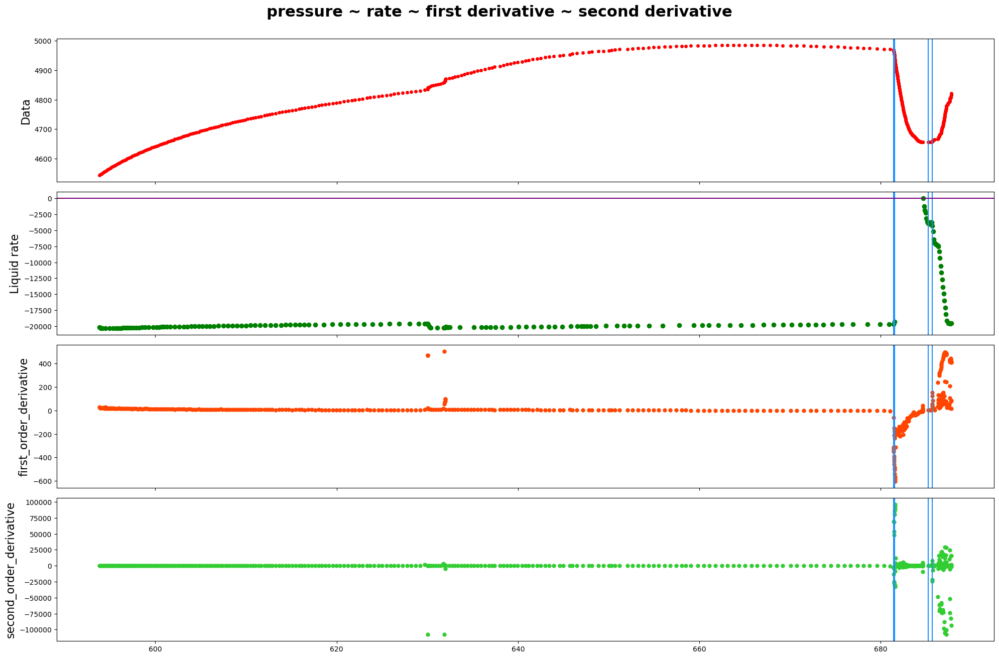

------row 11-----detected points:[5297, 5436]


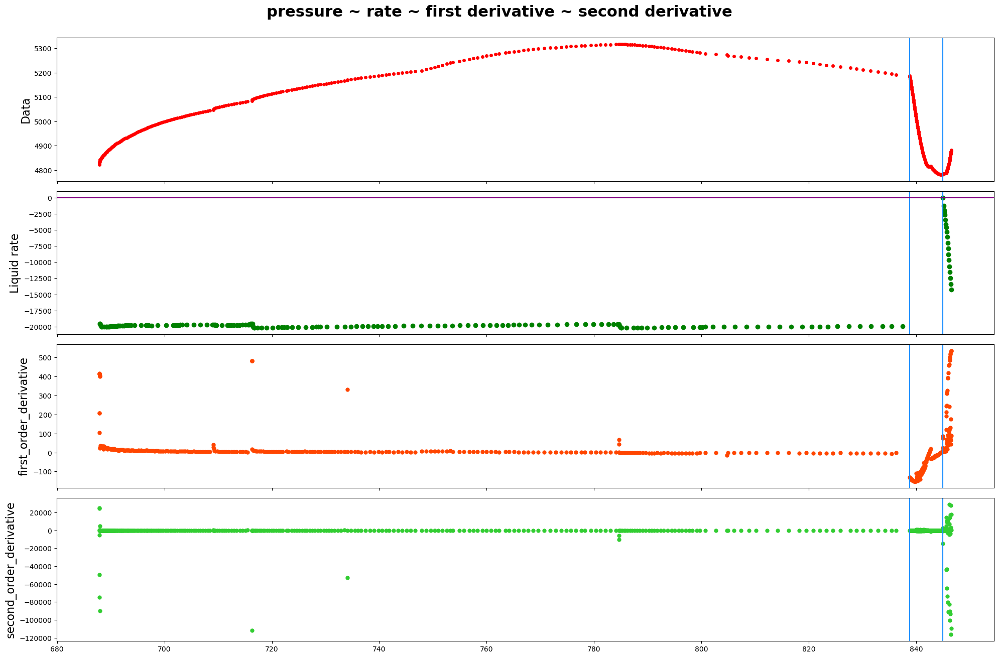

------row 12-----detected points:[5524, 5696, 5771, 5786, 5984, 5986]


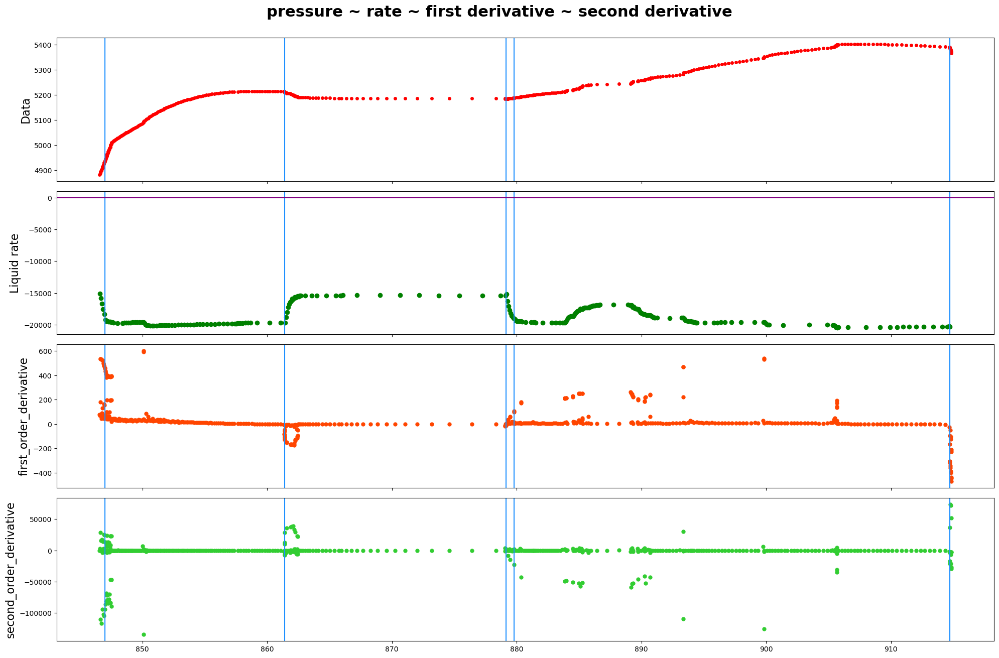

------row 13-----detected points:[]


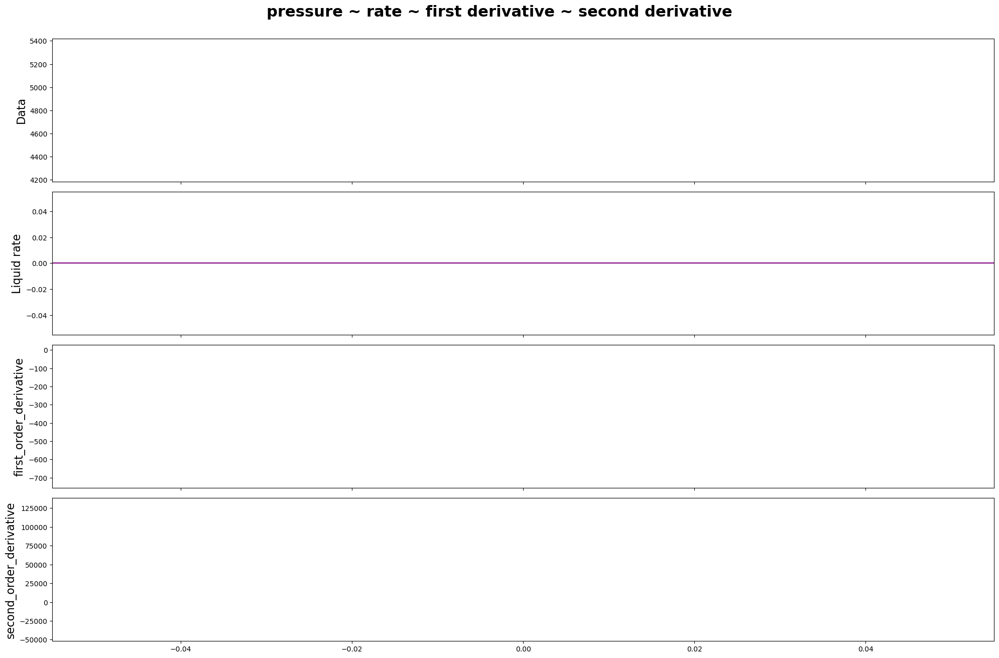

------row 14-----detected points:[6543, 6544, 6546, 6547]


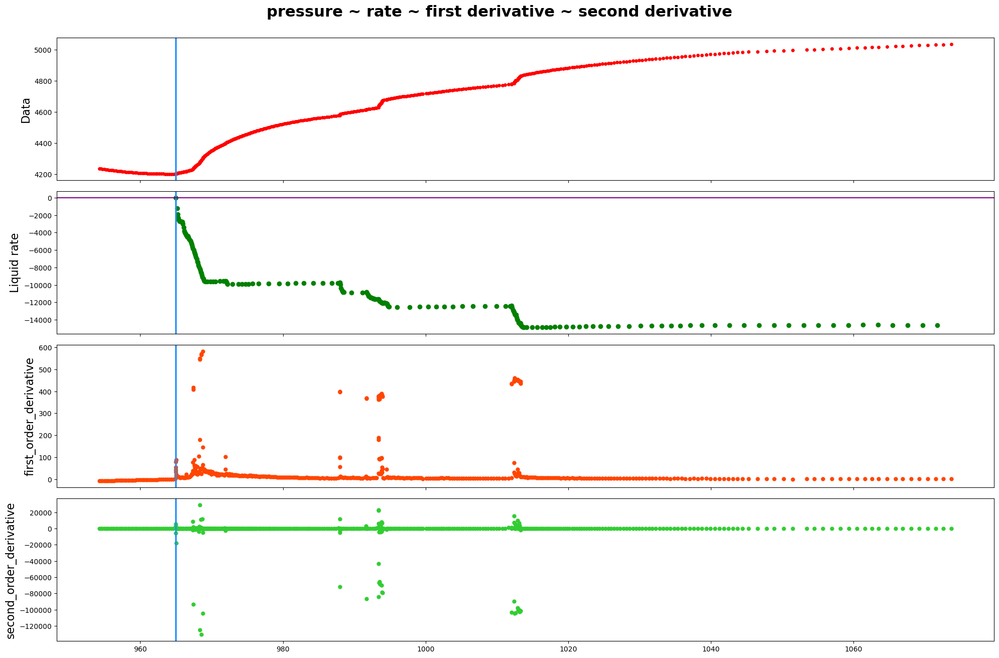

------row 15-----detected points:[7249]


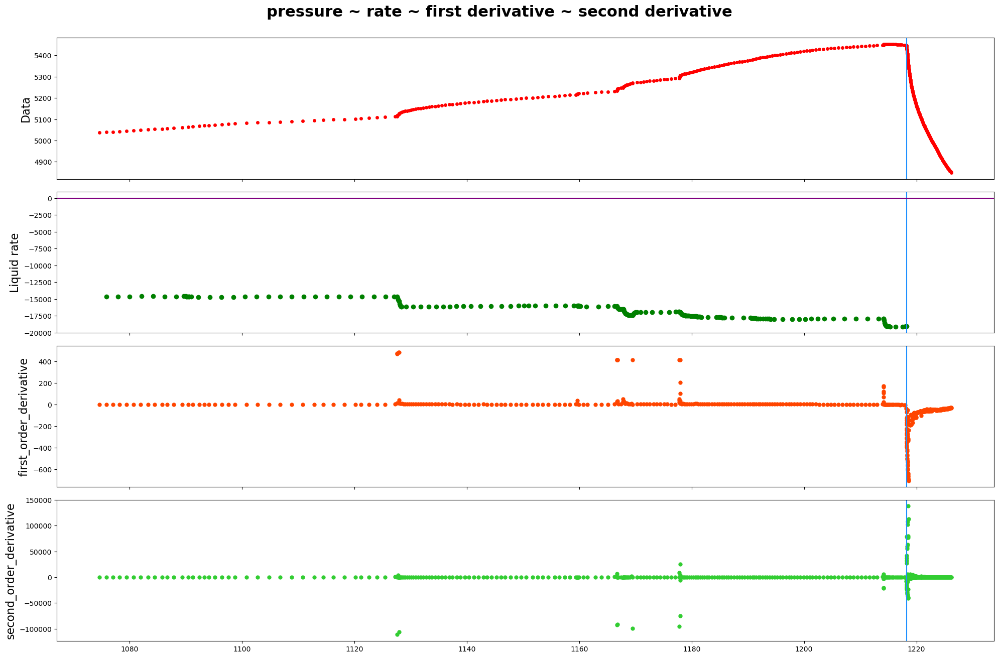

------row 16-----detected points:[7544, 7545, 7946]


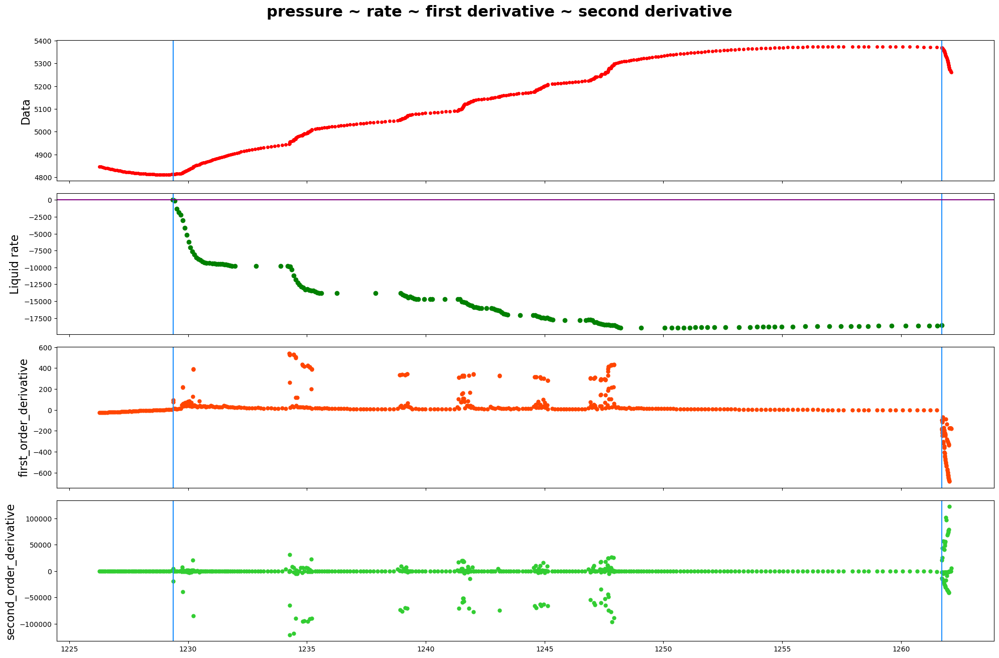

------row 17-----detected points:[8361, 8362, 8364]


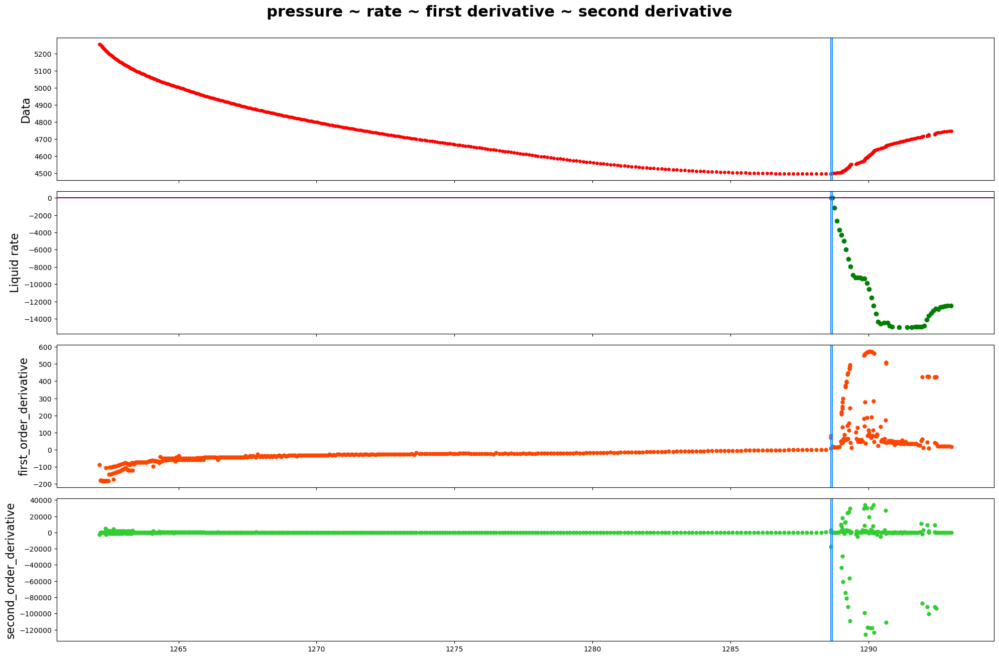

------row 18-----detected points:[]


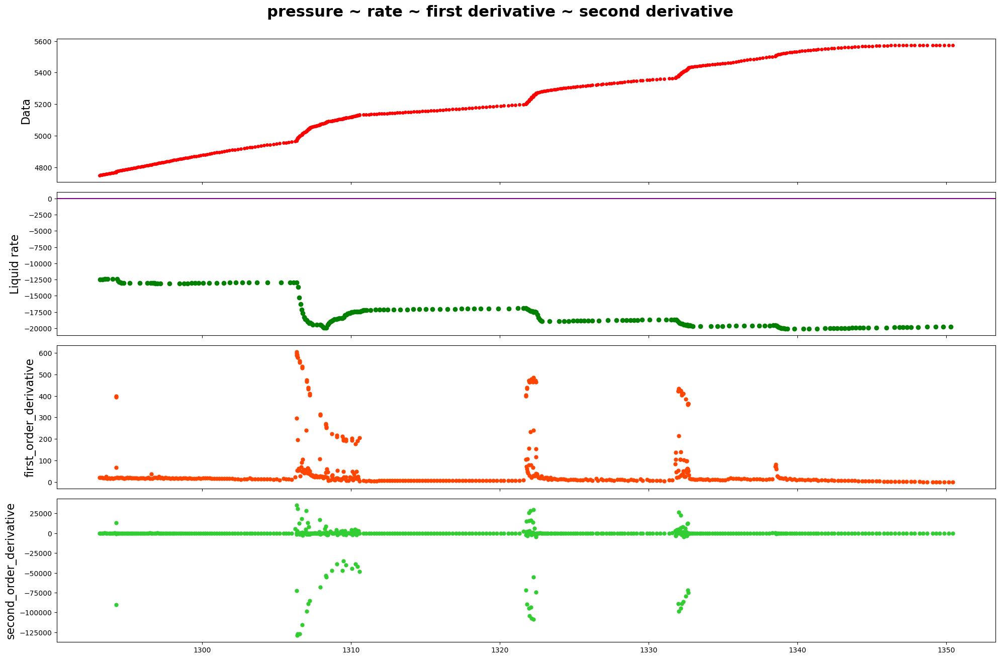

------row 19-----detected points:[9025]


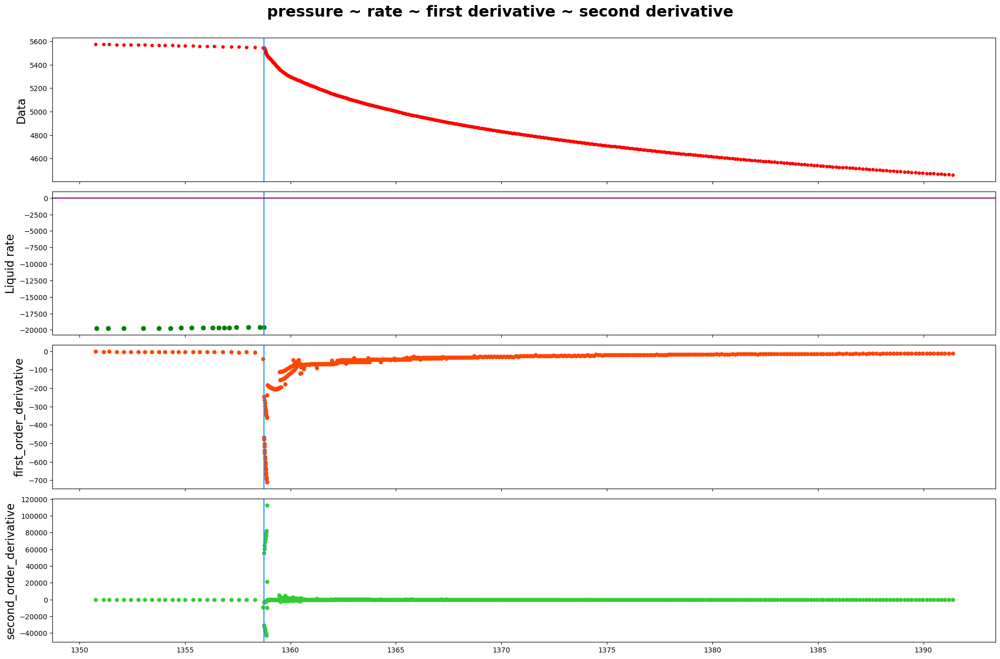

------row 20-----detected points:[9607, 9608, 9620, 9629, 9638, 9961]


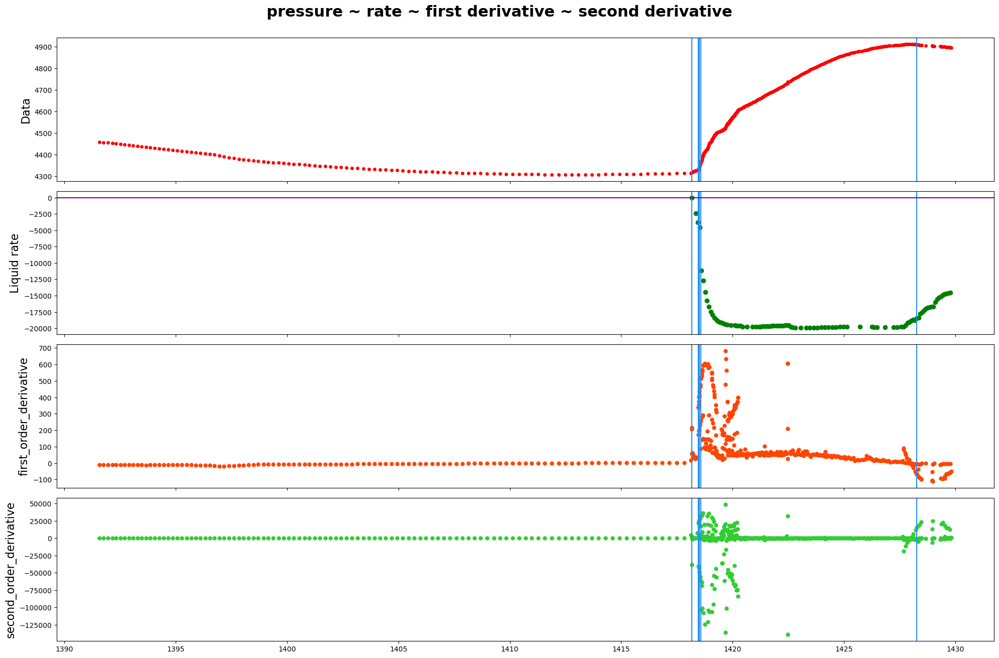

------row 21-----detected points:[10021, 10149, 10150, 10216, 10245, 10499]


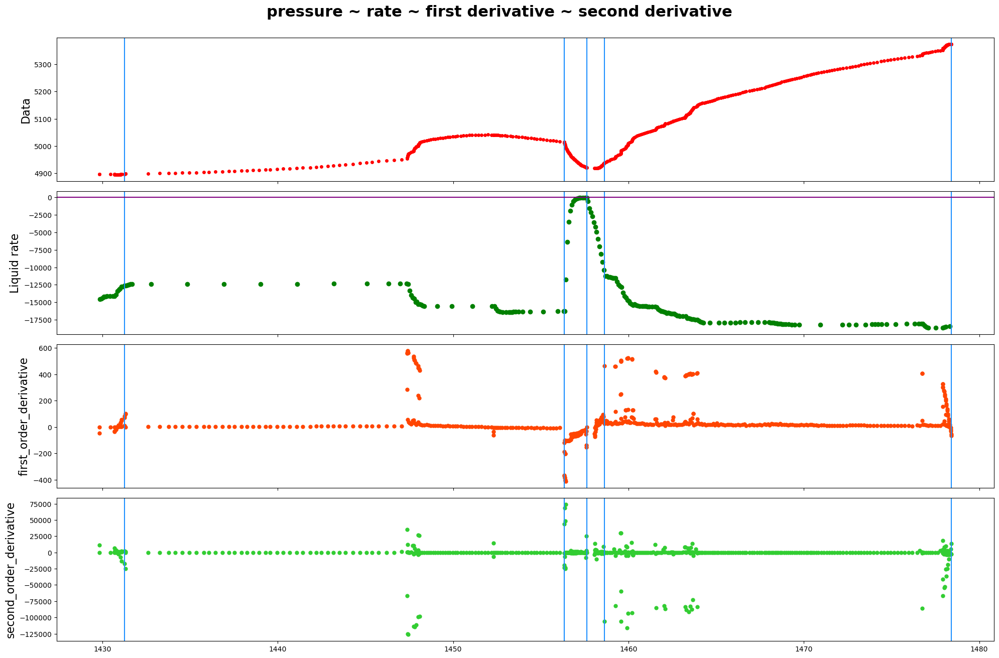

------row 22-----detected points:[10528, 10801, 10804]


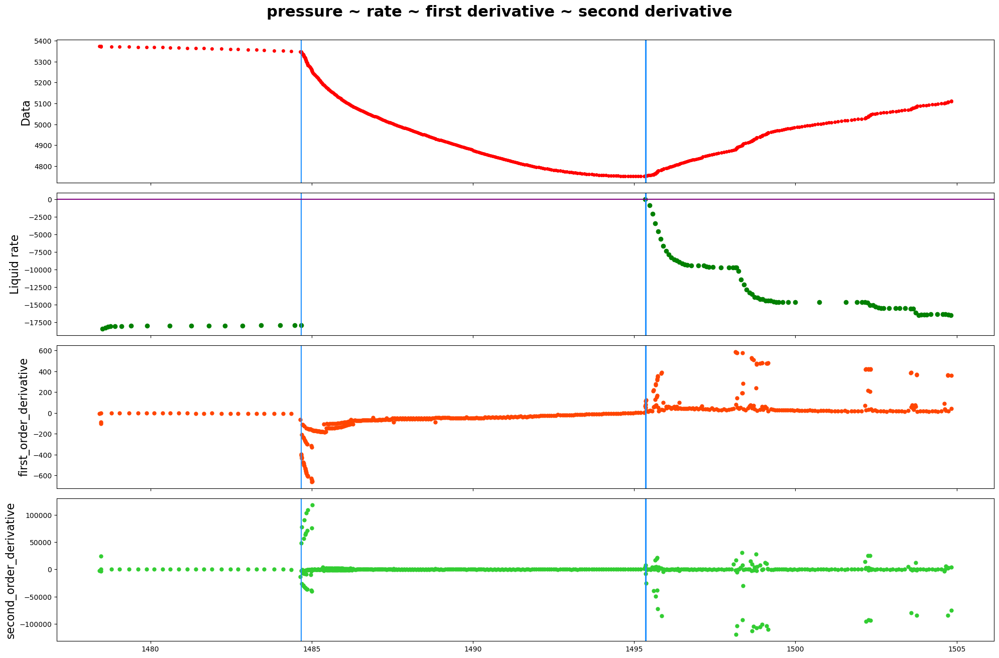

------row 23-----detected points:[11326, 11340, 11475, 11479, 11483, 11492]


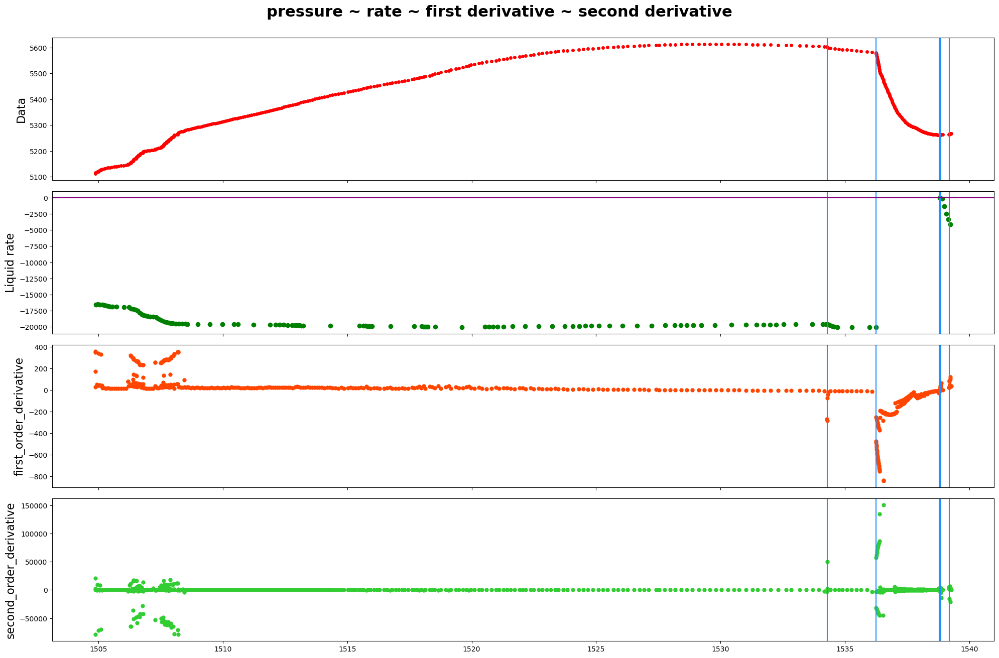

------row 24-----detected points:[]


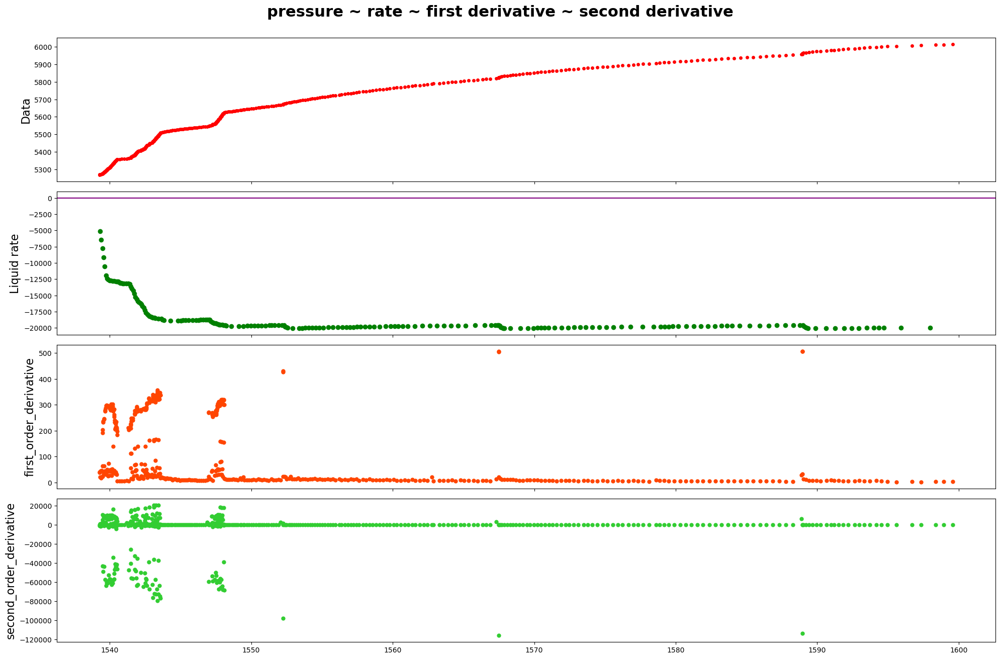

------row 25-----detected points:[12321, 12363]


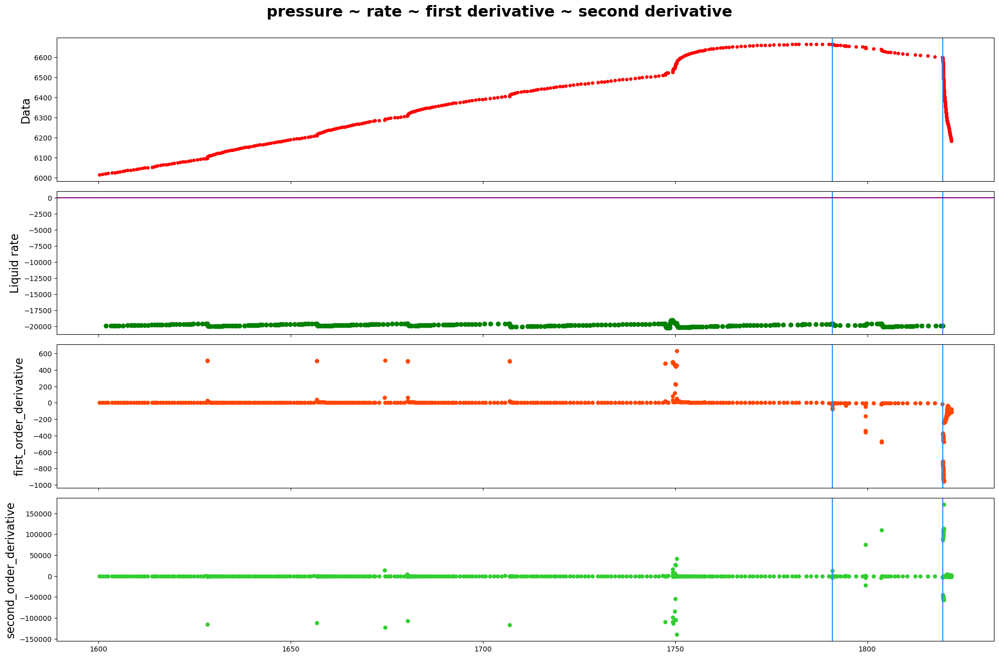

------row 26-----detected points:[]


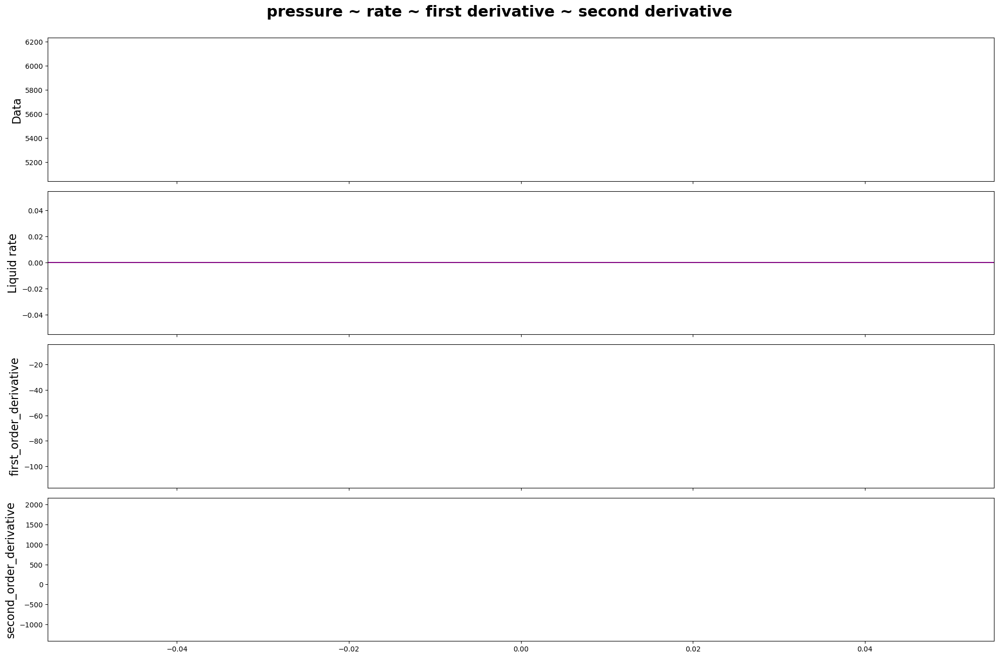

------row 27-----detected points:[13039, 13040, 13053]


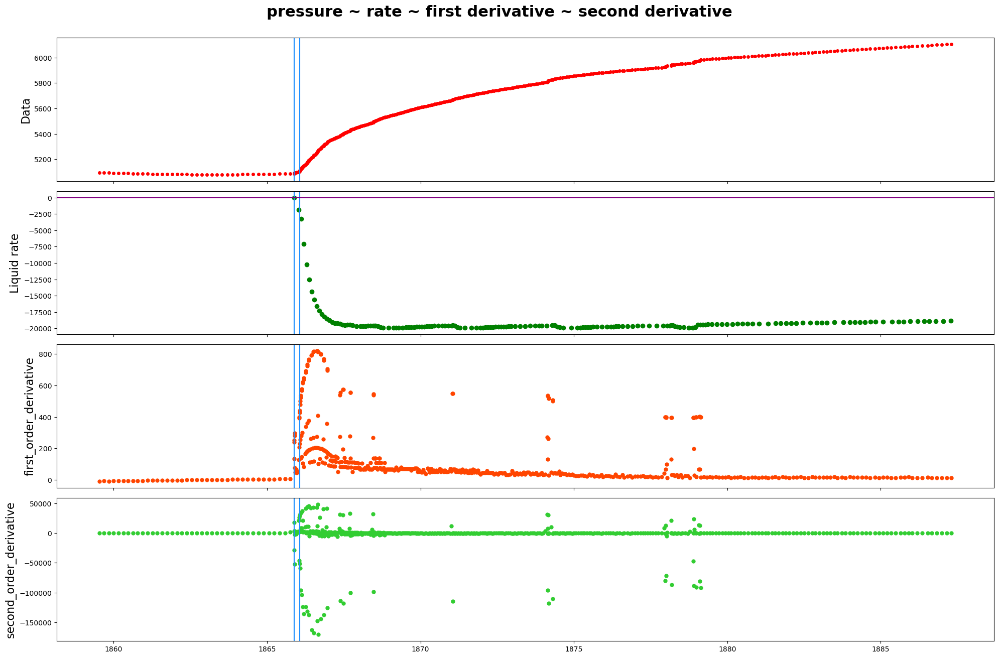

------row 28-----detected points:[13829, 13868]


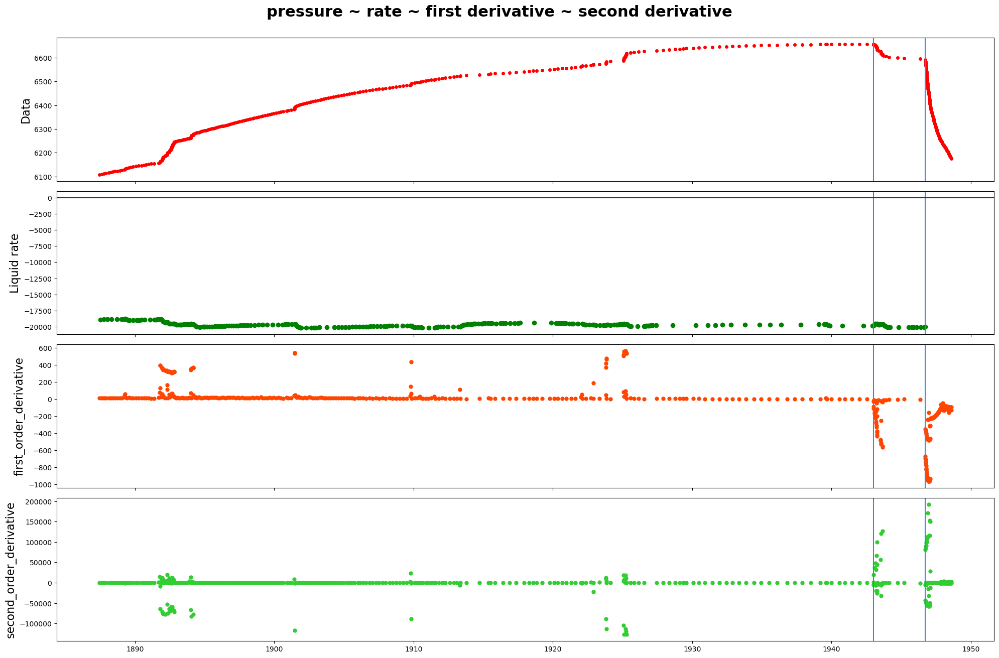

------row 29-----detected points:[14085, 14086, 14191, 14438]


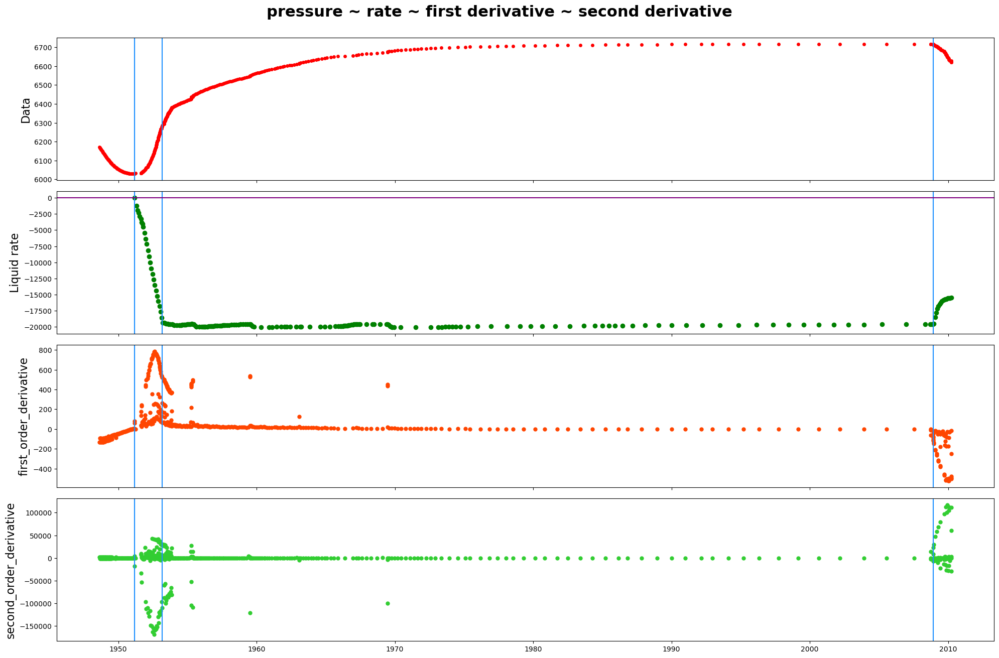

------row 30-----detected points:[14576, 14766]


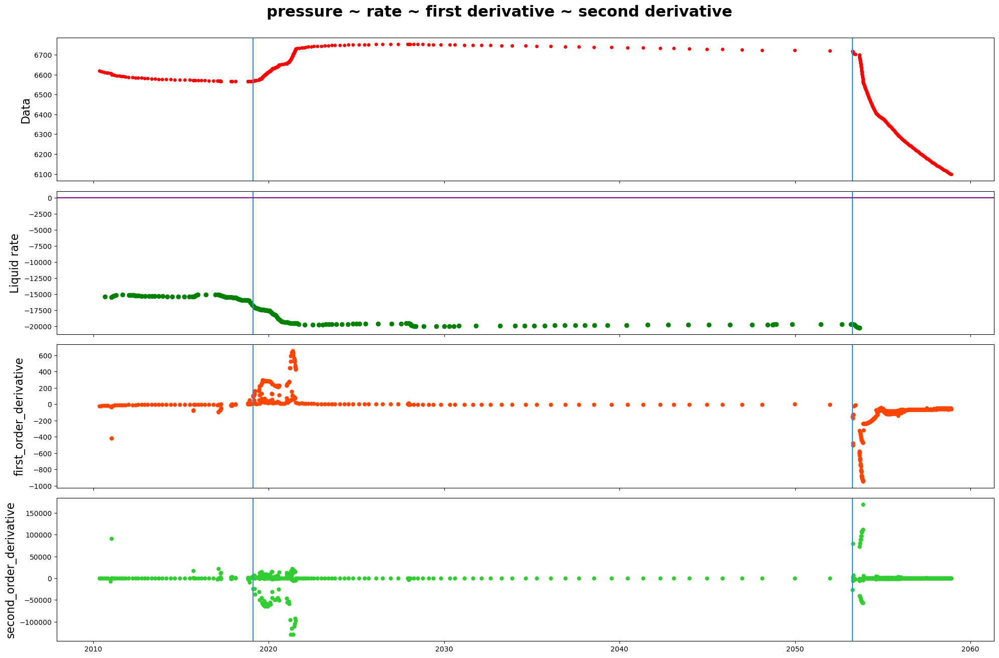

------row 31-----detected points:[15335, 15341, 15348]


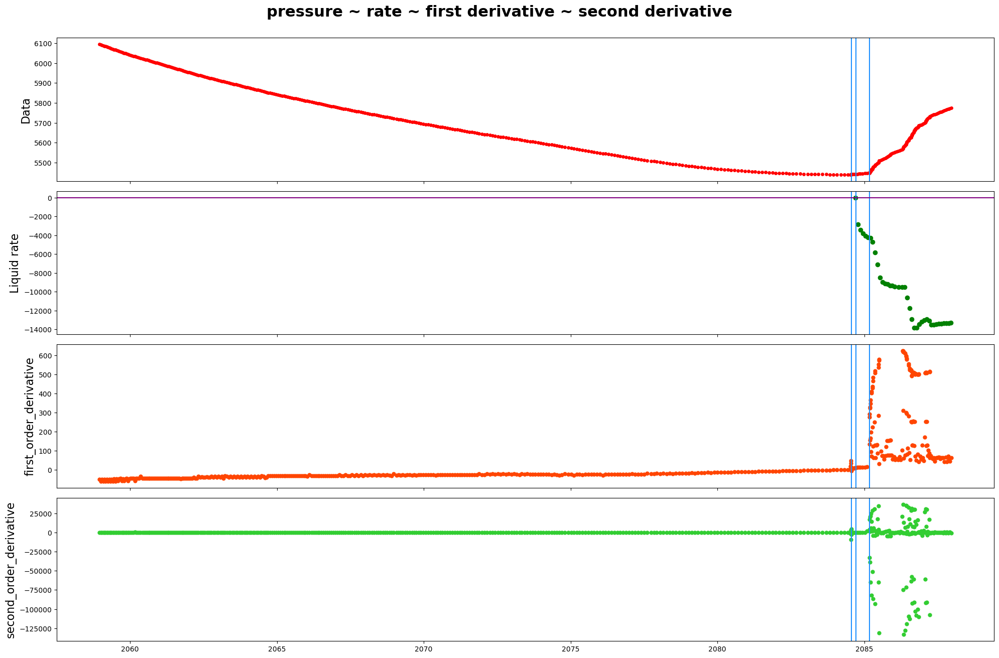

------row 32-----detected points:[]


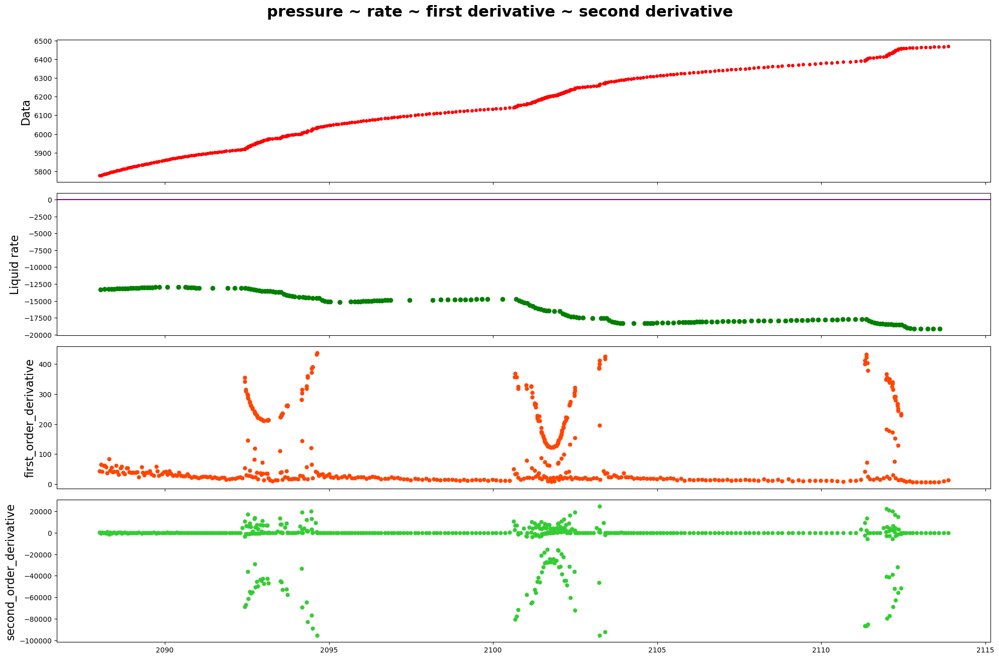

------row 33-----detected points:[16046, 16098]


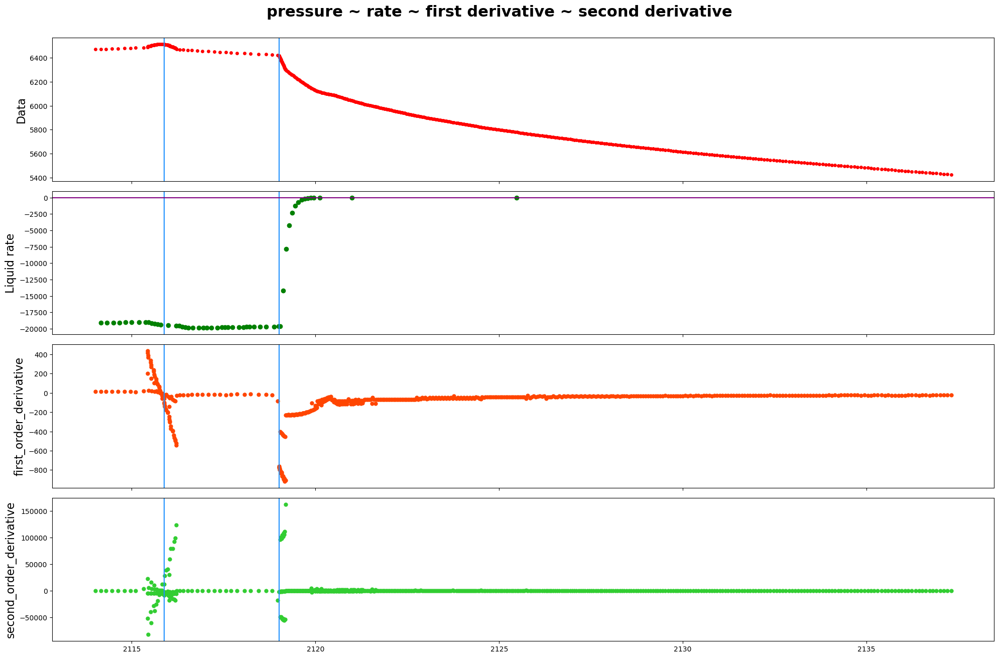

------row 34-----detected points:[16565, 16571, 16572, 16585, 16586, 16594, 16764, 16765]


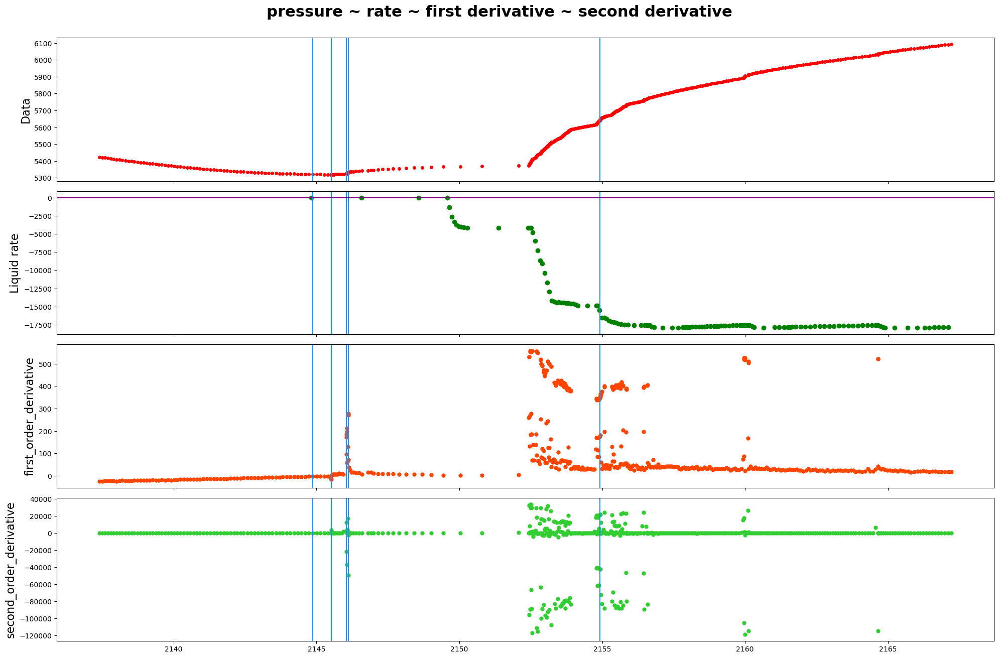

------row 35-----detected points:[17473]


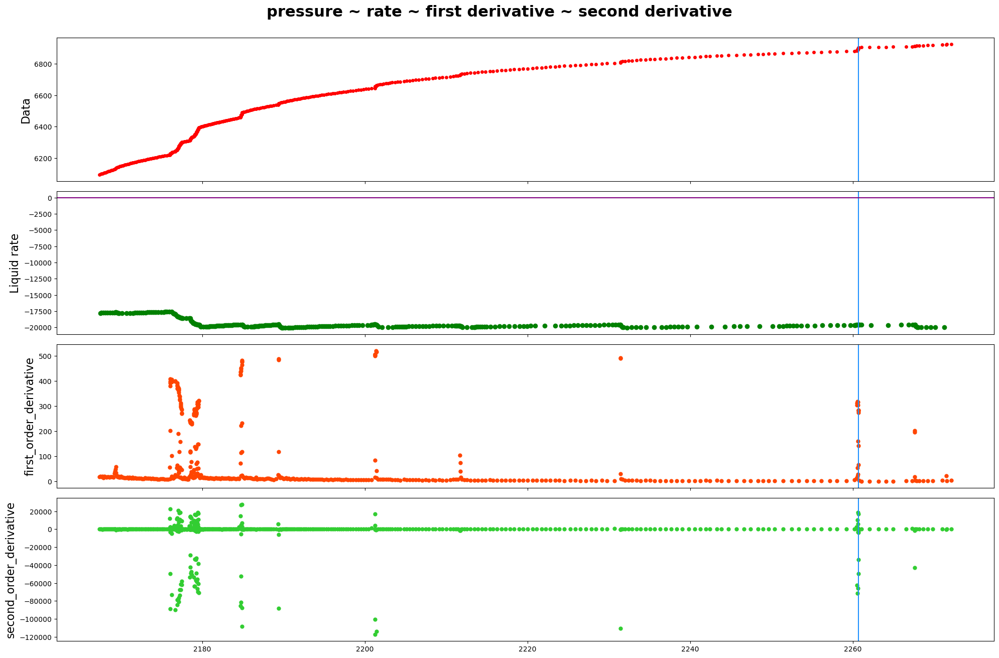

------row 36-----detected points:[17538, 17561, 17589, 17590]


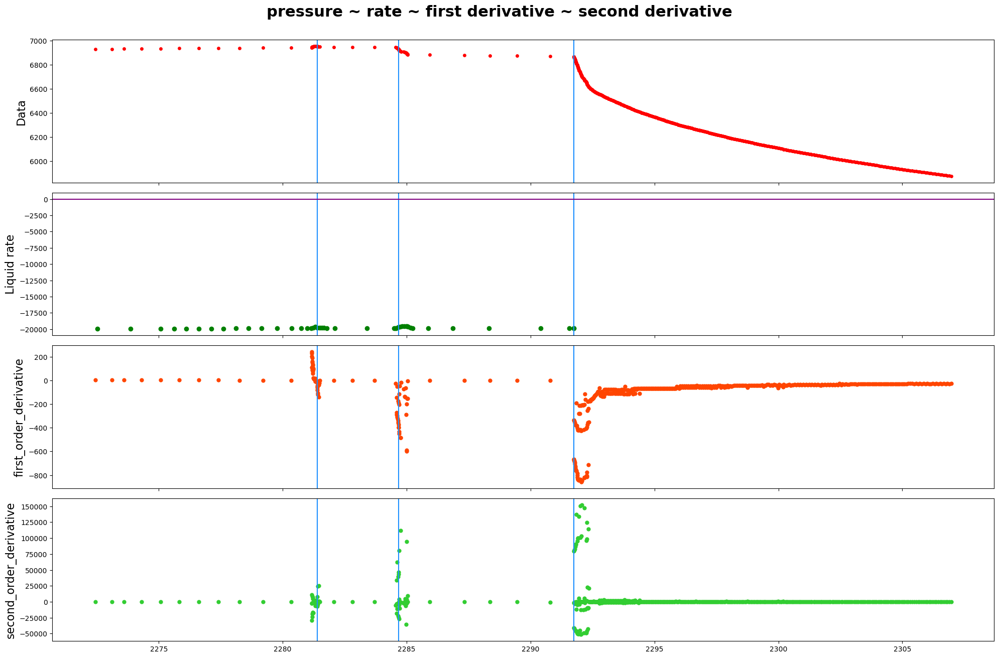

------row 37-----detected points:[18435, 18436, 18437, 18468]


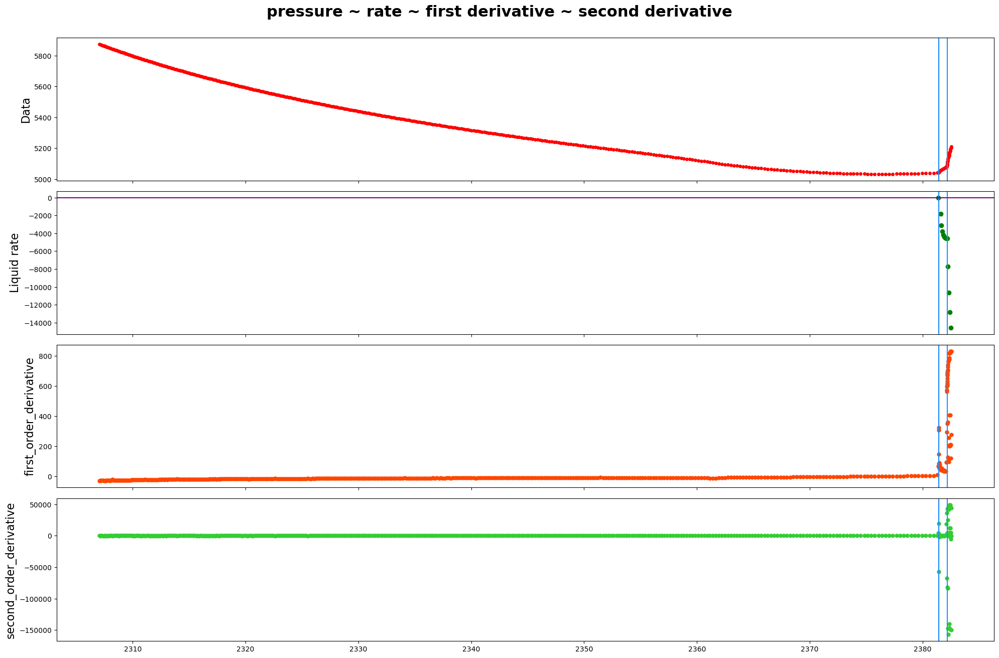

------row 38-----detected points:[18815, 18820, 18821, 18823, 18824, 18826, 18827, 18830, 18836, 18847, 18849]


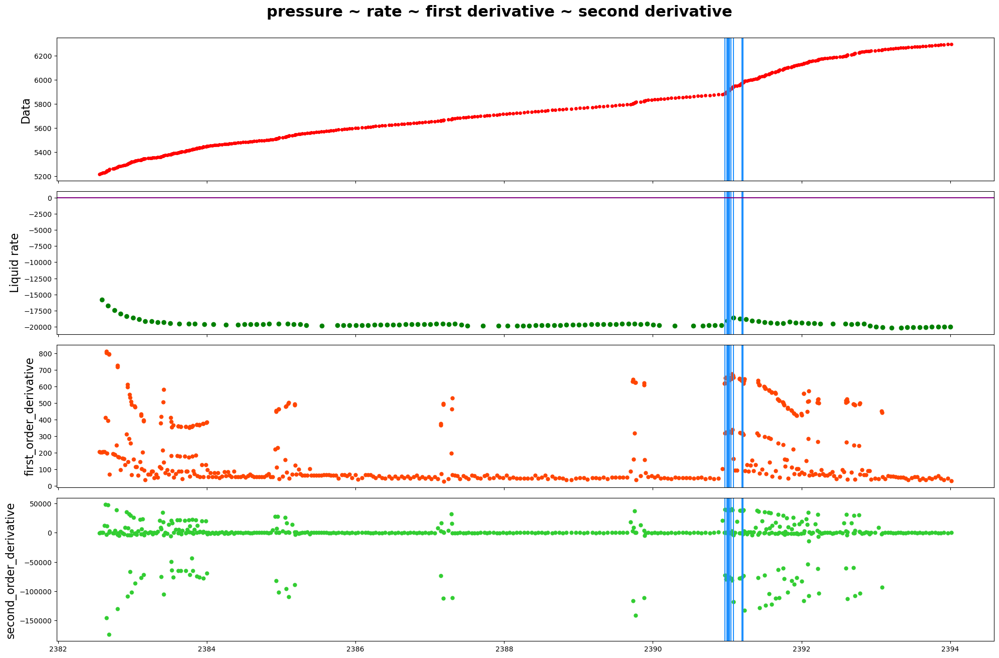

------row 39-----detected points:[]


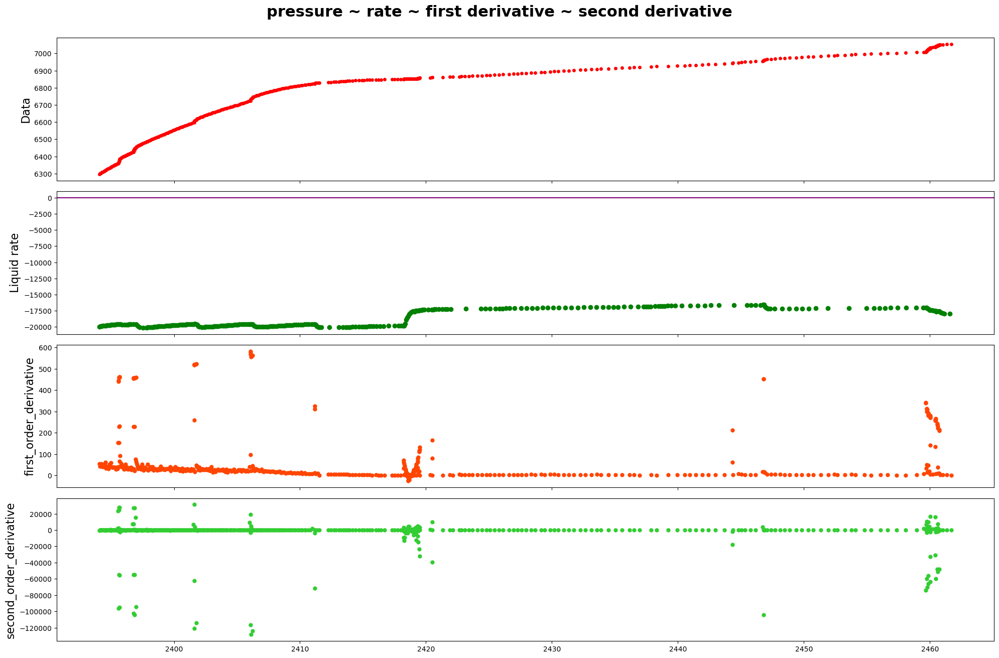

------row 40-----detected points:[19614, 19643, 19780, 19976]


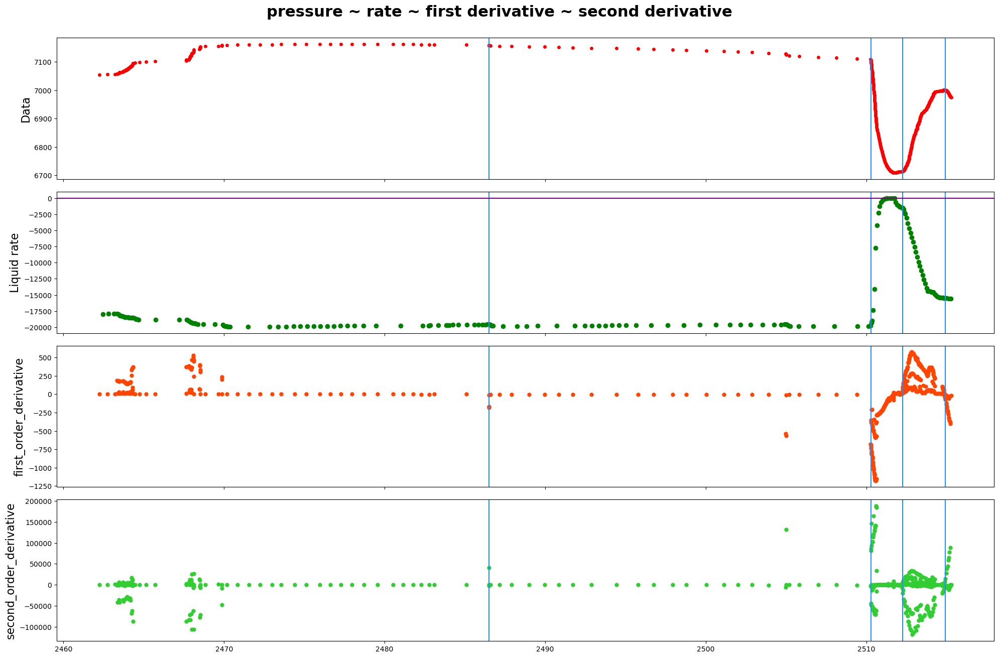

------row 41-----detected points:[20341, 20349, 20362]


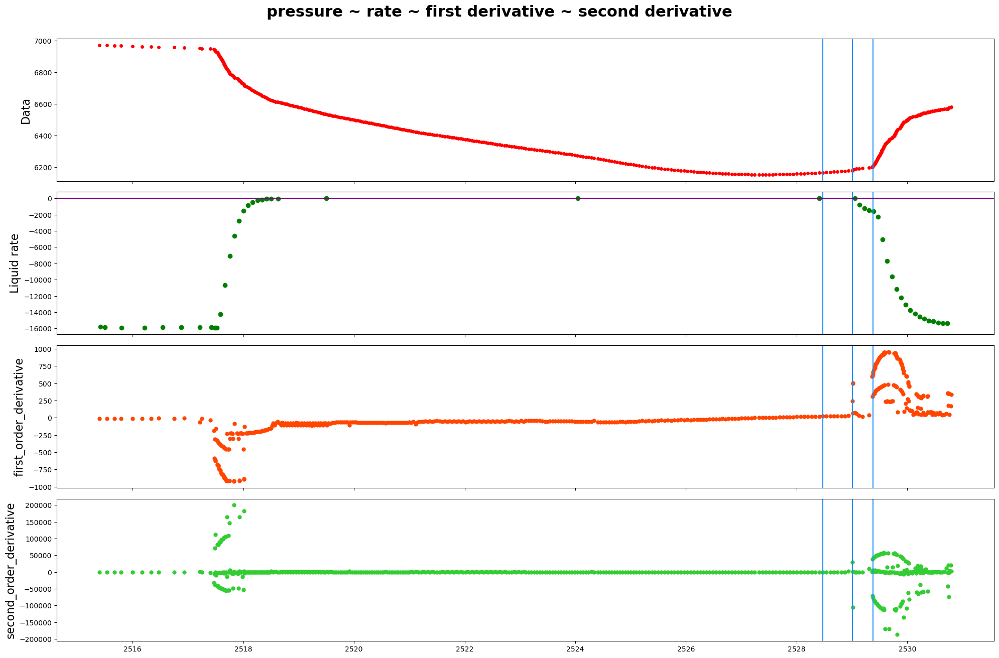

------row 42-----detected points:[20701]


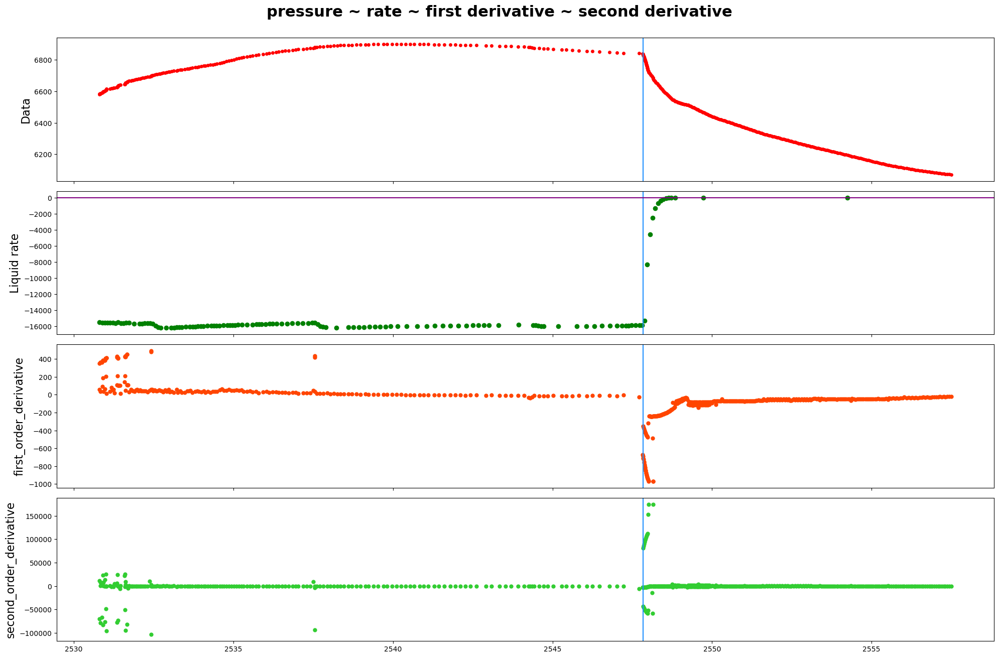

------row 43-----detected points:[21017, 21037]


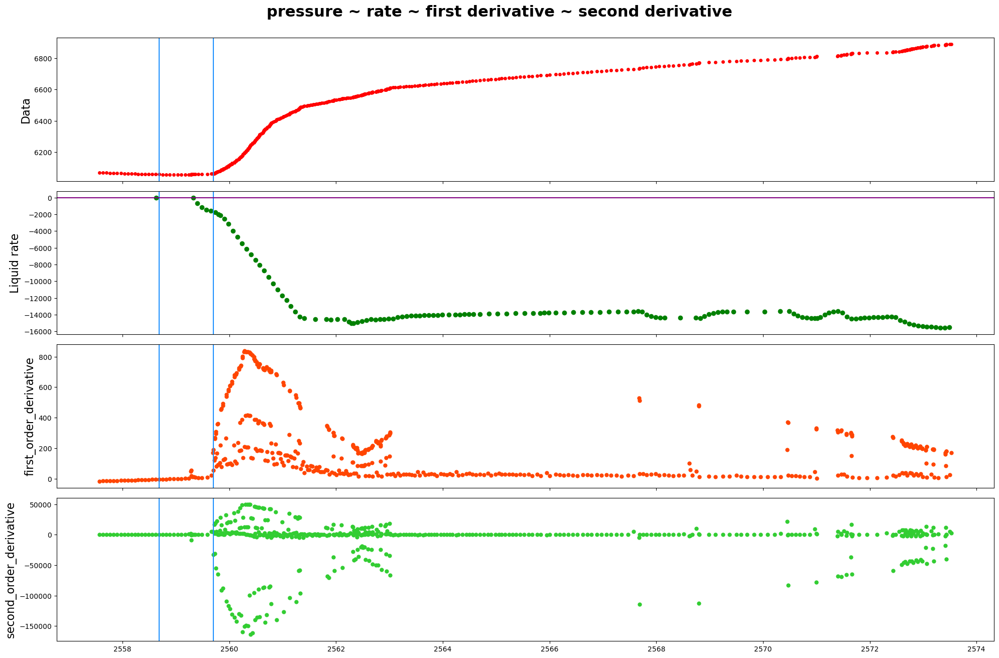

------row 44-----detected points:[21936, 21974]


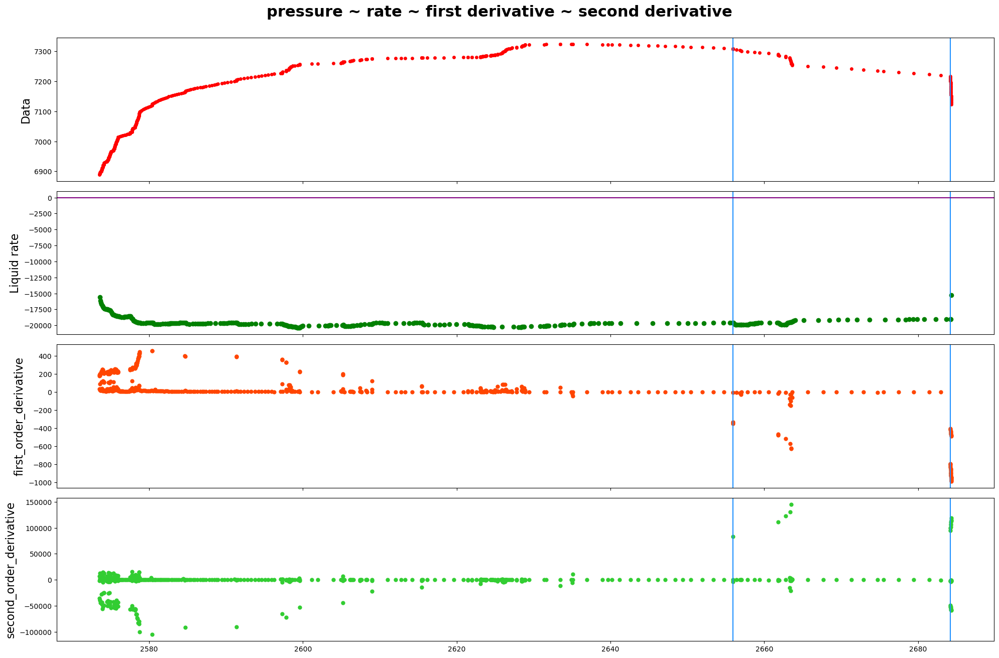

------row 45-----detected points:[22183, 22186]


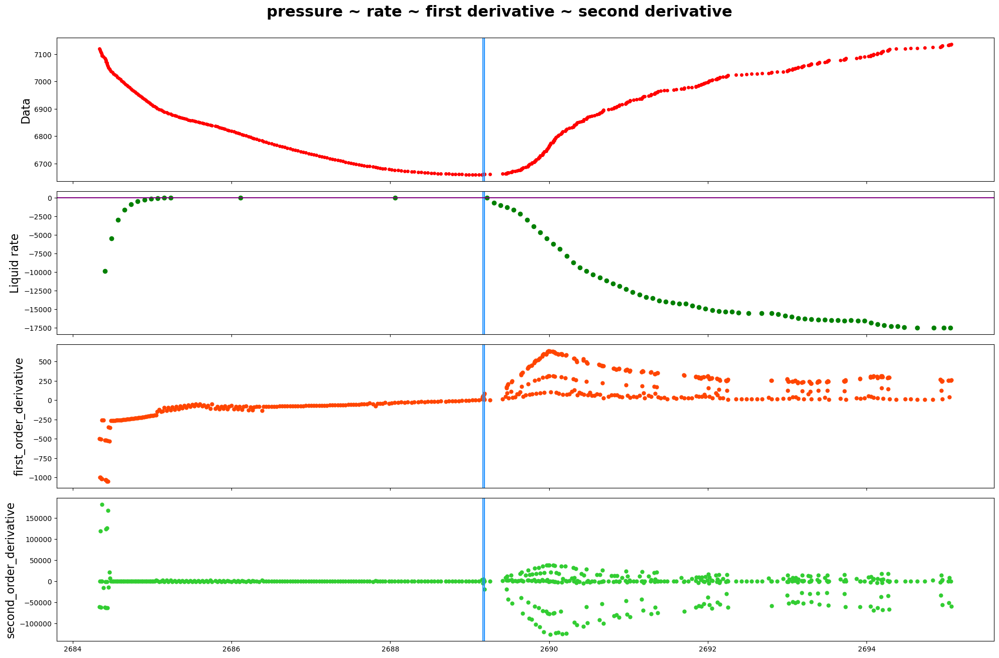

------row 46-----detected points:[22665, 22710]


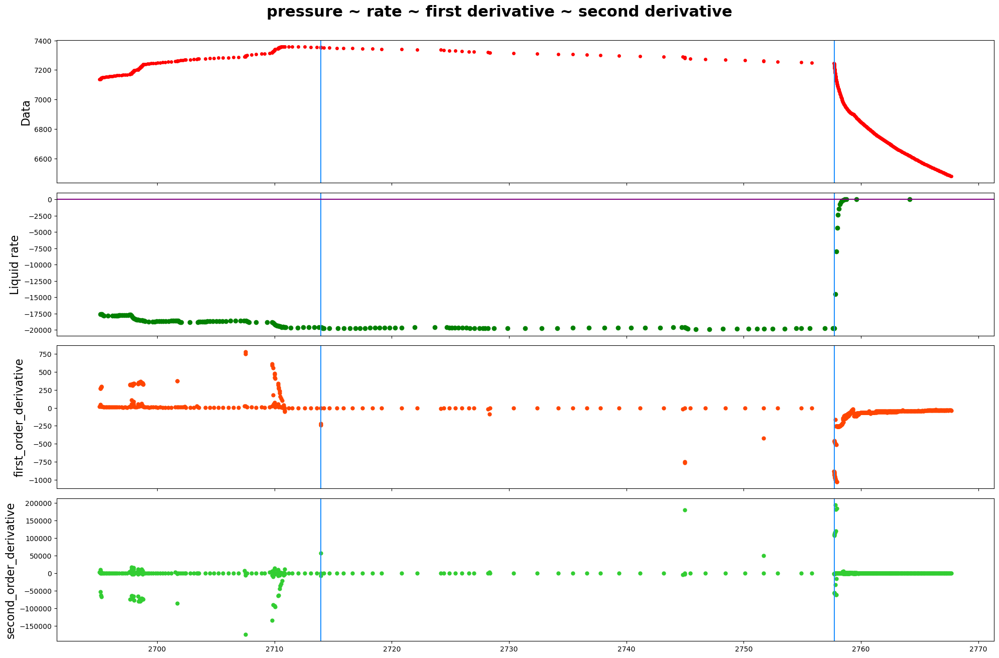

------row 47-----detected points:[23205, 23220]


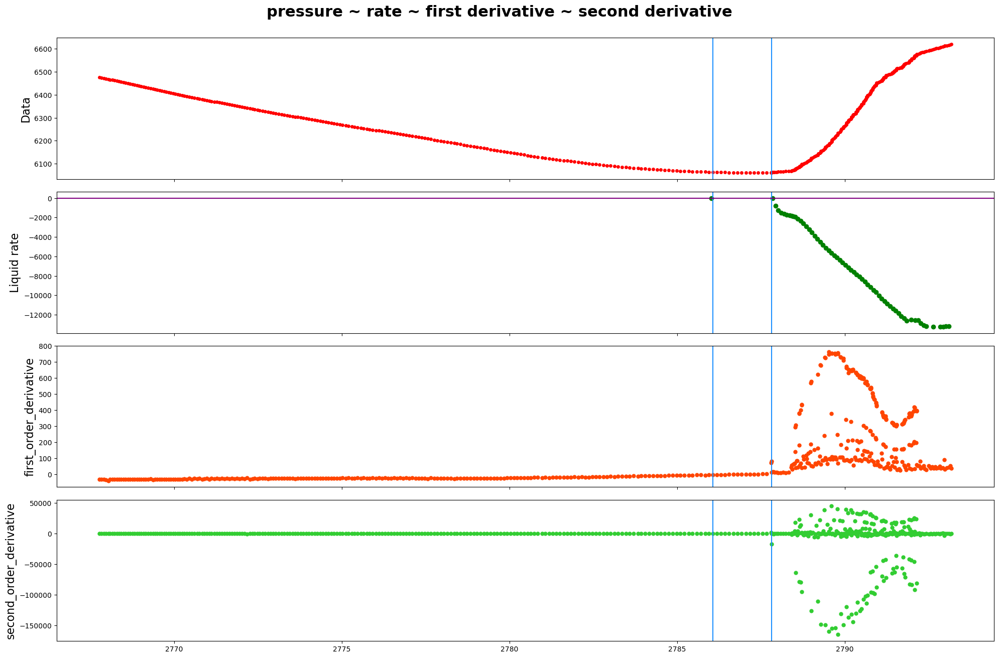

------row 48-----detected points:[]


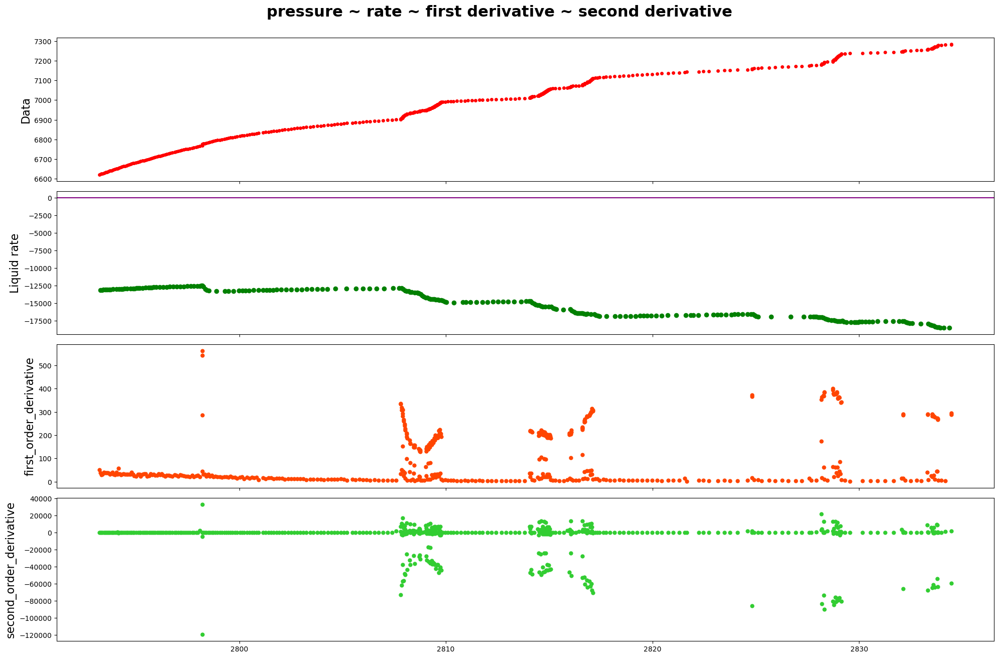

------row 49-----detected points:[24130, 24132, 24173, 24215, 24216, 24263, 24264]


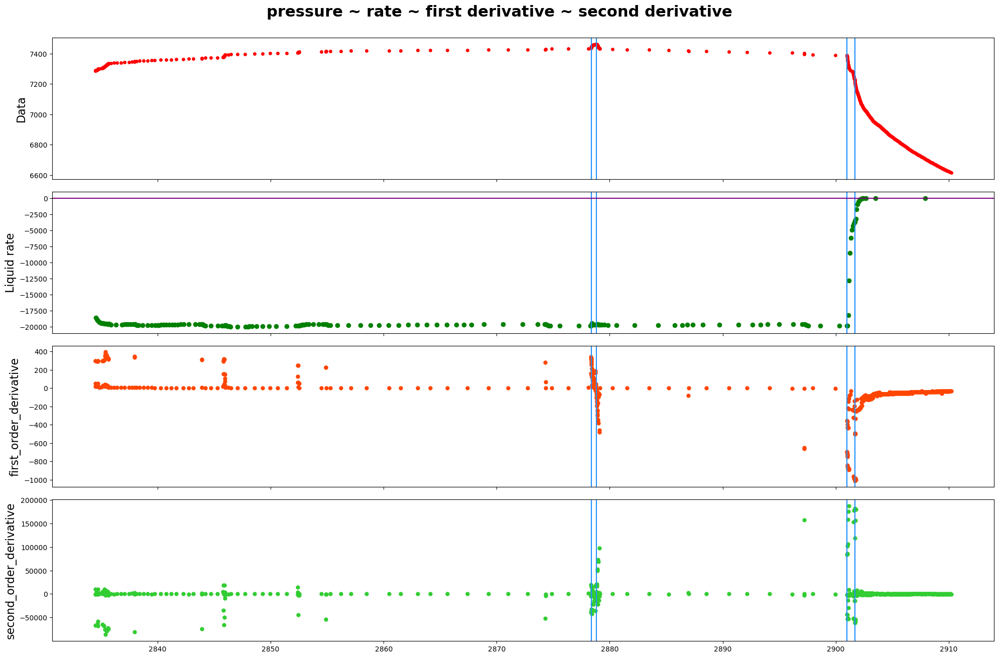

------row 50-----detected points:[24649, 24685, 24793, 24839, 24872, 24876]


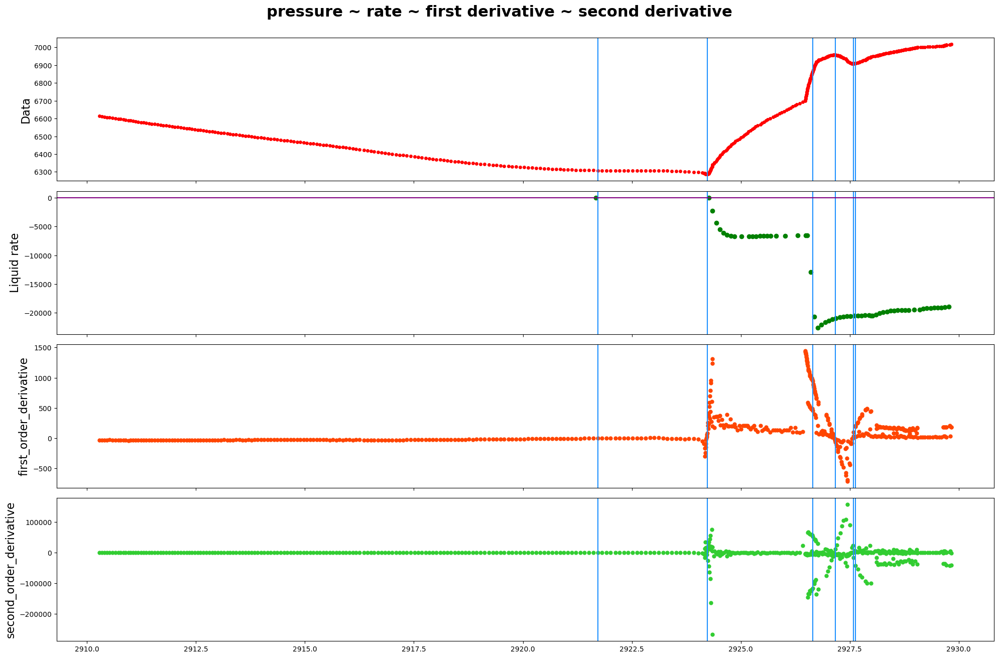

------row 51-----detected points:[]


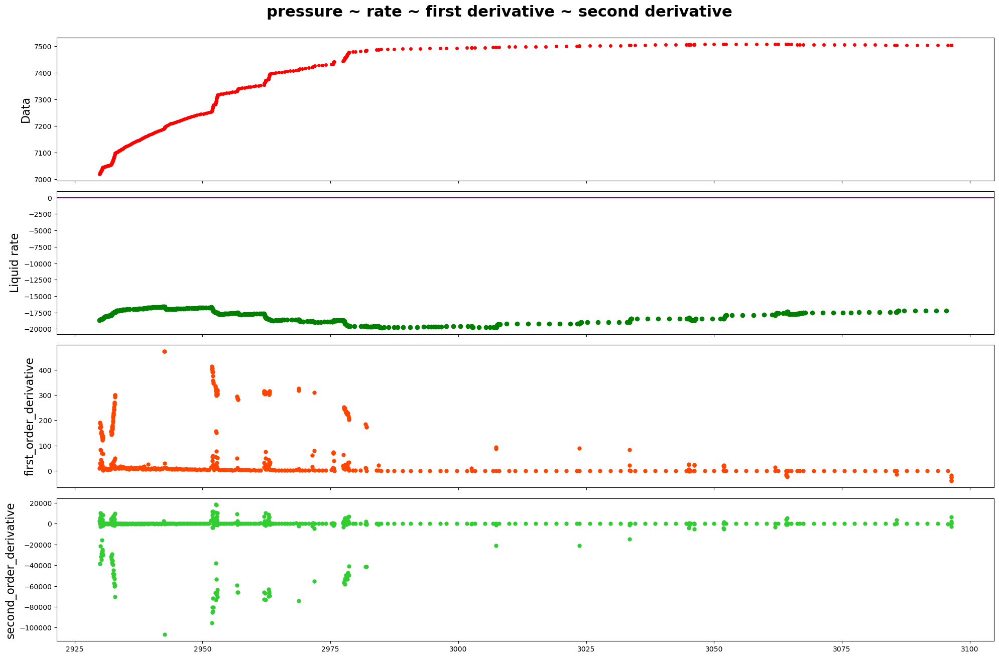

------row 52-----detected points:[25677]


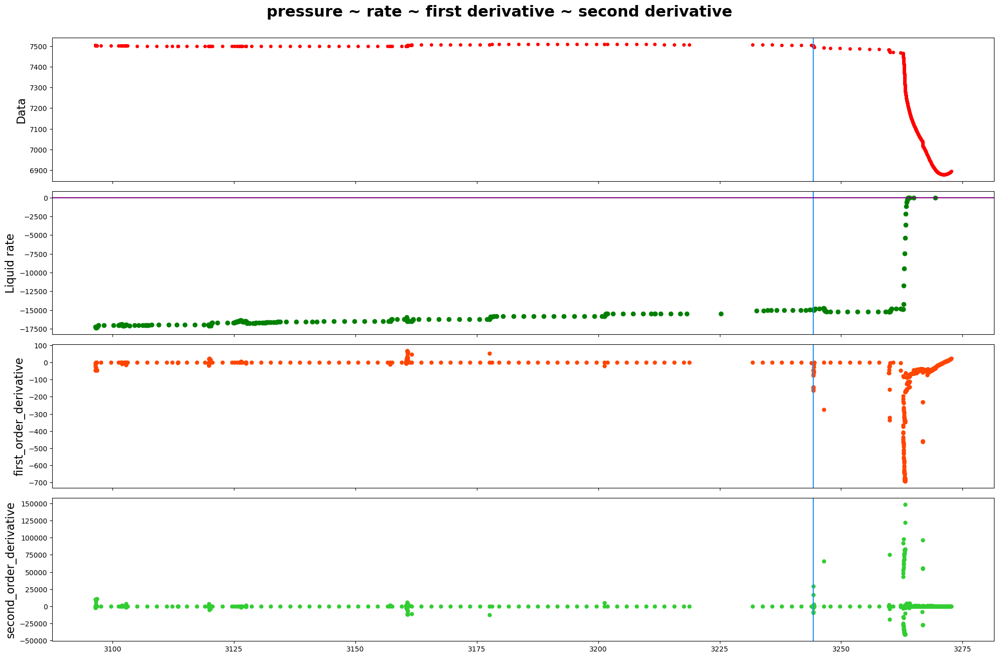

------row 53-----detected points:[26006, 26016, 26348, 26432, 26455]


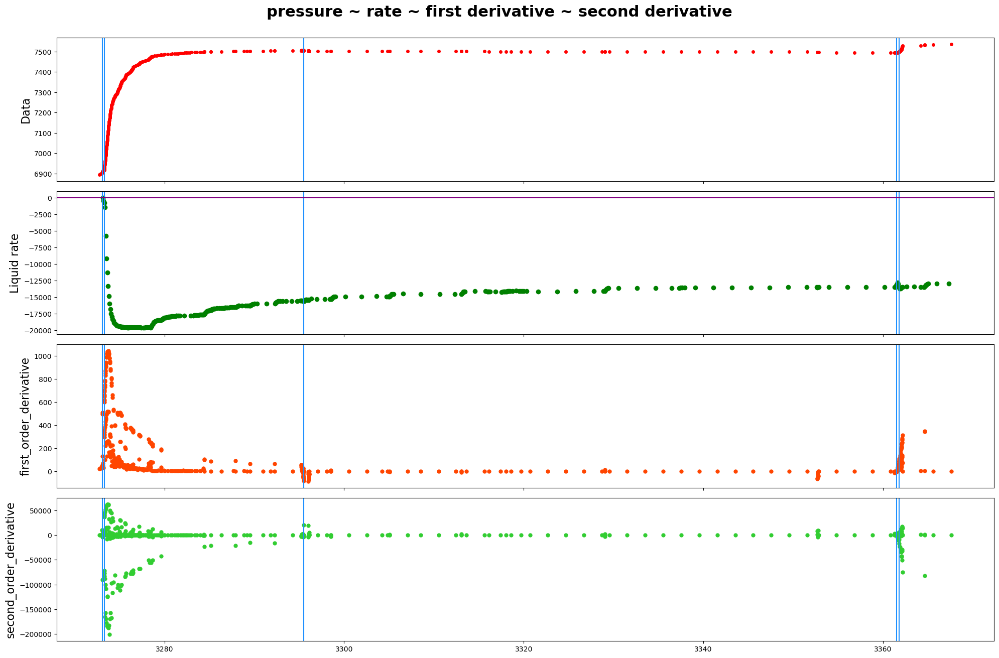

------row 54-----detected points:[26504, 26640, 26656, 26759, 26783, 26984]


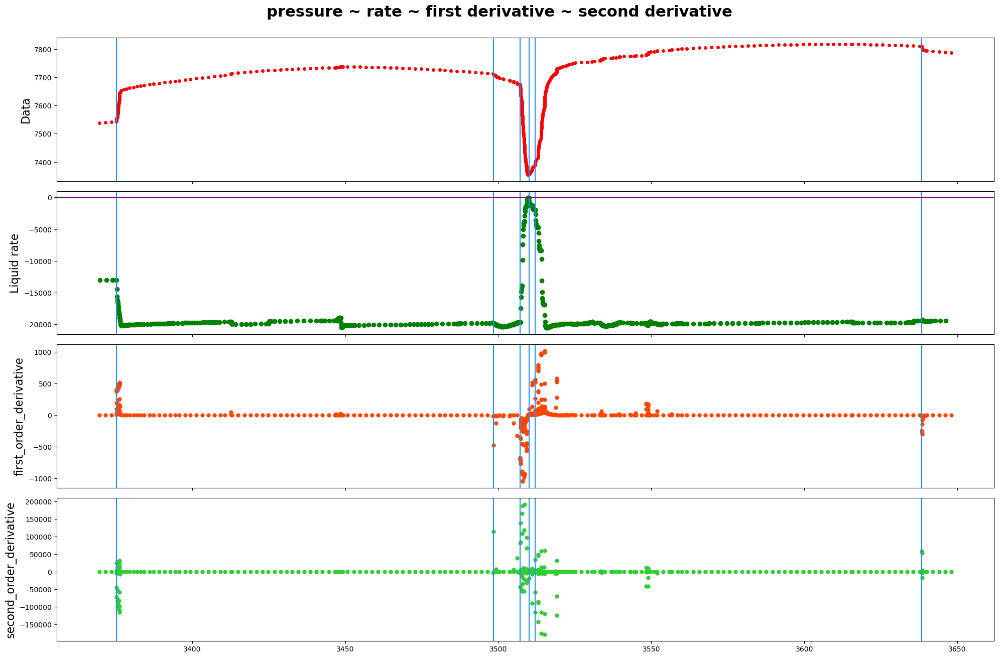

------row 55-----detected points:[27023, 27305, 27316, 27319, 27327]


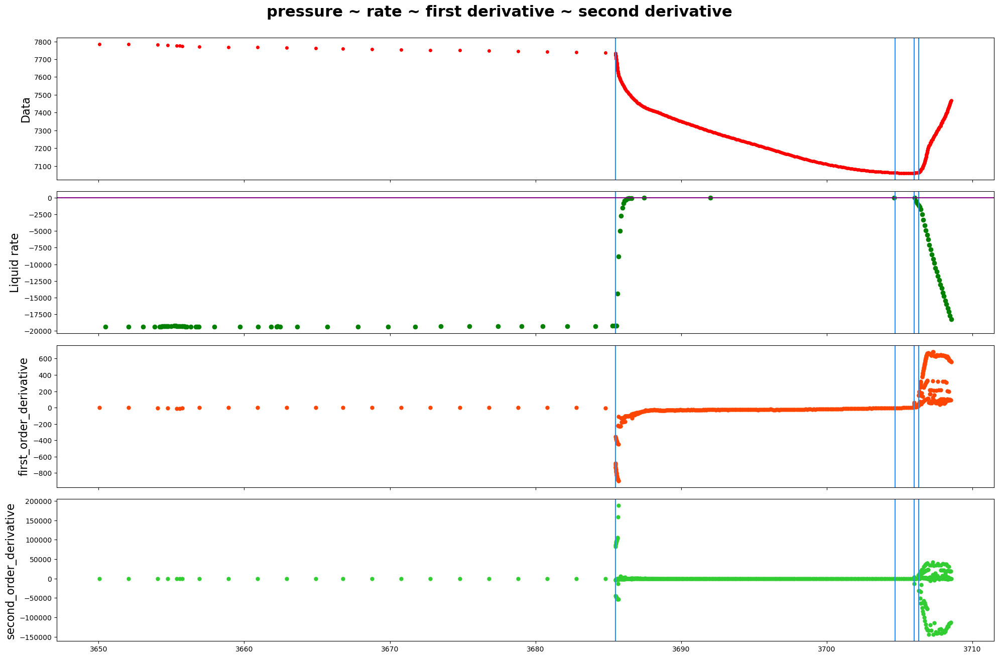

------row 56-----detected points:[27720, 27962, 27963, 27966, 27970]


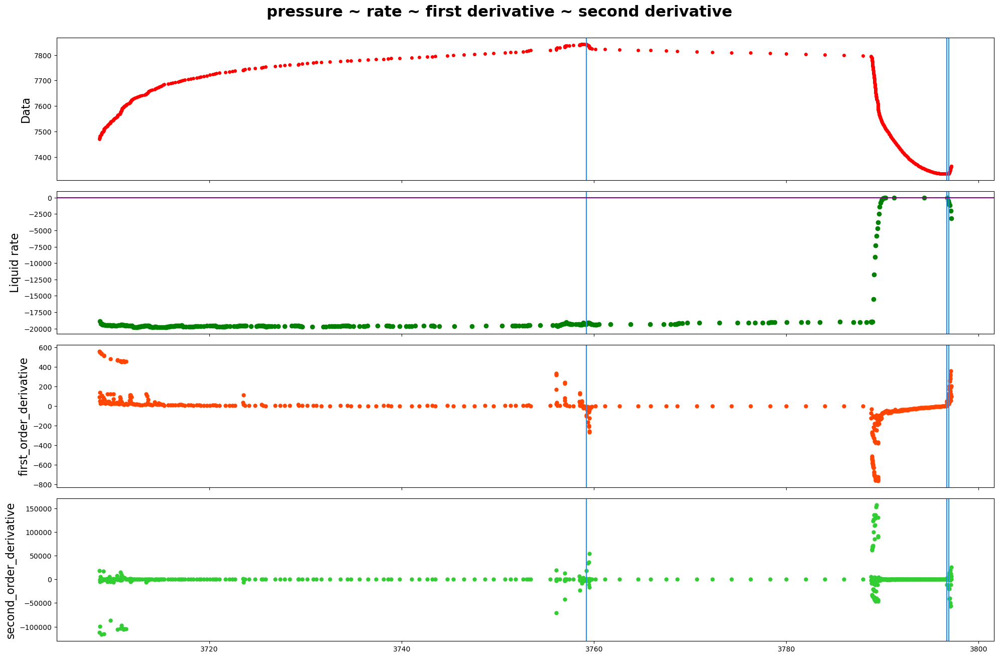

------row 57-----detected points:[28243, 28260, 28263, 28290, 28300, 28310, 28497]


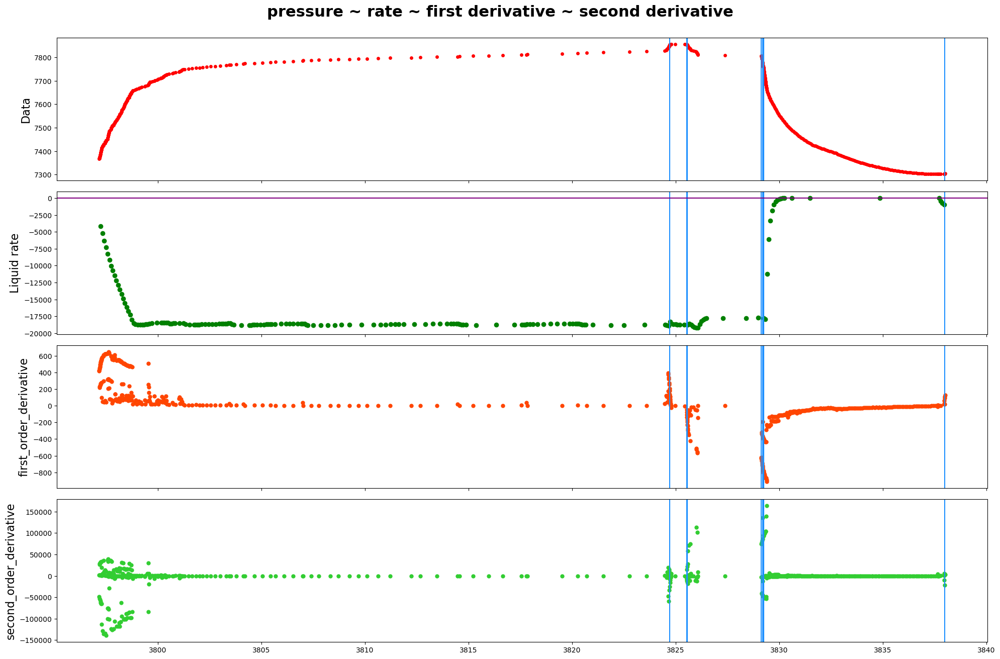

------row 58-----detected points:[28832]


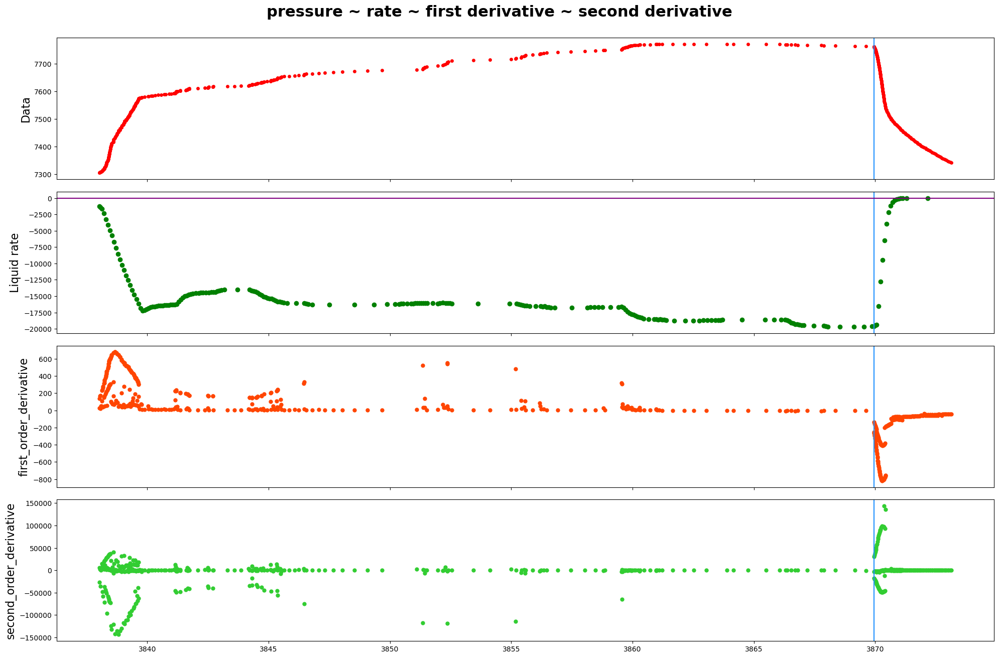

------row 59-----detected points:[29105, 29115, 29122, 29484]


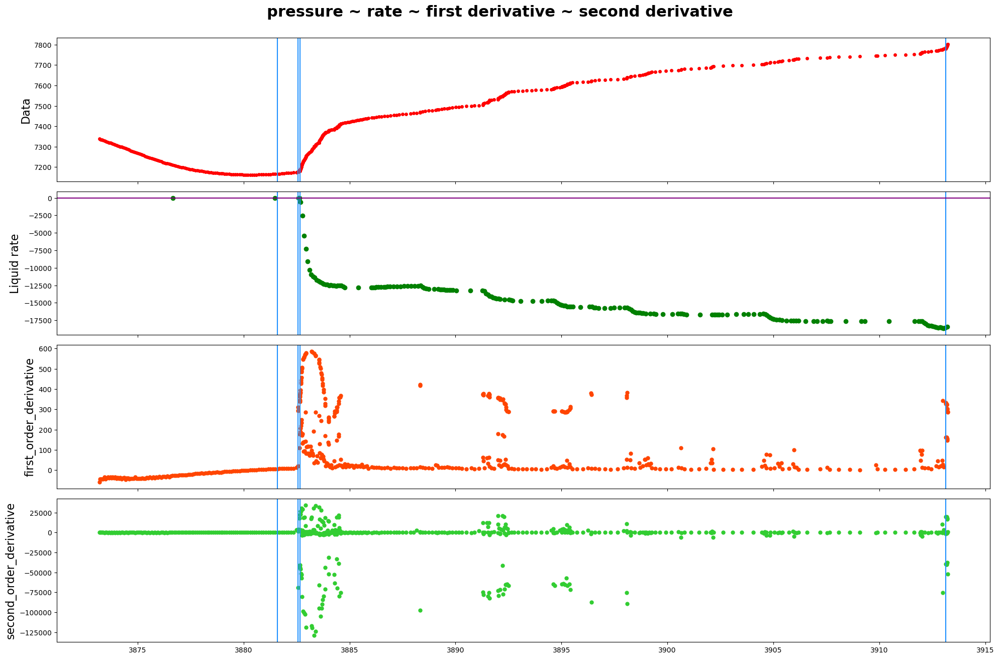

------row 60-----detected points:[29547, 29553]


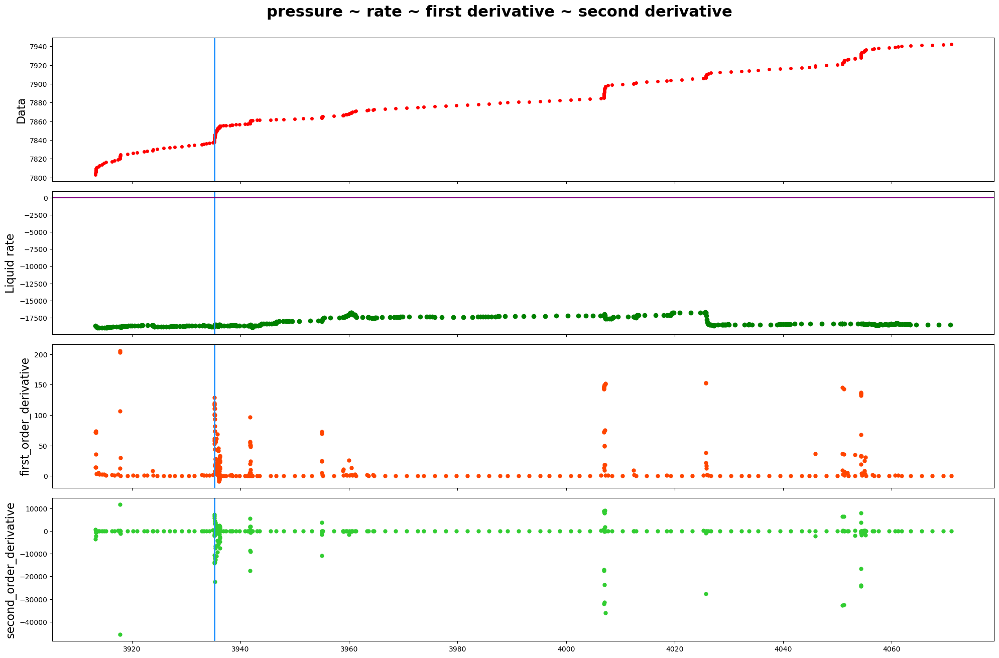

In [64]:
data_inOneRow=500
plot_4_metrics_details(data_inOneRow,
                       pressure_df,
                       rate_df,
                       list(breakpoints_union),
                       ground_truth,
                       colum_names)

In [32]:
a=[10245, 10499, 10021, 10149, 10150]
a.sort()
a

[10021, 10149, 10150, 10245, 10499]